In [1]:
import itertools
import sys, os

import numpy as np
import pandas as pd
from scipy.special import comb
from scipy import stats
import scipy.cluster.hierarchy as hac
import matplotlib.pyplot as plt
plt.style.use('classic')
%matplotlib inline
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
import statsmodels.api as sm

sns.set(rc={'figure.figsize':(15,8)})
sns.set_context('poster')
from sklearn.model_selection import train_test_split

In [2]:
%load_ext autoreload
%autoreload 2
import CCPA_lib as cp


In [3]:
sns.set_context('poster')
sns.set_style('white')

In [4]:

ppallete = 'RdYlGn'#'YlGn_d' #"BuGn_d"
porder = ['MED4',  'MIT9312','MIT0604', 'Natl2A', 'MIT9313']
ppallete = [ '#62A586', '#face6e','#f79934', '#7A9BC8', '#F47681', ]
psizes = [150,120,200,120,350]
pmarkers = ['o', 's', '^', 'D', '*']

# #ffd7a1
    
pedge = 'green'
apallete = "spring"
aorder = ['DE', 'DE1', '1A3', 'ATCC', 'BS11']
amarkers = ['P', 'X', 'h', '<','>']
apallete = ['#6dad36', '#c7e89f', '#f5c4e1', '#d5579d', '#8a0850']

aedge='orange'
epallete = ['#6cf0ba', '#d13f75', '#eeb7cb', '#b9d2d8', '#407f90']
#sns.diverging_palette(355, 217, s=74, l=50, n=4) #'Paired' # 'BrBG'# "coolwarm"
eorder = ['e1','e3', 'e4', 'e5', 'e6']
#aedge='orange'

mpalette = sns.color_palette('Accent', n_colors=5).as_hex()
mpalette = mpalette[0:3] + [mpalette[4]]


In [5]:
plt.rcParams['figure.dpi'] = 300

In [6]:
df = pd.read_pickle('CCPA.pkl.gz')
df.loc[df.PRO == 'C9B', 'PRO'] = 'MIT0604'

In [7]:
dfw = df.loc[(df.experiment.isin(['e1', 'e3', 'e4','e5', 'e6'])) & 
             df['culture'].isin(['Co_Culture', 'Axenic'])]

In [8]:
#dfw = df.loc[(df.experiment.isin(['e1','e3', 'e4','e5', 'e6'])) # & (df.culture == 'Co_Culture')
#            ]

In [9]:
dfdecline = cp.generate_decline(dfw, scale=False)
#dfdecline = dfdecline.loc[dfdecline['day'] <= 80]

In [10]:
dfdecline.head()

,experiment_sample,day,FL,experiment,sample,PRO,ALT,culture
0,"e1, 10A",0.000000,5.621,e1,10A,MIT0604,DE,Co_Culture
1,"e1, 10A",0.893056,4.045,e1,10A,MIT0604,DE,Co_Culture
2,"e1, 10A",1.991667,2.749,e1,10A,MIT0604,DE,Co_Culture
3,"e1, 10A",4.697222,2.924,e1,10A,MIT0604,DE,Co_Culture
4,"e1, 10A",5.700000,2.519,e1,10A,MIT0604,DE,Co_Culture


In [11]:
for n, f in [
    ('exponential', cp.model_exponential1),
    #('hyperbolic', cp.model_hyperbolic),
    ('biexponential' , cp.model_biexponential1),
    ('harmonic', cp.model_harmonic),
    #('linear' , cp.model_linear),
    #('logistic', cp.model_logistic3),
    ('weibull', cp.model_weibull)
]:
    #f = cp.model_exponential
    print(n)
    t = dfdecline.groupby('experiment_sample').apply(lambda x: cp.apply_fit1(x, f, print_popt=False))
    dfdecline[n] = t['y_pred']
    for i in range(4):
        dfdecline[f'{n}_popt_{i}'] = t[f'popt_{i}']
#dfdecline['decline'] = dfdecline.FL
#dfdecline['exponential_diff'] = dfdecline.FL - dfdecline.exponential
#dfdecline['decline_scaled'] = dfdecline.groupby('experiment_sample').FL.transform(lambda x: x / x.max())
#df_exp_coef = dfdecline.groupby(['experiment_sample','popt_0', 'popt_1', 'popt_2'])['decline'].count().reset_index(level=[1,2,3])\
#.drop(columns='decline')

exponential
biexponential
fit with initial: Optimal parameters not found: The maximum number of function evaluations is exceeded.
fit with initial: Optimal parameters not found: The maximum number of function evaluations is exceeded.
fit with initial: Optimal parameters not found: The maximum number of function evaluations is exceeded.


C:\Users\wosnat\Anaconda3\lib\site-packages\pandas\core\groupby\groupby.py:937: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  result = concat(values, axis=self.axis)


harmonic
weibull


C:\Users\wosnat\Anaconda3\lib\site-packages\scipy\optimize\_lsq\least_squares.py:220: RuntimeWarning: overflow encountered in square
  z = (f / f_scale) ** 2
C:\Users\wosnat\Anaconda3\lib\site-packages\pandas\core\series.py:853: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\wosnat\Anaconda3\lib\site-packages\scipy\optimize\_lsq\least_squares.py:220: RuntimeWarning: overflow encountered in square
  z = (f / f_scale) ** 2


In [12]:
dfdecline.columns

Index(['experiment_sample', 'day', 'FL', 'experiment', 'sample', 'PRO', 'ALT',
       'culture', 'exponential', 'exponential_popt_0', 'exponential_popt_1',
       'exponential_popt_2', 'exponential_popt_3', 'biexponential',
       'biexponential_popt_0', 'biexponential_popt_1', 'biexponential_popt_2',
       'biexponential_popt_3', 'harmonic', 'harmonic_popt_0',
       'harmonic_popt_1', 'harmonic_popt_2', 'harmonic_popt_3', 'weibull',
       'weibull_popt_0', 'weibull_popt_1', 'weibull_popt_2', 'weibull_popt_3'],
      dtype='object')

In [13]:
dfdecline.head()

,experiment_sample,day,FL,experiment,sample,PRO,ALT,culture,exponential,exponential_popt_0,...,harmonic,harmonic_popt_0,harmonic_popt_1,harmonic_popt_2,harmonic_popt_3,weibull,weibull_popt_0,weibull_popt_1,weibull_popt_2,weibull_popt_3
0,"e1, 10A",0.000000,5.621,e1,10A,MIT0604,DE,Co_Culture,5.621000,0.141021,...,5.621000,0.296513,0.5,0.5,0.5,5.621000,0.896868,0.5,0.259722,0.5
1,"e1, 10A",0.893056,4.045,e1,10A,MIT0604,DE,Co_Culture,4.955857,0.141021,...,4.444171,0.296513,0.5,0.5,0.5,2.352798,0.896868,0.5,0.259722,0.5
2,"e1, 10A",1.991667,2.749,e1,10A,MIT0604,DE,Co_Culture,4.244581,0.141021,...,3.533985,0.296513,0.5,0.5,0.5,1.923026,0.896868,0.5,0.259722,0.5
3,"e1, 10A",4.697222,2.924,e1,10A,MIT0604,DE,Co_Culture,2.898240,0.141021,...,2.349141,0.296513,0.5,0.5,0.5,1.471309,0.896868,0.5,0.259722,0.5
4,"e1, 10A",5.700000,2.519,e1,10A,MIT0604,DE,Co_Culture,2.516052,0.141021,...,2.089493,0.296513,0.5,0.5,0.5,1.373101,0.896868,0.5,0.259722,0.5


C:\Users\wosnat\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='day', ylabel='Density'>

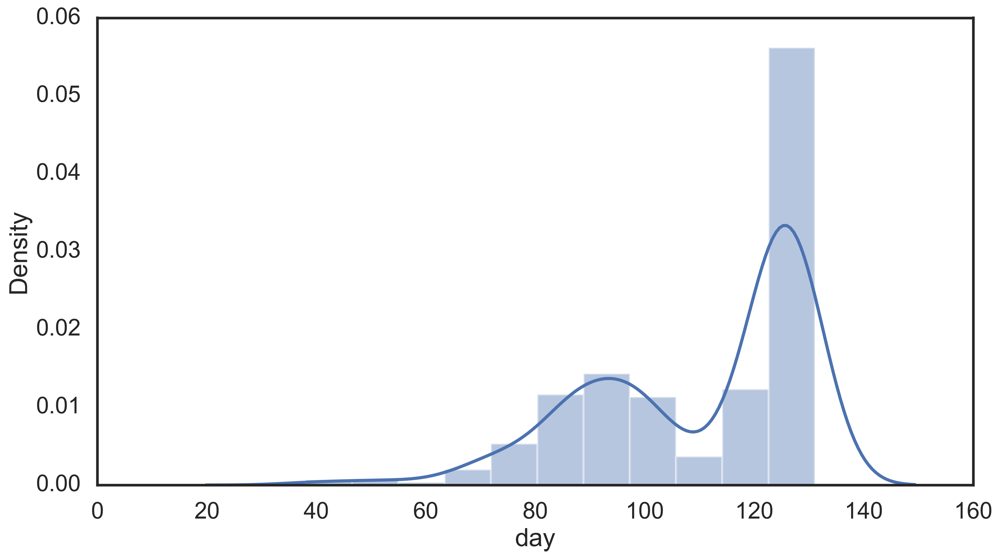

In [14]:
sns.distplot(dfdecline.groupby('experiment_sample')['day'].max()) #.sort_values()

In [15]:
models = [
    'exponential', 
    'biexponential' , 
    'harmonic', 
#    'linear' , 
#    'logistic', 
    'weibull', 
]

num_params_lst = [
    1,
    3,
    1,
#    2,
#    2,
    2,
]
def _compute_score_model(x,m, num_params):
    res = {f'{m}_popt_{i}' : x[f'{m}_popt_{i}'].unique()[0] for i in range(4)}
    if np.isnan(res[f'{m}_popt_0']):
        res.update({
            f'rmse_{m}' : np.NaN,
            #f'rmse_{m}_60' : np.NaN,
            #f'rmse_{m}_5' : np.NaN,
            f'bic_{m}' : np.NaN,
            f'aic_{m}' : np.NaN,
        })
    else:
        #x60 = x.loc[x.day >= 60]
        #x5 = x.loc[x.day <= 5]
        n = x.shape[0]
        
        mse = metrics.mean_squared_error(x['FL'], x[m])
        
        res.update({
            f'rmse_{m}' : np.sqrt(mse),
            #f'rmse_{m}_60' : np.sqrt(metrics.mean_squared_error(x60['FL'], x60[m])) if x60.shape[0]>2 else np.NaN,
            #f'rmse_{m}_5' : np.sqrt(metrics.mean_squared_error(x5['FL'], x5[m])),
            f'bic_{m}' : n * np.log(mse) + num_params * np.log(n),
            f'aic_{m}' : n * np.log(mse) + 2 * num_params,
        })
    return res

def _compute_r2(x):
    res_list = [_compute_score_model(x,m,n) for m,n in zip(models, num_params_lst)]
    res =dict()
    for i in res_list:
        res.update(i)
    return pd.Series(res)
groupcols = ['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture', ]
dfscore = dfdecline.groupby(groupcols).apply(_compute_r2).reset_index()

In [16]:
dfscore.head()

,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,exponential_popt_3,...,rmse_harmonic,bic_harmonic,aic_harmonic,weibull_popt_0,weibull_popt_1,weibull_popt_2,weibull_popt_3,rmse_weibull,bic_weibull,aic_weibull
0,"e1, 10A",e1,10A,MIT0604,DE,Co_Culture,0.141021,1.0,1.0,1.0,...,0.258618,-209.310289,-211.679737,0.896868,0.5,0.259722,0.5,0.322152,-170.232915,-174.971810
1,"e1, 10B",e1,10B,MIT0604,DE,Co_Culture,0.142509,0.5,0.5,0.5,...,0.292172,-190.035504,-192.404952,0.838354,1.0,0.264545,1.0,0.327495,-167.633931,-172.372827
2,"e1, 10C",e1,10C,MIT0604,DE,Co_Culture,0.164214,0.5,0.5,0.5,...,0.242214,-219.663752,-222.033199,1.007286,0.5,0.235531,0.5,0.357230,-153.902249,-158.641145
3,"e1, 11A",e1,11A,MED4,DE1,Co_Culture,0.101841,1.0,1.0,1.0,...,0.290267,-193.530640,-195.912667,0.342589,0.5,0.549802,0.5,0.333052,-167.149036,-171.913089
4,"e1, 11B",e1,11B,MED4,DE1,Co_Culture,0.125338,1.0,1.0,1.0,...,0.174111,-271.824341,-274.193789,0.503584,0.5,0.458725,0.5,0.254336,-207.578921,-212.317817


In [17]:
flipmask = dfscore['biexponential_popt_0'] > dfscore['biexponential_popt_2']
dfscore['f'] = dfscore['biexponential_popt_3']
dfscore['a1'] = dfscore['biexponential_popt_0']
dfscore['a2'] = dfscore['biexponential_popt_2']
dfscore.loc[flipmask, 'f'] = 1 - dfscore.loc[flipmask, 'f']
dfscore.loc[flipmask, 'a1'] = dfscore.loc[flipmask, 'biexponential_popt_2']
dfscore.loc[flipmask, 'a2'] = dfscore.loc[flipmask, 'biexponential_popt_0']

In [183]:
def compute_weibull_td(d, a, n):
    return np.power(-np.log(1/np.power(10,d))/a, 1/n)

dfscore['weibull_n'] = dfscore['weibull_popt_2']
dfscore['weibull_a'] = dfscore['weibull_popt_0']
dfscore['weibull_td'] = dfscore.apply(
    lambda x: compute_weibull_td(d=1, a=x['weibull_a'], n=x['weibull_n']), axis=1)
dfscore['weibull_td6'] = dfscore.apply(
    lambda x: compute_weibull_td(d=6, a=x['weibull_a'], n=x['weibull_n']), axis=1)
dfscore['weibull_td2'] = dfscore.apply(
    lambda x: compute_weibull_td(d=2, a=x['weibull_a'], n=x['weibull_n']), axis=1)



In [184]:
dfscore.nlargest(10, 'weibull_td')

,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,exponential_popt_3,...,aic_weibull,f,a1,a2,weibull_n,weibull_a,weibull_td6,p,weibull_td,weibull_td2
85,"e1, 9C",e1,9C,Natl2A,DE,Co_Culture,0.234706,0.5,0.5,0.5,...,-105.224985,0.304926,0.004627,5.003978,0.075386,1.073296,5.242829e+14,Natl2A,24964.529066,2.457603e+08
84,"e1, 9B",e1,9B,Natl2A,DE,Co_Culture,0.223390,0.5,0.5,0.5,...,-92.430177,0.325478,0.005905,5.134983,0.100899,1.001450,1.976400e+11,Natl2A,3834.077963,3.691072e+06
14,"e1, 14C",e1,14C,Natl2A,DE1,Co_Culture,0.055246,0.5,0.5,0.5,...,-142.240601,NaN,NaN,NaN,0.150188,0.789420,1.891022e+08,Natl2A,1245.973194,1.258536e+05
83,"e1, 9A",e1,9A,Natl2A,DE,Co_Culture,0.189229,0.5,0.5,0.5,...,-85.745474,0.385879,0.007421,4.916978,0.177822,0.686907,2.138913e+07,Natl2A,899.866449,4.436616e+04
45,"e1, 24A",e1,24A,Natl2A,ATCC,Co_Culture,0.022873,1.0,1.0,1.0,...,-145.354801,0.509884,0.009296,3.226652,0.253673,0.428035,8.874954e+05,Natl2A,759.671511,1.167649e+04
13,"e1, 14B",e1,14B,Natl2A,DE1,Co_Culture,0.027536,1.0,1.0,1.0,...,-159.924926,0.360007,0.007227,5.253987,0.181048,0.707828,1.341509e+07,Natl2A,675.403076,3.106478e+04
47,"e1, 24C",e1,24C,Natl2A,ATCC,Co_Culture,0.026412,1.0,1.0,1.0,...,-194.043897,0.443091,0.010372,3.450777,0.242417,0.536714,6.591710e+05,Natl2A,406.469643,7.092739e+03
27,"e1, 19A",e1,19A,Natl2A,BS11,Co_Culture,0.020703,1.0,1.0,1.0,...,-113.967285,0.502463,0.009805,4.805722,0.291966,0.407898,1.736604e+05,Natl2A,375.397169,4.032134e+03
131,"e3, 25C",e3,25C,MIT0604,ATCC,Co_Culture,0.077745,1.0,1.0,1.0,...,-396.657248,0.268049,0.005845,1.092603,0.166035,0.881868,1.574244e+07,MIT0604,323.885409,2.105944e+04
12,"e1, 14A",e1,14A,Natl2A,DE1,Co_Culture,0.030155,0.5,0.5,0.5,...,-191.296723,0.369351,0.009089,4.276387,0.230076,0.615633,7.450049e+05,Natl2A,309.040865,6.286480e+03


In [19]:
dfscore.to_pickle('exponential_decline.pkl.gz')

In [20]:
values = [f'rmse_{m}' for m in models]
#values += [f'bic_{m}' for m in models]
values += [f'aic_{m}' for m in models]
values +=  ['f', 'a1', 'a2',]
values +=  ['weibull_td6', 'weibull_a', 'weibull_n']

dfscorem = dfscore.melt(id_vars=['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture'],
                        value_vars=values +  ['f', 'a1', 'a2',
                                   ], 
                        value_name='RMSE',
                        var_name='model')


In [21]:
dfscorem['s'] = dfscorem['sample'] +', '+ dfscorem.ALT
dfscorem['e'] = dfscorem['experiment'] +', '+ dfscorem.culture
dfscorem['p'] = dfscorem['PRO'] 
dfscorem.loc[dfscorem.culture == 'Axenic', 'p'] =dfscorem.loc[dfscorem.culture == 'Axenic', 'p']+ ' Axenic'



In [22]:
Models = [m.capitalize() for m in models ]

Text(0.5, 1, 'Root Mean Square Error per Model')

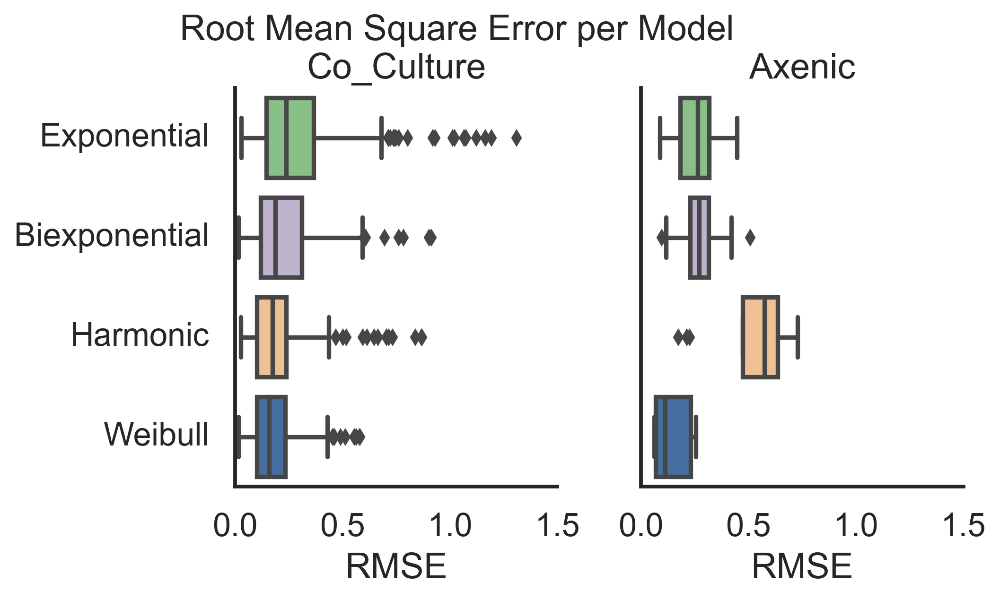

In [23]:
cols = [f'rmse_{m}' for m in models]
sns.set_context('talk')
g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols)], 
                y='model', x='RMSE', #hue='PRO', kind='swarm', #aspect=2,
                kind='box',
                palette=mpalette,
           #palette='cubehelix'
            col='culture',
                height=4,
).set_axis_labels('RMSE', '').set(yticklabels=Models, 
    xticks=[0,0.5,1,1.5]
                                     ).set_titles('{col_name}')# .set(font_scale=2)

plt.suptitle('Root Mean Square Error per Model', y=1)


Text(0.5, 1, 'AIC per Model')

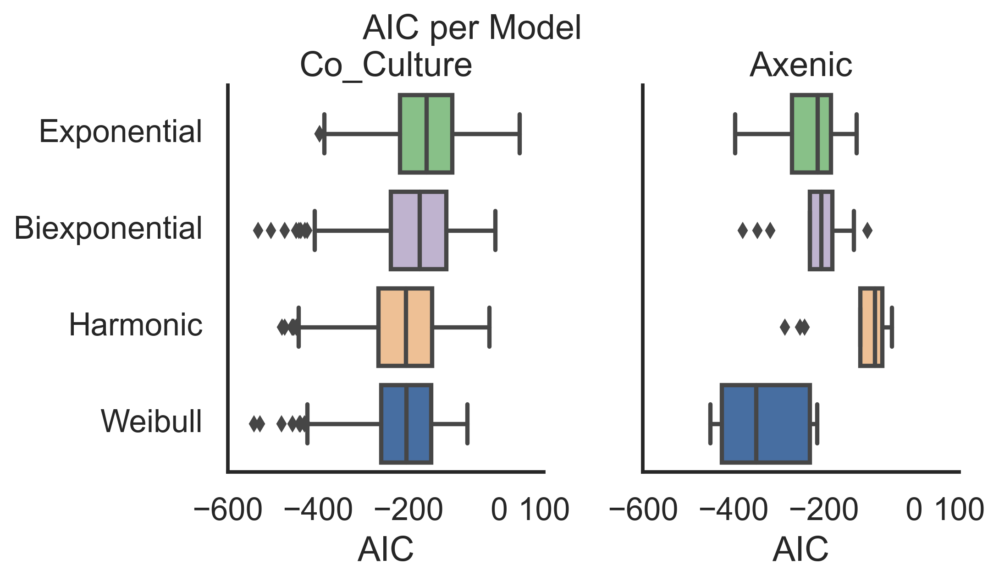

In [24]:
cols = [f'aic_{m}' for m in models]
sns.set_context('talk')
g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols)], 
                y='model', x='RMSE', #hue='PRO', kind='swarm', #aspect=2,
                kind='box',
                palette=mpalette,
                height=4,
            col='culture',
).set_axis_labels('AIC','').set(xticks=[-600, -400, -200, 0, 100], yticklabels=Models, 
                                     ).set_titles('{col_name}')# .set(font_scale=2)

#g.set_xticklabels(rotation=30)
#plt.xticks(rotation=45)
plt.suptitle('AIC per Model', y=1)

Text(0.5, 1, 'Root Mean Square Error per PRO (co-cultures)')

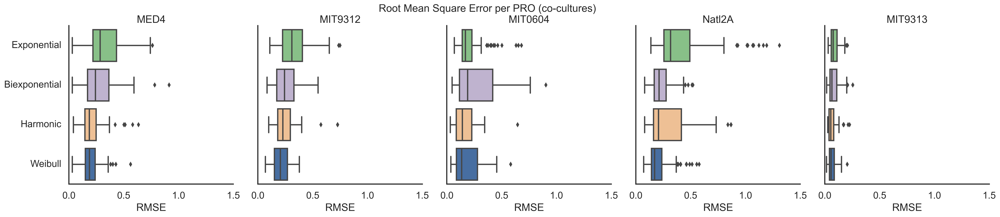

In [25]:
cols = [f'rmse_{m}' for m in models]
sns.set_context('talk')
g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols) & dfscorem.culture.isin(['Axenic', 'Co_Culture'])]
                , y='model', x='RMSE', 
                col='PRO', col_order=porder,# palette=ppallete,
                kind='box', #aspect=2,
                #height=3, aspect=1,
                palette=mpalette,
).set_axis_labels('RMSE','').set(xticks=[0,0.5,1,1.5], yticklabels=Models, 
                                     ).set_titles('{col_name}')# .set(font_scale=2)
#g.set_xticklabels(rotation=30)
#plt.xticks(rotation=45)
plt.suptitle('Root Mean Square Error per PRO (co-cultures)', y=1)

Text(0.5, 1, 'AIC per model')

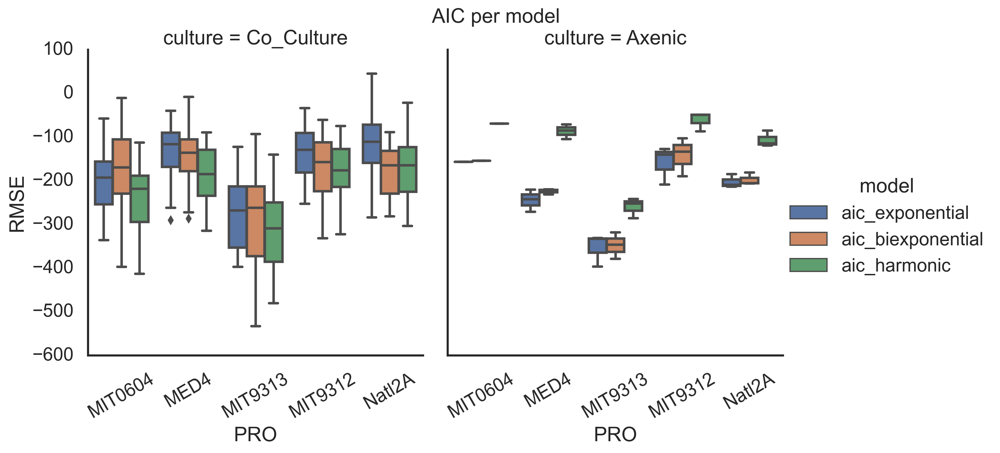

In [26]:
cols=['aic_exponential',# 'rmse_hyperbolic', 
                                    'aic_biexponential',
      'aic_harmonic'
      
      #'rmse_harmonic', 
      #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60',
      #'mse_exponential_5', 'mse_hyperbolic_5', 'mse_harmonic_5'
] 

g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols) & dfscorem.culture.isin(['Axenic', 'Co_Culture'])]
                , hue='model', y='RMSE', x='PRO',
                kind='box', #aspect=2,
           #palette='cubehelix'
            col='culture',
           )
g.set_xticklabels(rotation=30)
#plt.xticks(rotation=45)
plt.suptitle('AIC per model', y=1)

In [27]:
dfscorem.model.value_counts()

a2                    712
a1                    712
f                     712
rmse_harmonic         356
rmse_exponential      356
aic_biexponential     356
aic_harmonic          356
rmse_biexponential    356
rmse_weibull          356
aic_weibull           356
aic_exponential       356
weibull_a             356
weibull_td6           356
weibull_n             356
Name: model, dtype: int64

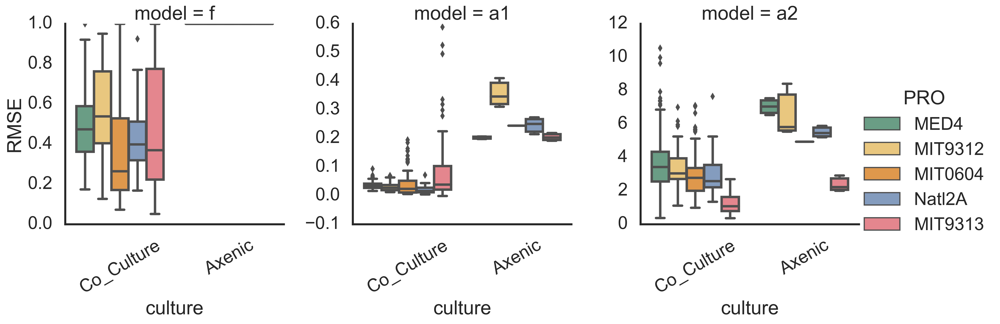

In [28]:
sns.set_context('poster')
cols= ['f', 'a1', 'a2']
g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols) & 
                                  dfscorem.culture.isin(['Axenic', 'Co_Culture'])],
                col='model',
                y='RMSE', #x='PRO',
                kind='box', #aspect=1,
            x='culture',
                #height=5, 
                             hue='PRO', hue_order=porder, palette=ppallete,
             #s=10,
             #   style='PRO', style_order=porder, markers=pmarkers,
            #    size='PRO', size_order=porder, sizes=psizes,
                sharey=False,
                #facet_kws={'sharey': False}
                aspect=1

           )
g.set_xticklabels(rotation=30)
#g.set_ylabels('rotation=30')

#plt.xticks(rotation=45)
#plt.suptitle('fraction of persistor cells', y=1)

In [29]:
dfscore.head()

,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,exponential_popt_3,...,weibull_popt_3,rmse_weibull,bic_weibull,aic_weibull,f,a1,a2,weibull_n,weibull_a,weibull_td6
0,"e1, 10A",e1,10A,MIT0604,DE,Co_Culture,0.141021,1.0,1.0,1.0,...,0.5,0.322152,-170.232915,-174.971810,0.168833,0.012057,5.618891,0.259722,0.896868,37387.117604
1,"e1, 10B",e1,10B,MIT0604,DE,Co_Culture,0.142509,0.5,0.5,0.5,...,1.0,0.327495,-167.633931,-172.372827,0.192854,0.012190,5.658023,0.264545,0.838354,39821.624572
2,"e1, 10C",e1,10C,MIT0604,DE,Co_Culture,0.164214,0.5,0.5,0.5,...,0.5,0.357230,-153.902249,-158.641145,0.159128,0.011453,5.701974,0.235531,1.007286,67344.665908
3,"e1, 11A",e1,11A,MED4,DE1,Co_Culture,0.101841,1.0,1.0,1.0,...,0.5,0.333052,-167.149036,-171.913089,0.543462,0.055430,7.198965,0.549802,0.342589,832.360852
4,"e1, 11B",e1,11B,MED4,DE1,Co_Culture,0.125338,1.0,1.0,1.0,...,0.5,0.254336,-207.578921,-212.317817,0.384274,0.045675,7.115493,0.458725,0.503584,1365.892459


In [30]:
dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic'])].groupby('culture')['f'].describe()

,count,mean,std,min,25%,50%,75%,max
culture,,,,,,,,
Axenic,13.0,1.000000,2.786822e-08,1.000000,1.000000,1.000000,1.000000,1.0
Co_Culture,340.0,0.474026,2.526095e-01,0.052008,0.275598,0.427898,0.630626,1.0


In [31]:
dfscore.loc[dfscore.culture.isin(['Co_Culture'])].groupby('experiment')['f'].describe()

,count,mean,std,min,25%,50%,75%,max
experiment,,,,,,,,
e1,70.0,0.433676,0.203083,0.159128,0.275340,0.385076,0.532851,1.0
e3,69.0,0.463473,0.246619,0.107213,0.284882,0.403112,0.575035,1.0
e4,72.0,0.394639,0.290449,0.052008,0.184406,0.294518,0.554291,1.0
e5,64.0,0.562223,0.265350,0.122389,0.358439,0.535466,0.754420,1.0
e6,65.0,0.529779,0.214686,0.148943,0.356963,0.497328,0.629908,1.0


In [32]:
dfscore.loc[dfscore.culture.isin(['Co_Culture']) & (dfscore.f <0.9)].nlargest(10, 'a1')


,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,exponential_popt_3,...,weibull_popt_3,rmse_weibull,bic_weibull,aic_weibull,f,a1,a2,weibull_n,weibull_a,weibull_td6
220,"e4, 7C",e4,7C,MIT9313,DE,Co_Culture,0.744416,0.5,0.5,0.5,...,1.0,0.071447,-339.942215,-344.321525,0.760759,0.588164,1.847351,0.868590,0.778912,27.404557
132,"e3, 2A",e3,2A,MIT9313,1A3,Co_Culture,0.210566,0.5,0.5,0.5,...,0.5,0.048849,-360.099866,-364.321614,0.780189,0.159343,1.035473,0.687487,0.344055,215.156579
306,"e6, 15A",e6,15A,MIT0604,DE1,Co_Culture,0.236566,1.0,1.0,1.0,...,0.5,0.075568,-204.355994,-207.783138,0.747611,0.157045,2.777067,0.616180,0.441766,267.007544
307,"e6, 15B",e6,15B,MIT0604,DE1,Co_Culture,0.191443,0.5,0.5,0.5,...,0.5,0.073470,-196.321247,-199.648370,0.741676,0.139469,2.671959,0.613990,0.417153,299.038628
102,"e3, 15B",e3,15B,MIT0604,DE1,Co_Culture,0.174960,1.0,1.0,1.0,...,1.0,0.080165,-344.816236,-349.313227,0.807357,0.139407,2.554681,0.703677,0.316380,214.209668
101,"e3, 15A",e3,15A,MIT0604,DE1,Co_Culture,0.168293,1.0,1.0,1.0,...,1.0,0.094032,-322.479764,-326.976755,0.730063,0.124480,2.708563,0.590608,0.403470,396.518505
323,"e6, 20B",e6,20B,MIT0604,BS11,Co_Culture,0.137616,1.0,1.0,1.0,...,1.0,0.079633,-200.059555,-203.486699,0.837762,0.115154,1.752274,0.681271,0.275832,312.554922
268,"e5, 2A",e5,2A,MIT9313,1A3,Co_Culture,0.136744,1.0,1.0,1.0,...,1.0,0.042272,-258.268671,-261.744010,0.821497,0.109582,0.841316,0.591575,0.331984,545.987370
254,"e5, 1C",e5,1C,MED4,1A3,Co_Culture,0.149385,0.5,0.5,0.5,...,0.5,0.079952,-100.016911,-102.105956,0.632780,0.093346,1.777014,0.628991,0.346988,349.818221
170,"e4, 15A",e4,15A,MIT0604,DE1,Co_Culture,0.157857,1.0,1.0,1.0,...,0.5,0.085264,-341.079070,-345.604430,0.639348,0.087631,2.263079,0.456047,0.507550,1400.740847


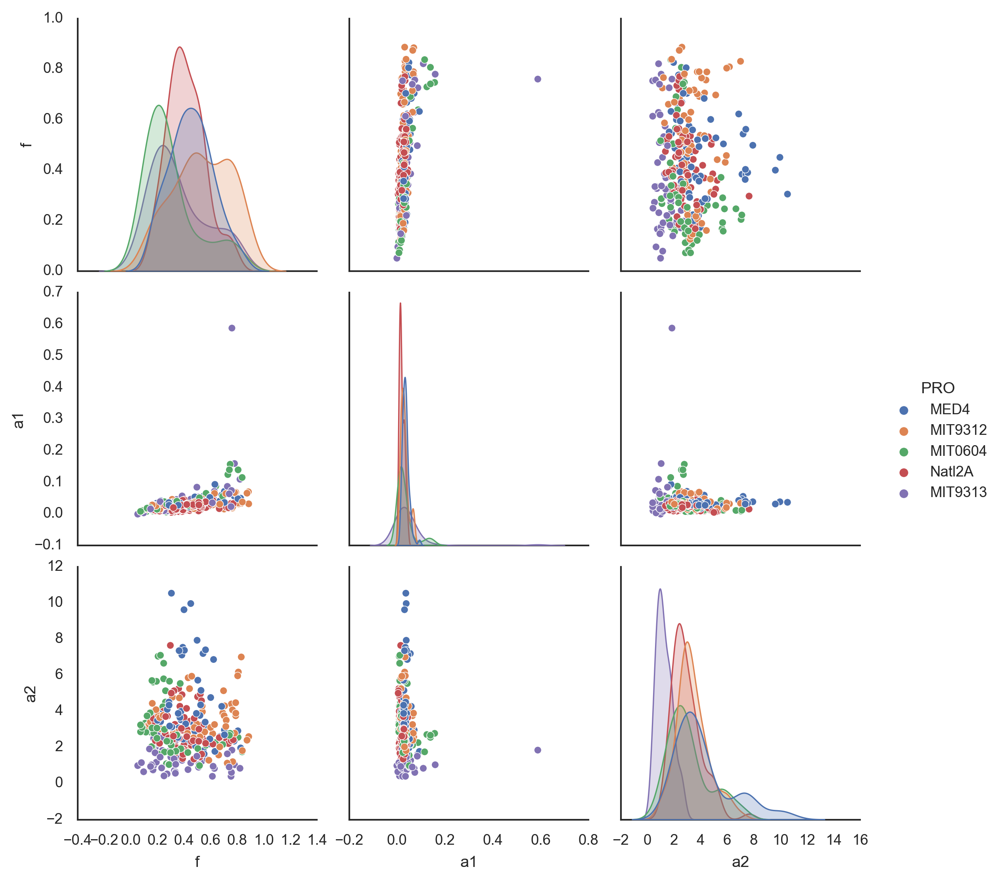

In [33]:
sns.set_context('paper')
sns.pairplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])& (dfscore.f <0.9)], 
             vars=['f', 'a1', 'a2'],
            hue='PRO', hue_order=porder)

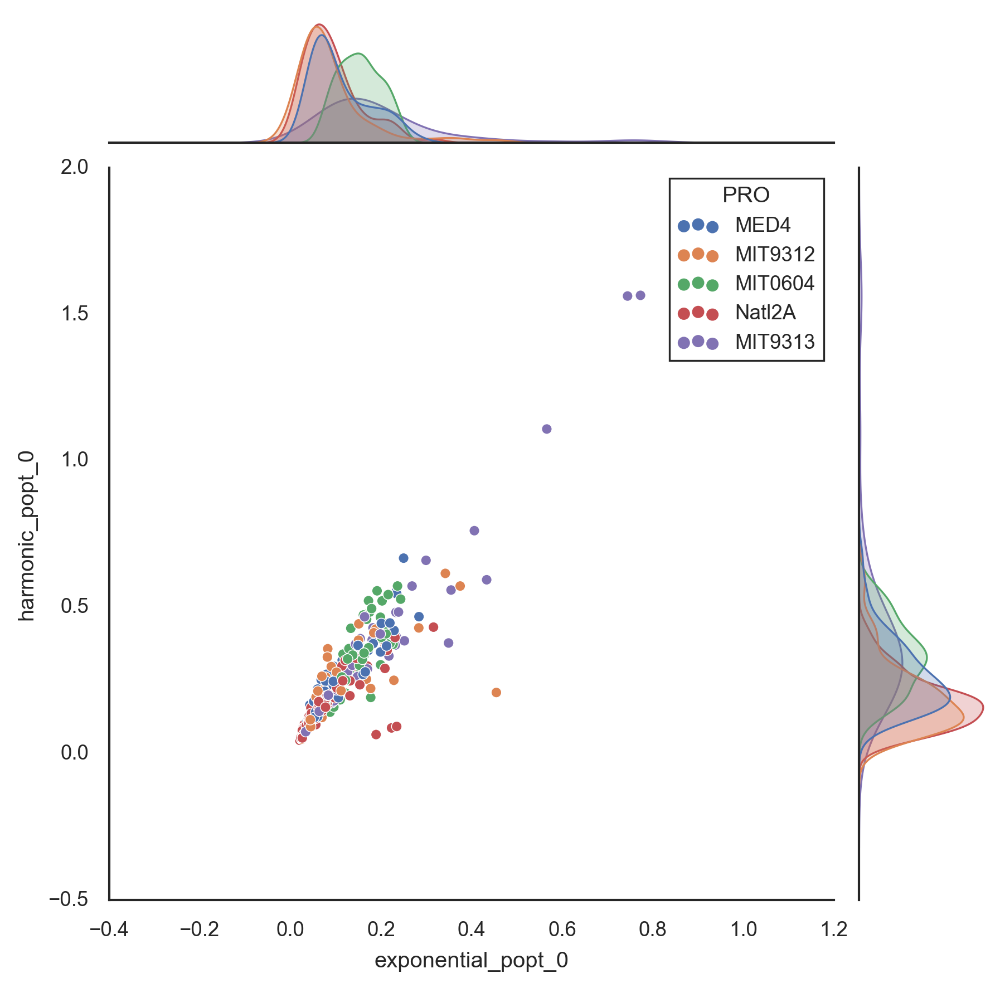

In [34]:
sns.set_context('paper')
sns.jointplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])& (dfscore.f <0.9)], 
             y='harmonic_popt_0', x='exponential_popt_0',
            hue='PRO', hue_order=porder)

In [35]:
dfscore.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'exponential_popt_0', 'exponential_popt_1', 'exponential_popt_2',
       'exponential_popt_3', 'rmse_exponential', 'bic_exponential',
       'aic_exponential', 'biexponential_popt_0', 'biexponential_popt_1',
       'biexponential_popt_2', 'biexponential_popt_3', 'rmse_biexponential',
       'bic_biexponential', 'aic_biexponential', 'harmonic_popt_0',
       'harmonic_popt_1', 'harmonic_popt_2', 'harmonic_popt_3',
       'rmse_harmonic', 'bic_harmonic', 'aic_harmonic', 'weibull_popt_0',
       'weibull_popt_1', 'weibull_popt_2', 'weibull_popt_3', 'rmse_weibull',
       'bic_weibull', 'aic_weibull', 'f', 'a1', 'a2', 'weibull_n', 'weibull_a',
       'weibull_td6'],
      dtype='object')

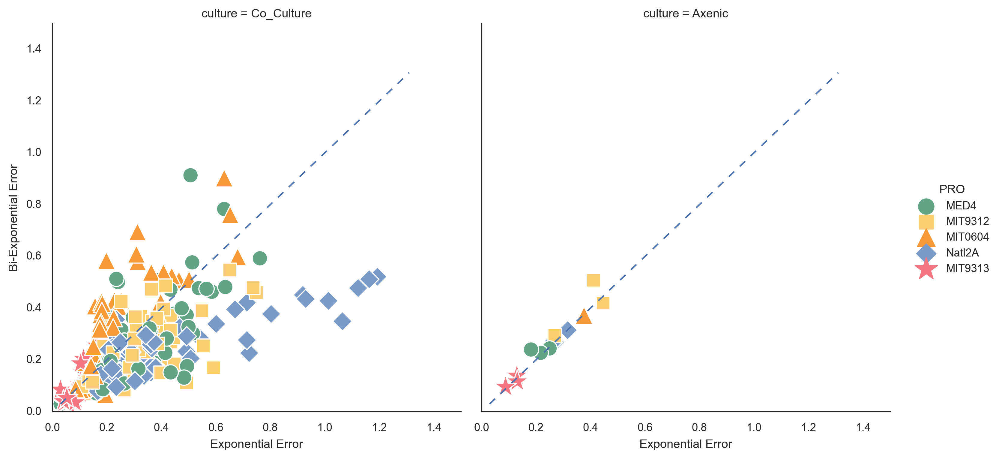

In [36]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin(['Axenic', 'Co_Culture'])], 
             x='rmse_exponential', y='rmse_biexponential',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             s=50,
                col='culture',
             #kind='reg'
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=psizes,
                facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Exponential Error', 'Bi-Exponential Error')



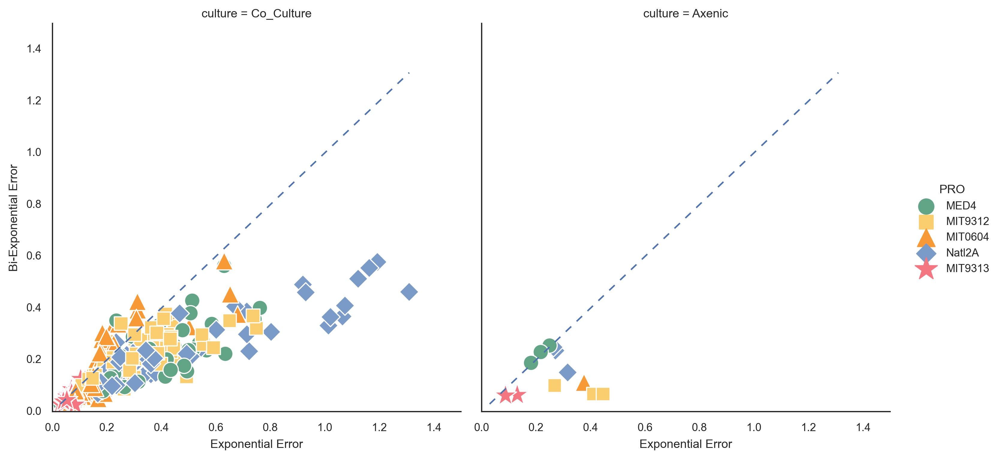

In [37]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin(['Axenic', 'Co_Culture'])], 
             x='rmse_exponential', y='rmse_weibull',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             s=50,
                col='culture',
             #kind='reg'
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=psizes,
                facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Exponential Error', 'Bi-Exponential Error')



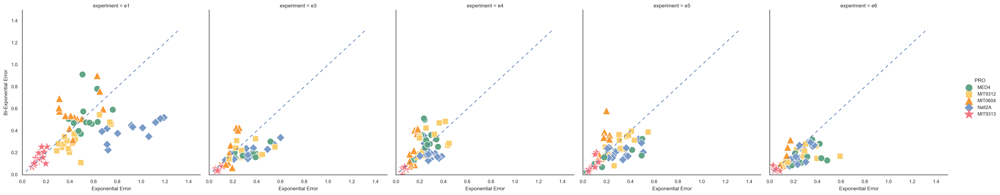

In [38]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin([ 'Co_Culture'])], 
             x='rmse_exponential', y='rmse_biexponential',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             s=50,
                #col='culture',
                col='experiment',
             #kind='reg'
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=psizes,
                facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Exponential Error', 'Bi-Exponential Error')



C:\Users\wosnat\Anaconda3\lib\site-packages\seaborn\distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\wosnat\Anaconda3\lib\site-packages\seaborn\distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


Text(0.5, 1, 'RMSE co-culture')

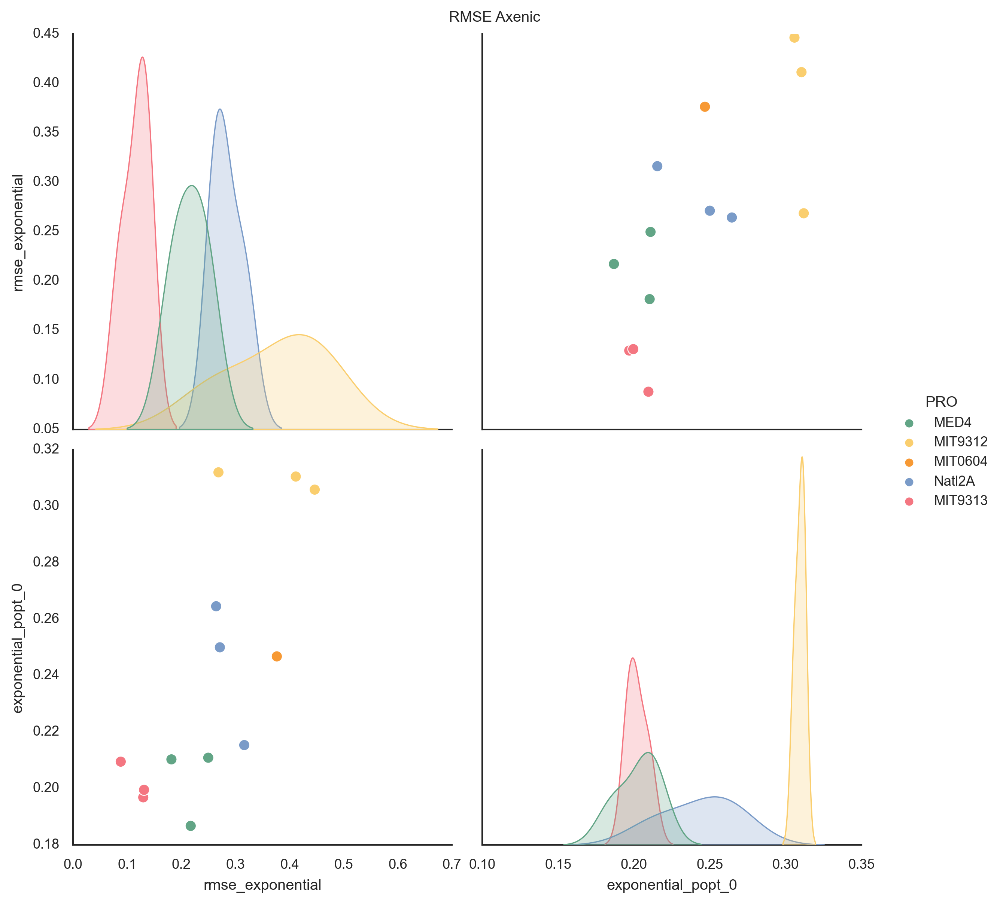

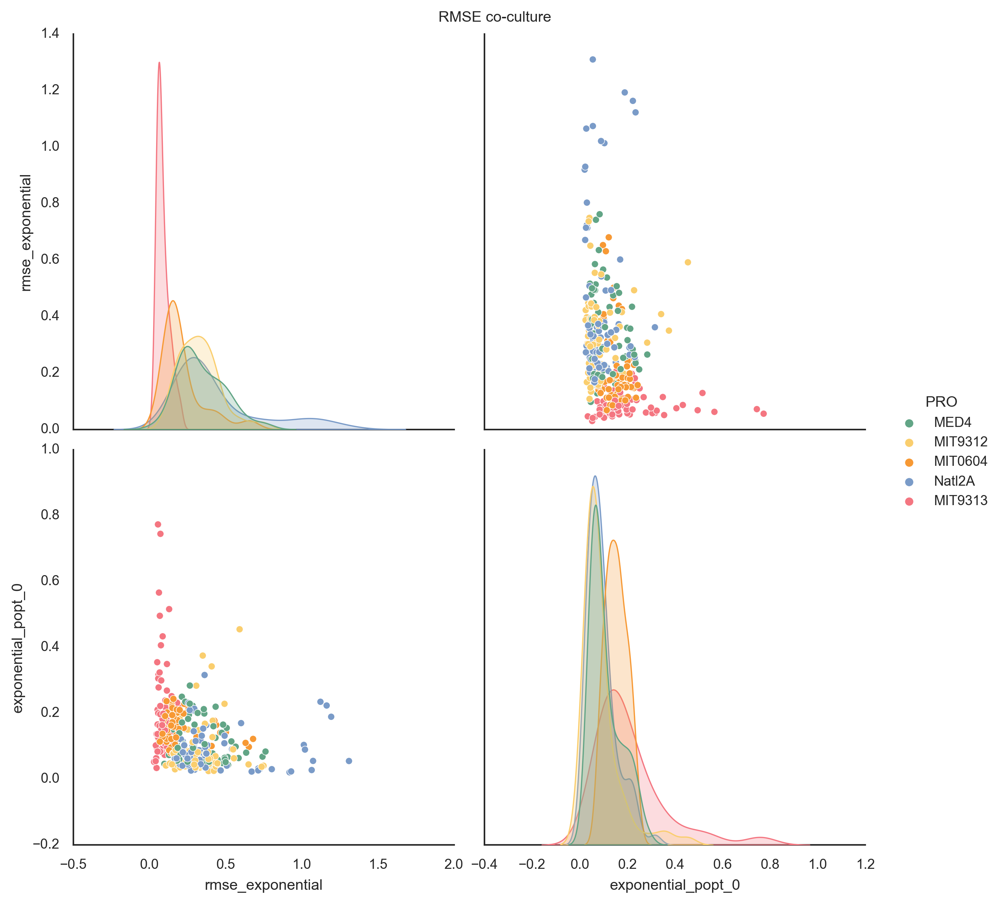

In [39]:
sns.pairplot(dfscore.loc[dfscore.culture == 'Axenic'], 
             vars=['rmse_exponential', #'rmse_hyperbolic', 
                   'exponential_popt_0',
                            #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60'
                            #'rmse_exponential_5', 'rmse_hyperbolic_5', 'rmse_harmonic_5',
                           ],
             height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             plot_kws={"s": 50},
             #kind='reg'
            )
plt.suptitle('RMSE Axenic', y=1)
sns.pairplot(dfscore.loc[dfscore.culture == 'Co_Culture'], 
             vars=['rmse_exponential', #'rmse_hyperbolic',
                   'exponential_popt_0',
                            #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60'
                            #'rmse_exponential_5', 'rmse_hyperbolic_5', 'rmse_harmonic_5',
                           ],
             height=4, 
             plot_kws={"s": 20},
             hue='PRO', hue_order=porder, palette=ppallete,
             #kind='reg'
            )
plt.suptitle('RMSE co-culture', y=1)


<AxesSubplot:xlabel='model', ylabel='culture-experiment'>

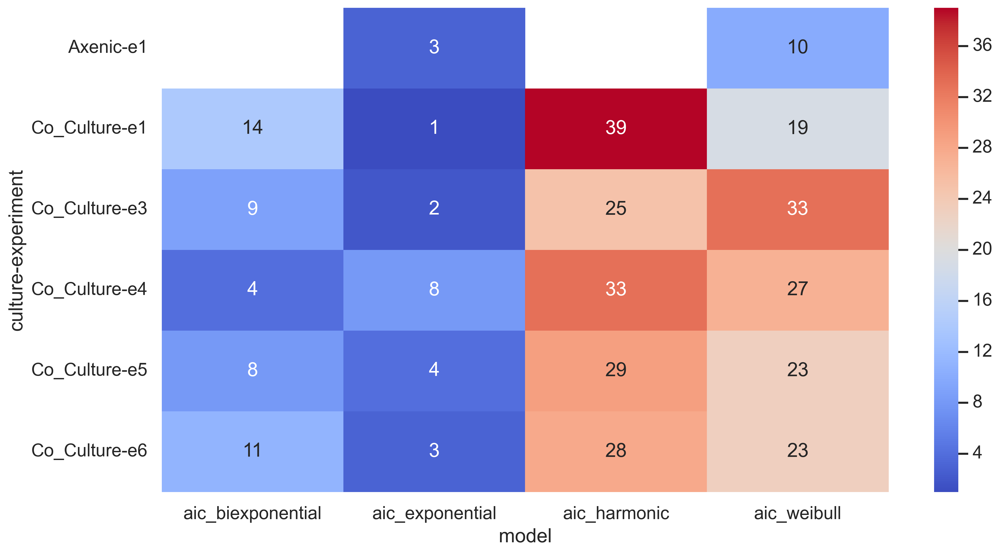

In [40]:
cols = [f'aic_{m}' for m in models]

best_model_df = dfscorem.loc[dfscorem.model.isin(cols)
                            ].sort_values('RMSE', ascending=True).drop_duplicates([
    'experiment_sample', ])
t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])].pivot_table(
    index=['culture',  'experiment'],columns=['model'], values='sample', aggfunc='count')
sns.set_context('talk')
sns.heatmap(t, annot=True, cmap='coolwarm')
#best_model_df

In [41]:
dict(zip(cols,models))

{'aic_exponential': 'exponential',
 'aic_biexponential': 'biexponential',
 'aic_harmonic': 'harmonic',
 'aic_weibull': 'weibull'}

Text(0.5, 1.0, 'best model (lowest aic)')

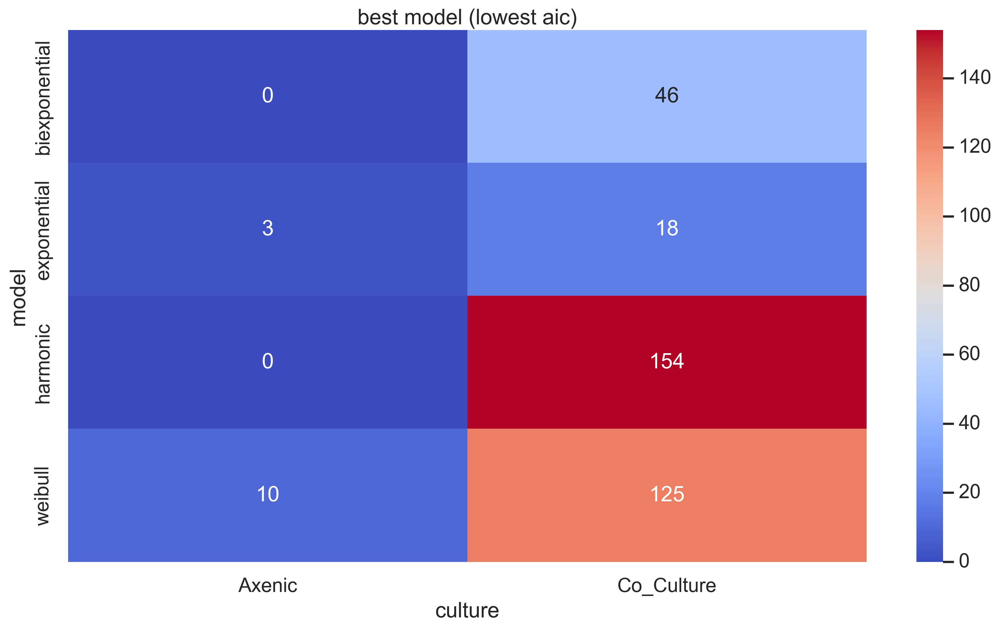

In [42]:
#best_model_df = dfscorem.loc[dfscorem.model.isin(['aic_exponential', #'aic_harmonic',
#                                                  'aic_biexponential',])
#                            ].sort_values('RMSE', ascending=True).drop_duplicates([
#    'experiment_sample', ])
cols = [f'aic_{m}' for m in models]
t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])].pivot_table(index=['culture'],columns=['model'], values='sample', aggfunc='count')
t.rename(columns=dict(zip(cols, models)), inplace=True)
t.fillna(0, inplace=True)
for i in t.columns:
    t[i] = t[i].astype(int)
sns.set_context('talk')
sns.heatmap(t.T, annot=True, cmap='coolwarm', fmt='d')
plt.title('best model (lowest aic)')

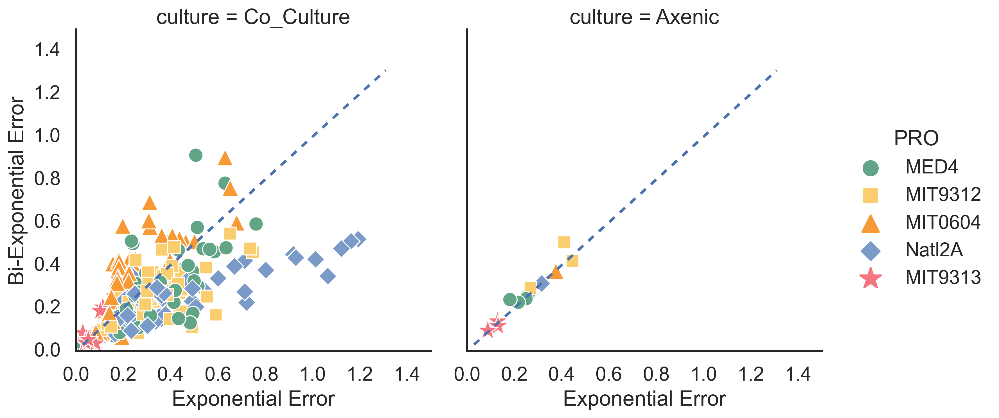

In [43]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin(['Axenic', 'Co_Culture'])], 
             x='rmse_exponential', y='rmse_biexponential',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             s=50,
                col='culture',
             #kind='reg'
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=psizes,
                facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Exponential Error', 'Bi-Exponential Error')



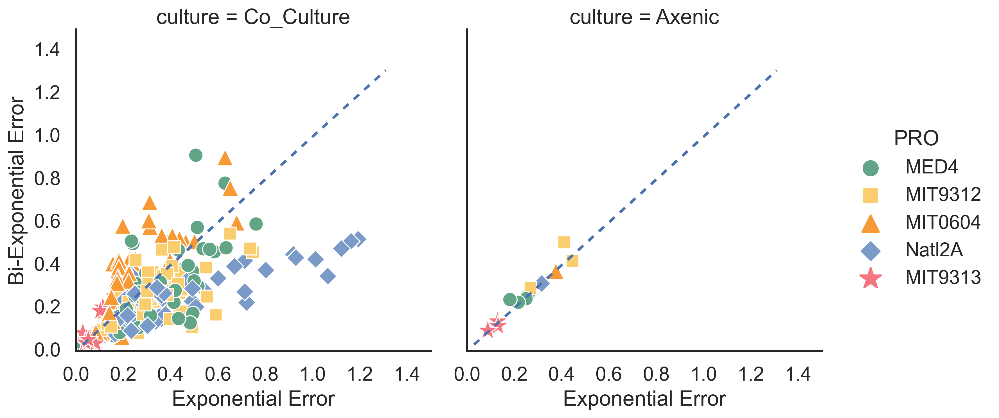

In [44]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin(['Axenic', 'Co_Culture'])], 
             x='rmse_exponential', y='rmse_biexponential',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             s=50,
                col='culture',
             #kind='reg'
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=psizes,
                facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Exponential Error', 'Bi-Exponential Error')



(0.7424568247286205, 1.450807036285034e-63)

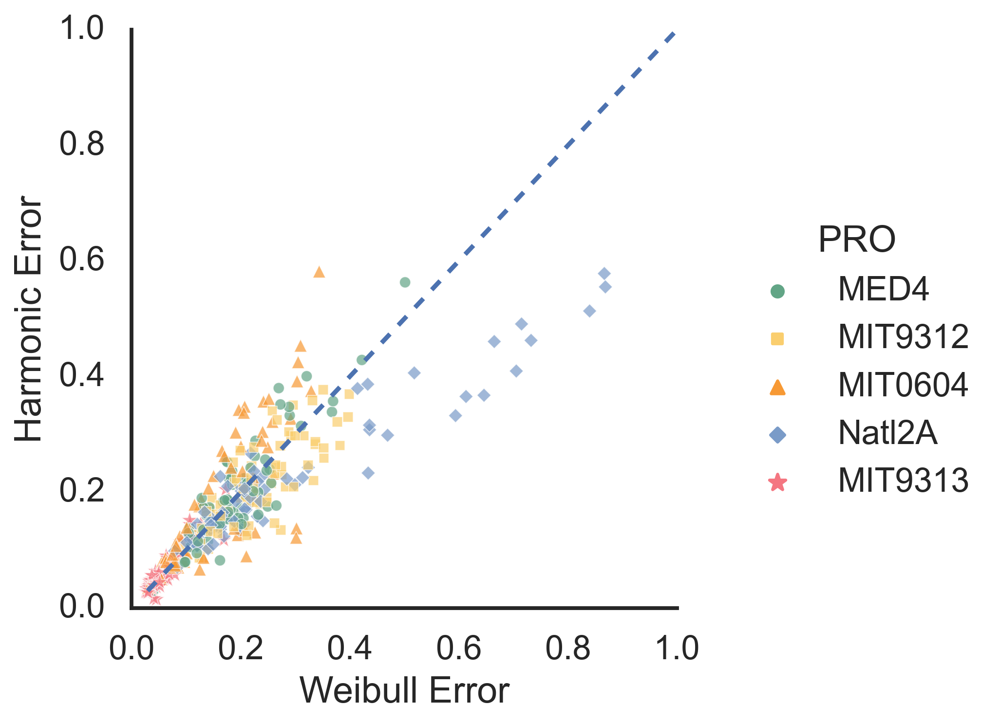

In [45]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin([#'Axenic', 
    'Co_Culture'])], 
             x='rmse_harmonic', y='rmse_weibull',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             #s=2, 
                alpha=0.7,
    #            col='culture',
             #kind='reg',
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=[s/5 for s in psizes],
                facet_kws=dict(ylim=(0,1), xlim=(0,1))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Weibull Error', 'Harmonic Error')
stats.pearsonr(dfscore.rmse_harmonic, dfscore.rmse_weibull, )


Text(0.5, 1.1, 'Weibull vs Harmonic Error (co-cultures)')

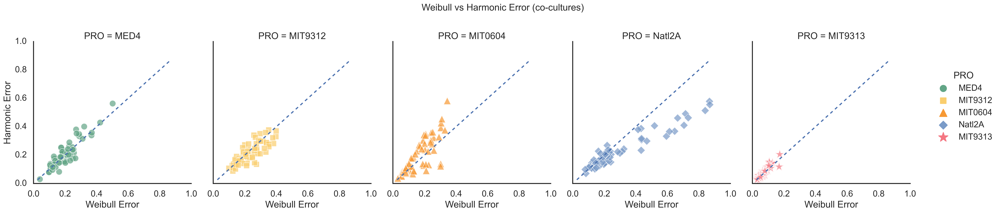

In [46]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin([#'Axenic', 
    'Co_Culture'])], 
                col='PRO', col_order=porder,
             x='rmse_harmonic', y='rmse_weibull',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             #s=2, 
                alpha=0.7,
    #            col='culture',
             #kind='reg',
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=[s for s in psizes],
                facet_kws=dict(ylim=(0,1), xlim=(0,1))
            )
g.map(sns.lineplot, x=dfscore['rmse_harmonic'], y=dfscore['rmse_harmonic'], linestyle='dashed' )
g.set_axis_labels('Weibull Error', 'Harmonic Error')
plt.suptitle('Weibull vs Harmonic Error (co-cultures)', y=1.1)


Text(0.5, 1.1, 'Weibull vs Harmonic AIC (co-cultures)')

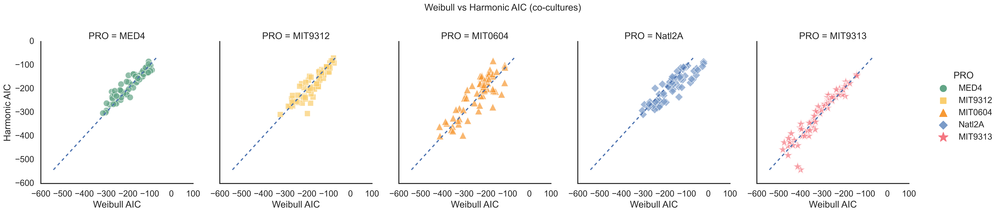

In [47]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin([#'Axenic', 
    'Co_Culture'])], 
                col='PRO', col_order=porder,
             x='aic_harmonic', y='aic_weibull',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             #s=2, 
                alpha=0.7,
    #            col='culture',
             #kind='reg',
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=[s for s in psizes],
                #facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['aic_weibull'], y=dfscore['aic_weibull'], linestyle='dashed' )
g.set_axis_labels('Weibull AIC', 'Harmonic AIC')
plt.suptitle('Weibull vs Harmonic AIC (co-cultures)', y=1.1)


Text(0.5, 1.0, 'best model fit')

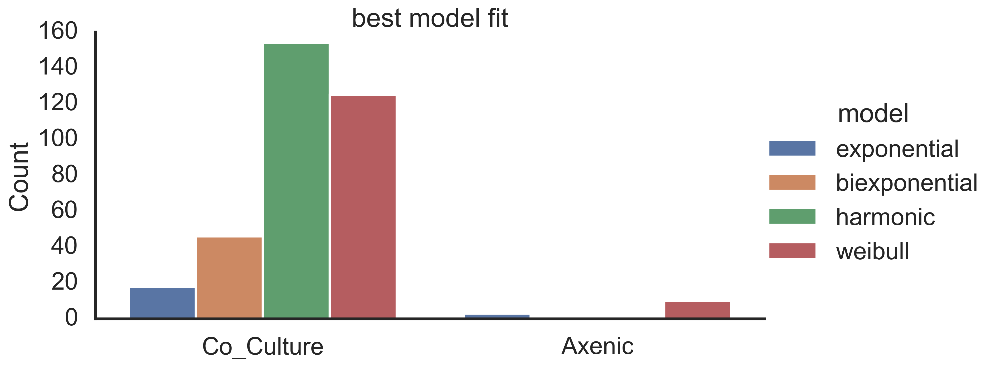

In [48]:
sns.set_context('poster')
b = best_model_df.copy()
b.model = b.model.map(dict(zip([f'aic_{m}'for m in models], models)))
#best_model_df.model = best_model_df.model.map({'bic_exponential': 'exponential', 'bic_harmonic': 'harmonic'})
sns.catplot(data=b, x='culture', hue='model', kind='count', aspect=2, hue_order=models
            #hue_order=['exponential', 'harmonic']
).set_axis_labels('', 'Count')
#.set(xticklabels=models, 
    #yticks=[0,0.5,1,1.5]
#                                     ).set_titles('{col_name}')# .set(font_scale=2)

plt.title("best model fit")

<AxesSubplot:xlabel='model', ylabel='culture-PRO'>

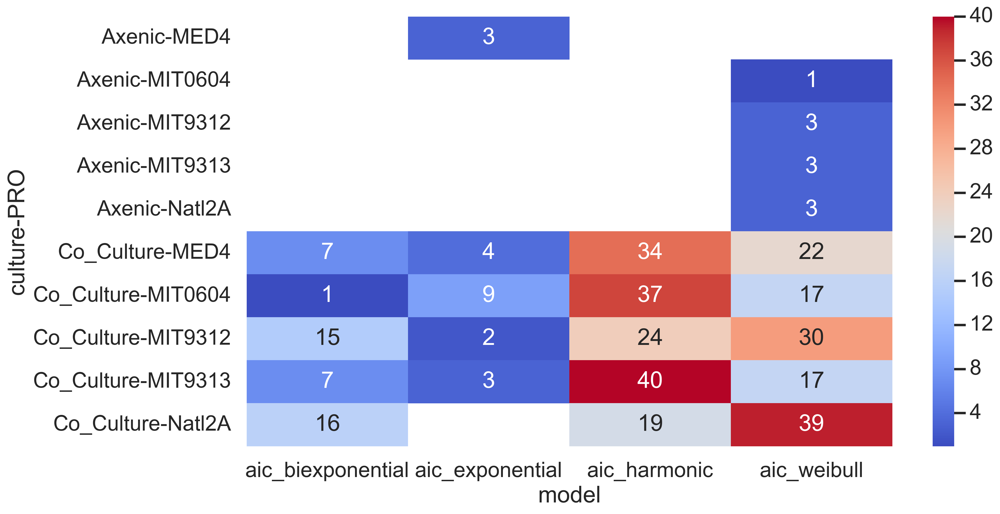

In [49]:
t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])].pivot_table(index=['culture',  'PRO', ],columns=[#'experiment', 
                                                                                                                             'model', ], values='sample', aggfunc='count')
#sns.set_context('talk')
sns.heatmap(t, annot=True, cmap='coolwarm')


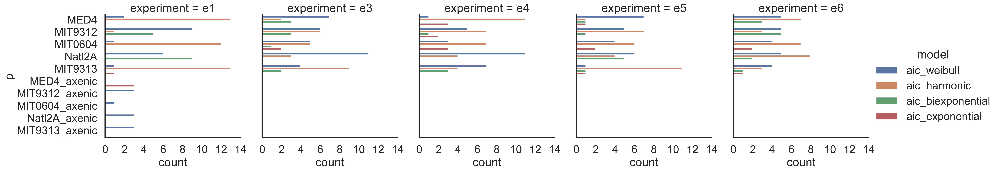

In [50]:
best_model_df['p'] = best_model_df['PRO']
best_model_df.loc[best_model_df.culture == 'Axenic','p'] = best_model_df.loc[best_model_df.culture == 'Axenic','p'] + '_axenic'
sns.catplot(data=best_model_df, y='p', hue='model', kind='count', col='experiment',
           order=['MED4', 'MIT9312', 'MIT0604', 'Natl2A', 'MIT9313', #'all', 'allP',
                     'MED4_axenic', 'MIT9312_axenic', 'MIT0604_axenic', 'Natl2A_axenic', 'MIT9313_axenic'
                     ],
            col_order=eorder,
           )


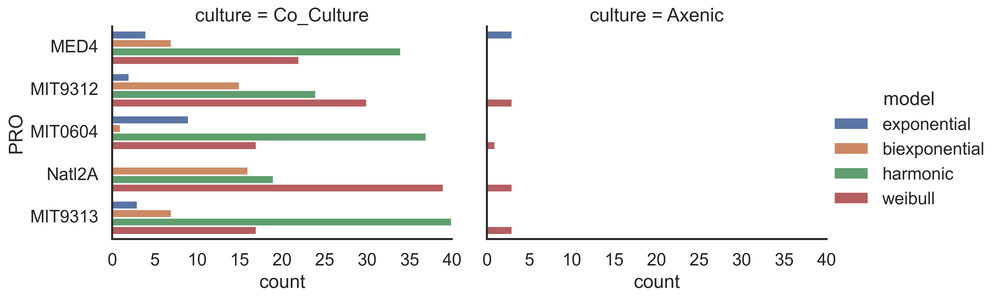

In [51]:
sns.set_context('talk')
b = best_model_df.copy()
b.model = b.model.map(dict(zip([f'aic_{m}'for m in models], models)))

#best_model_df['p'] = best_model_df['PRO']
#best_model_df.loc[best_model_df.culture == 'Axenic','p'] = best_model_df.loc[best_model_df.culture == 'Axenic','p'] + '_axenic'
sns.catplot(data=b,
            y='PRO', hue='model', kind='count', col='culture',
           order=porder, hue_order=models,
            col_order=['Co_Culture', 'Axenic'],
            aspect=1.4, height=4
            #col_order=eorder,
           )


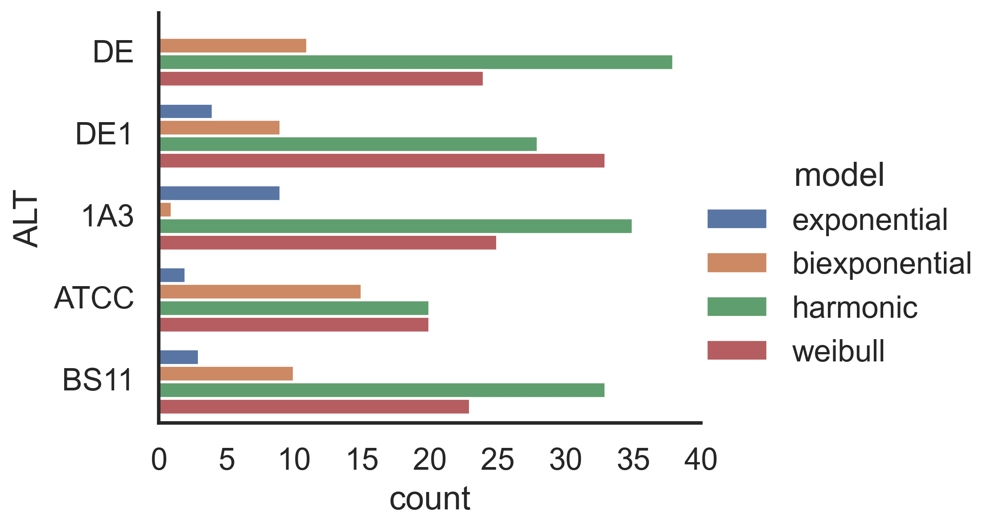

In [52]:
sns.set_context('talk')
b = best_model_df.copy()
b.model = b.model.map(dict(zip([f'aic_{m}'for m in models], models)))

#best_model_df['p'] = best_model_df['PRO']
#best_model_df.loc[best_model_df.culture == 'Axenic','p'] = best_model_df.loc[best_model_df.culture == 'Axenic','p'] + '_axenic'
sns.catplot(data=b,
            y='ALT', hue='model', kind='count', #col='culture',
           order=aorder, hue_order=models,
            #col_order=['Co_Culture', 'Axenic'],
            #row='experiment'
            aspect=1.4, height=4
            #col_order=eorder,
           )


In [53]:
best_model_df.p.unique()

array(['MIT9313', 'MIT9313_axenic', 'MIT9312_axenic', 'MIT0604',
       'MIT0604_axenic', 'MIT9312', 'MED4', 'Natl2A', 'Natl2A_axenic',
       'MED4_axenic'], dtype=object)

In [54]:
porder

['MED4', 'MIT9312', 'MIT0604', 'Natl2A', 'MIT9313']

In [55]:
best_model_df.head()

,experiment_sample,experiment,sample,PRO,ALT,culture,model,RMSE,s,e,p
2653,"e4, 12A",e4,12A,MIT9313,DE1,Co_Culture,aic_weibull,-542.074565,"12A, DE1","e4, Co_Culture",MIT9313
2654,"e4, 12B",e4,12B,MIT9313,DE1,Co_Culture,aic_weibull,-528.704825,"12B, DE1","e4, Co_Culture",MIT9313
2640,"e3, 7B",e3,7B,MIT9313,DE,Co_Culture,aic_weibull,-480.975115,"7B, DE","e3, Co_Culture",MIT9313
2229,"e3, 12B",e3,12B,MIT9313,DE1,Co_Culture,aic_harmonic,-480.079103,"12B, DE1","e3, Co_Culture",MIT9313
2244,"e3, 17C",e3,17C,MIT9313,BS11,Co_Culture,aic_harmonic,-473.740828,"17C, BS11","e3, Co_Culture",MIT9313


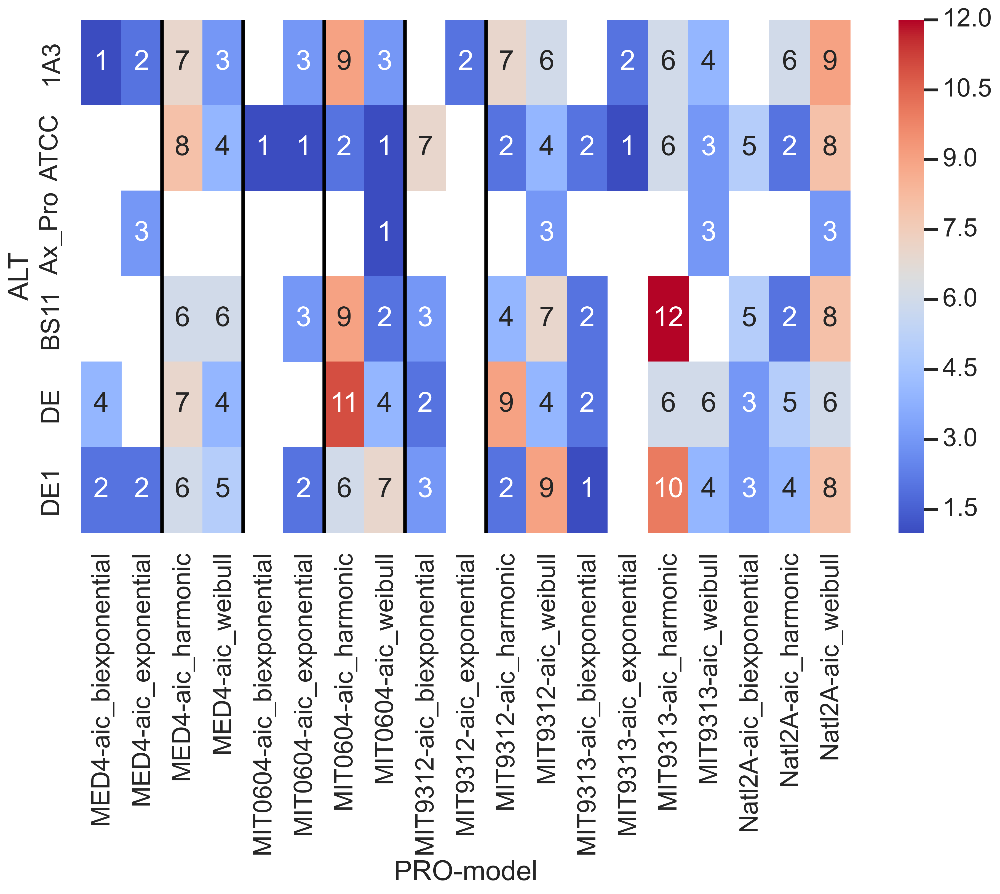

In [56]:

t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])
                     ].pivot_table(index=['ALT'], columns=['PRO','model', ], values='sample', aggfunc='count')
sns.set_context('poster')
sns.heatmap(t, annot=True, cmap='coolwarm' )
for i in [2,4,6,8,10]:
    plt.axvline(i, color='black',)


In [57]:
best_model_df['model'].value_counts()


aic_harmonic         154
aic_weibull          135
aic_biexponential     46
aic_exponential       21
Name: model, dtype: int64

In [58]:
best_model_df.head()


,experiment_sample,experiment,sample,PRO,ALT,culture,model,RMSE,s,e,p
2653,"e4, 12A",e4,12A,MIT9313,DE1,Co_Culture,aic_weibull,-542.074565,"12A, DE1","e4, Co_Culture",MIT9313
2654,"e4, 12B",e4,12B,MIT9313,DE1,Co_Culture,aic_weibull,-528.704825,"12B, DE1","e4, Co_Culture",MIT9313
2640,"e3, 7B",e3,7B,MIT9313,DE,Co_Culture,aic_weibull,-480.975115,"7B, DE","e3, Co_Culture",MIT9313
2229,"e3, 12B",e3,12B,MIT9313,DE1,Co_Culture,aic_harmonic,-480.079103,"12B, DE1","e3, Co_Culture",MIT9313
2244,"e3, 17C",e3,17C,MIT9313,BS11,Co_Culture,aic_harmonic,-473.740828,"17C, BS11","e3, Co_Culture",MIT9313


In [59]:
dfscore.describe()

,exponential_popt_0,exponential_popt_1,exponential_popt_2,exponential_popt_3,rmse_exponential,bic_exponential,aic_exponential,biexponential_popt_0,biexponential_popt_1,biexponential_popt_2,...,weibull_popt_3,rmse_weibull,bic_weibull,aic_weibull,f,a1,a2,weibull_n,weibull_a,weibull_td6
count,356.000000,356.000000,356.000000,356.000000,356.000000,356.000000,356.000000,353.000000,3.530000e+02,353.000000,...,356.000000,356.000000,356.000000,356.000000,353.000000,353.000000,353.000000,356.000000,356.000000,3.560000e+02
mean,0.132459,0.740169,0.740169,0.740169,0.285225,-168.718303,-170.772603,0.053791,5.000000e-01,3.007715,...,0.752809,0.178521,-216.433439,-220.542040,0.493396,0.052579,3.008927,0.568416,0.459267,1.199088e+100
std,0.098983,0.250158,0.250158,0.250158,0.209286,89.433347,89.513203,0.082460,8.711431e-15,1.738319,...,0.250336,0.108365,89.070615,89.354863,0.267013,0.076564,1.736522,0.451399,0.315538,2.262435e+101
min,0.020703,0.500000,0.500000,0.500000,0.029888,-394.882608,-397.131103,-0.000814,5.000000e-01,0.225162,...,0.500000,0.014987,-537.725790,-542.074565,0.052008,-0.000814,0.375209,0.006733,0.002474,8.056234e+00
25%,0.063553,0.500000,0.500000,0.500000,0.145926,-218.668637,-220.619286,0.016605,5.000000e-01,1.847351,...,0.500000,0.097794,-260.497918,-264.518098,0.284883,0.016605,1.847351,0.339969,0.249164,8.425963e+02
50%,0.104735,0.500000,0.500000,0.500000,0.241412,-160.906561,-162.911260,0.028450,5.000000e-01,2.732173,...,1.000000,0.156450,-204.351369,-208.361341,0.450550,0.028450,2.732173,0.462176,0.406009,2.068029e+03
75%,0.177287,1.000000,1.000000,1.000000,0.365301,-104.224975,-106.104674,0.045164,5.000000e-01,3.729806,...,1.000000,0.233010,-148.975435,-153.118809,0.691184,0.045164,3.729806,0.601750,0.618155,9.408491e+03
max,0.773035,1.000000,1.000000,1.000000,1.310051,48.145187,45.750738,0.652878,5.000000e-01,10.540984,...,1.000000,0.582104,-66.560456,-69.727494,1.000000,0.588164,10.540984,3.745487,2.814410,4.268753e+102


In [60]:
sns.set_context('poster')

In [61]:
dfscore.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'exponential_popt_0', 'exponential_popt_1', 'exponential_popt_2',
       'exponential_popt_3', 'rmse_exponential', 'bic_exponential',
       'aic_exponential', 'biexponential_popt_0', 'biexponential_popt_1',
       'biexponential_popt_2', 'biexponential_popt_3', 'rmse_biexponential',
       'bic_biexponential', 'aic_biexponential', 'harmonic_popt_0',
       'harmonic_popt_1', 'harmonic_popt_2', 'harmonic_popt_3',
       'rmse_harmonic', 'bic_harmonic', 'aic_harmonic', 'weibull_popt_0',
       'weibull_popt_1', 'weibull_popt_2', 'weibull_popt_3', 'rmse_weibull',
       'bic_weibull', 'aic_weibull', 'f', 'a1', 'a2', 'weibull_n', 'weibull_a',
       'weibull_td6'],
      dtype='object')

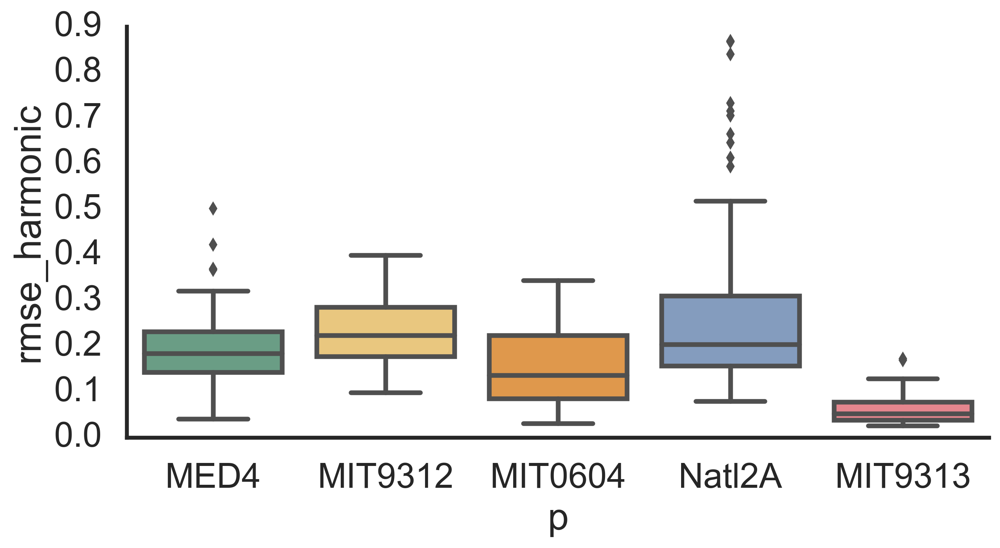

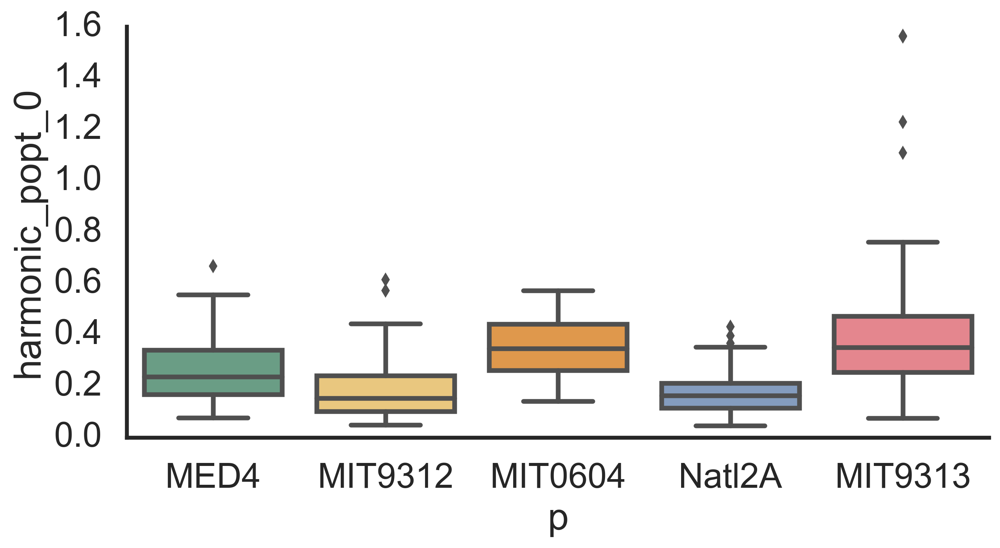

In [62]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture=='Axenic','p'] = dfscore.loc[dfscore.culture=='Axenic','p'] + '_Axenic'

for i in ['rmse_harmonic', 'harmonic_popt_0', ]:
    sns.catplot(data=dfscore.loc[dfscore.culture =='Co_Culture'], 
                x='p', y=i, kind='box',
           order=porder, palette=ppallete,
           aspect=1.8)


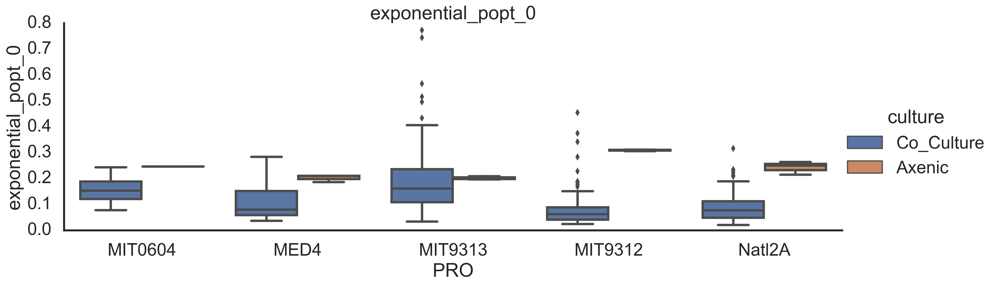

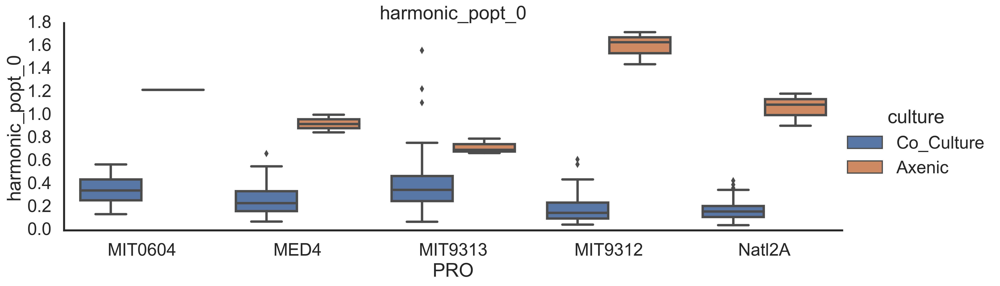

In [63]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0',  'harmonic_popt_0']:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic'])], 
                x='PRO', y=i, kind='box',
                hue='culture',
           #order=porder, palette=ppallete,
           aspect=3)
    #plt.yscale('log')
    #plt.xticks(rotation=30)
    plt.title(i)


(0.0, 1.4)

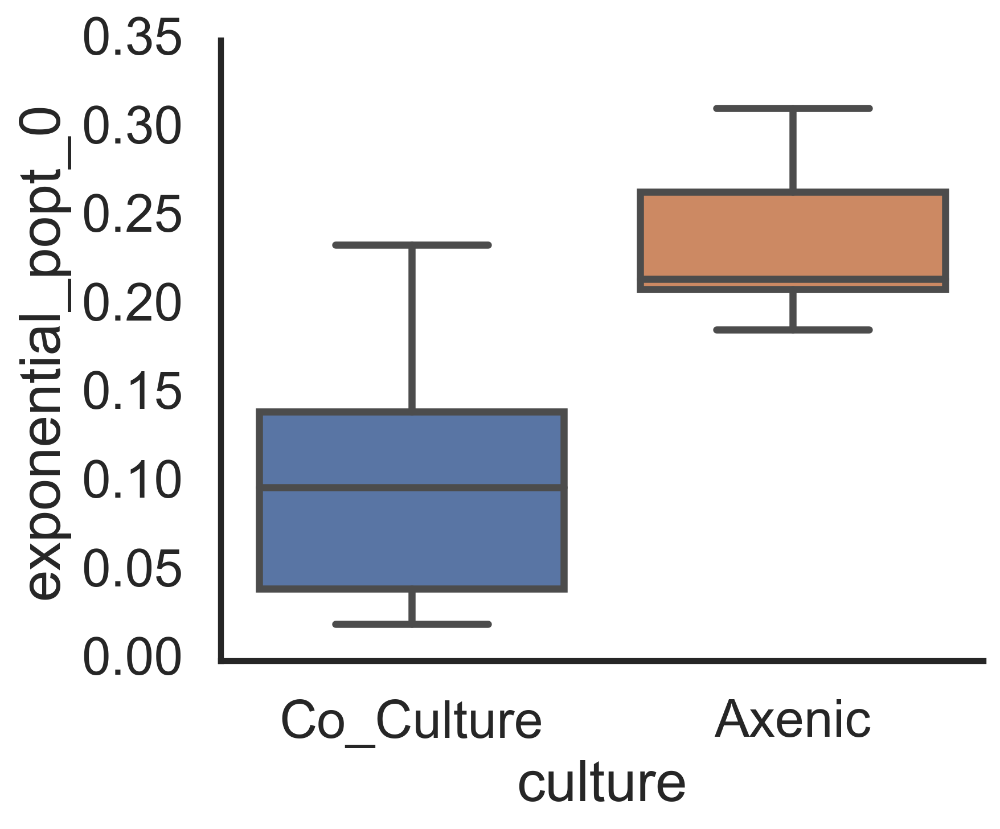

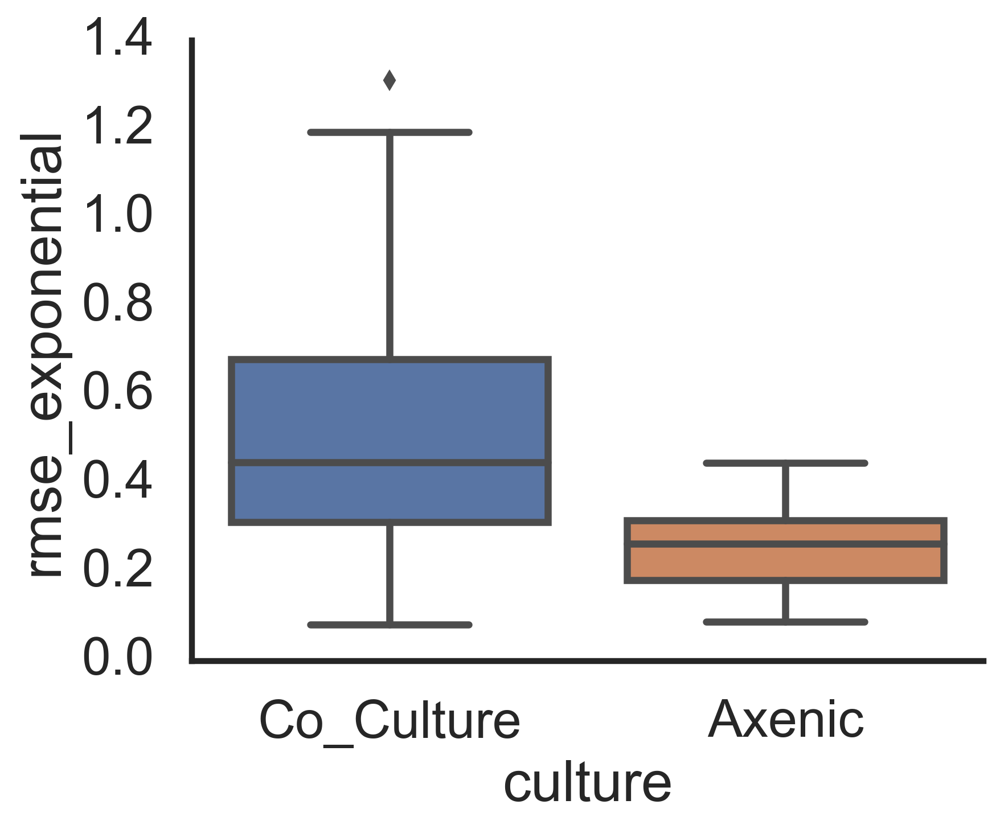

In [64]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                             dfscore.experiment.isin(['e1'])], 
            #x='PRO', 
            y='exponential_popt_0', kind='box',
            x='culture',
       aspect=1.2
            
           )
plt.ylim(0,0.35)

sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                             dfscore.experiment.isin(['e1'])], 
            #x='PRO', 
            y='rmse_exponential', kind='box',
            x='culture',
       aspect=1.2
            
           )
plt.ylim(0,1.4)



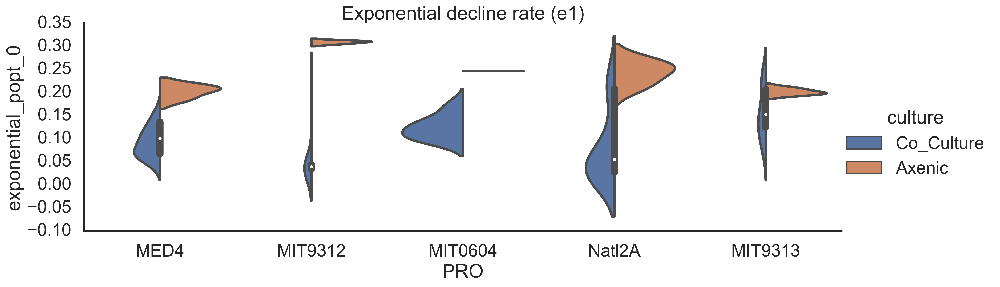

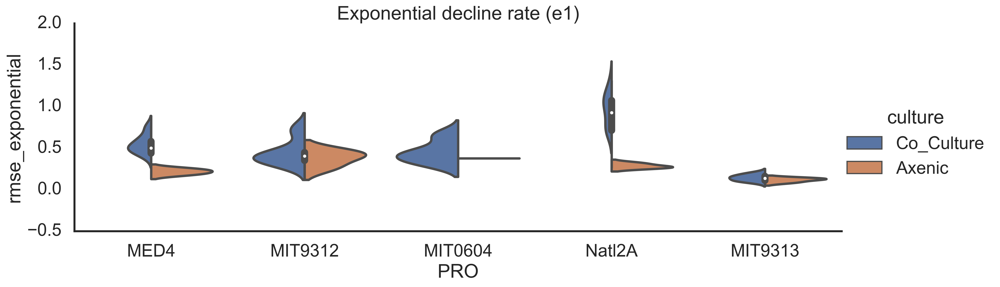

In [65]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                                 dfscore.experiment.isin(['e1'])], 
                x='PRO', 
                y=i, kind='violin',
                hue='culture',
                split=True,
           order=porder, #palette=ppallete,
           aspect=3
               )
    #plt.yscale('log')
    #plt.xticks(rotation=30)
    #plt.title(i)
    plt.title('Exponential decline rate (e1)')


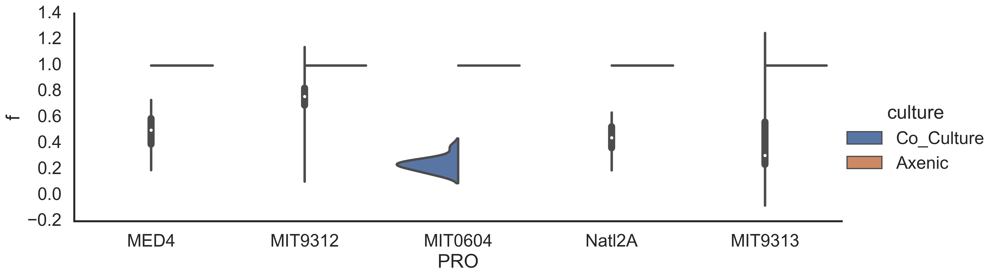

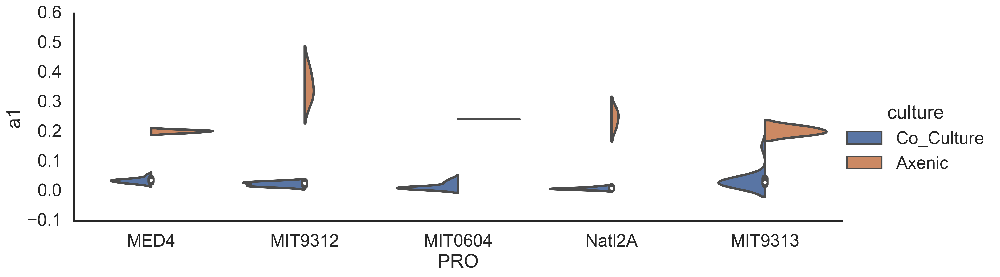

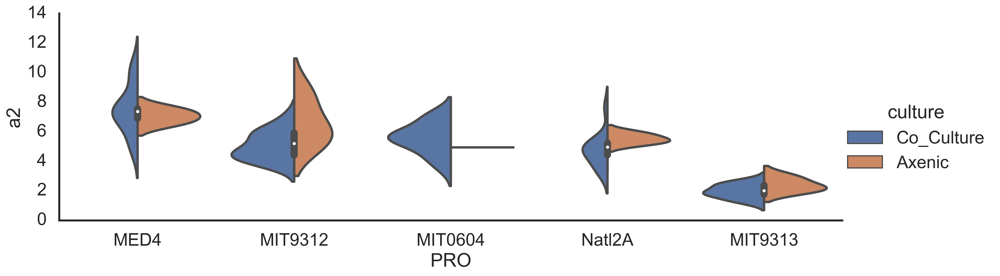

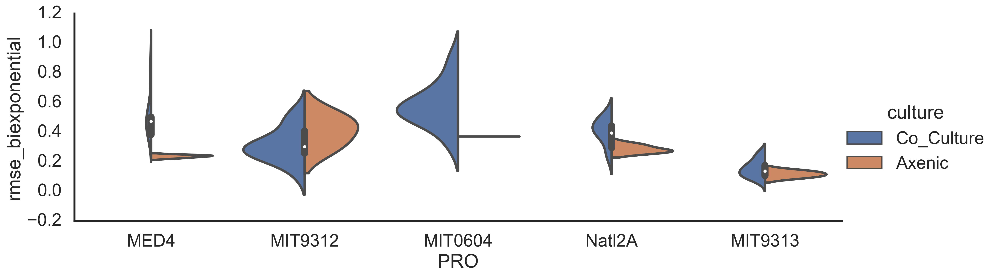

In [66]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['f', 'a1', 'a2', 'rmse_biexponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                                 dfscore.experiment.isin(['e1'])], 
                x='PRO', 
                y=i, kind='violin',
                hue='culture',
                split=True,
           order=porder, #palette=ppallete,
           aspect=3
               )
    #plt.yscale('log')
    #plt.xticks(rotation=30)
    #plt.title(i)
    #plt.title('Exponential decline rate (e1)')


(0.0, 1.4)

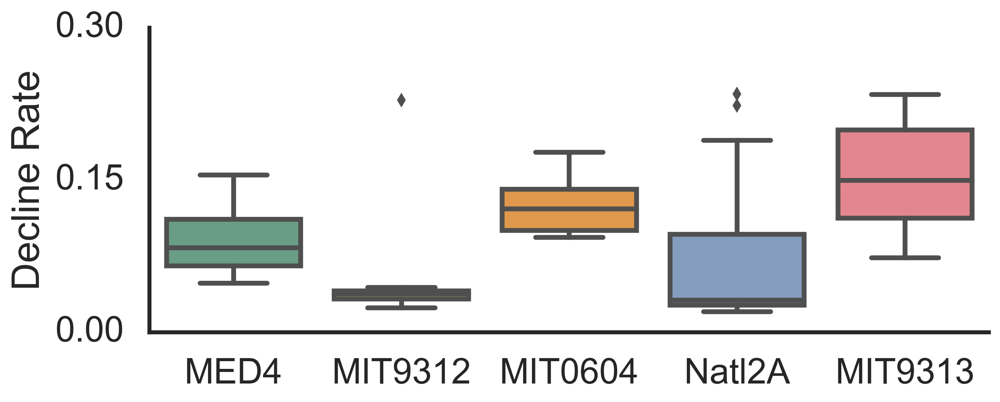

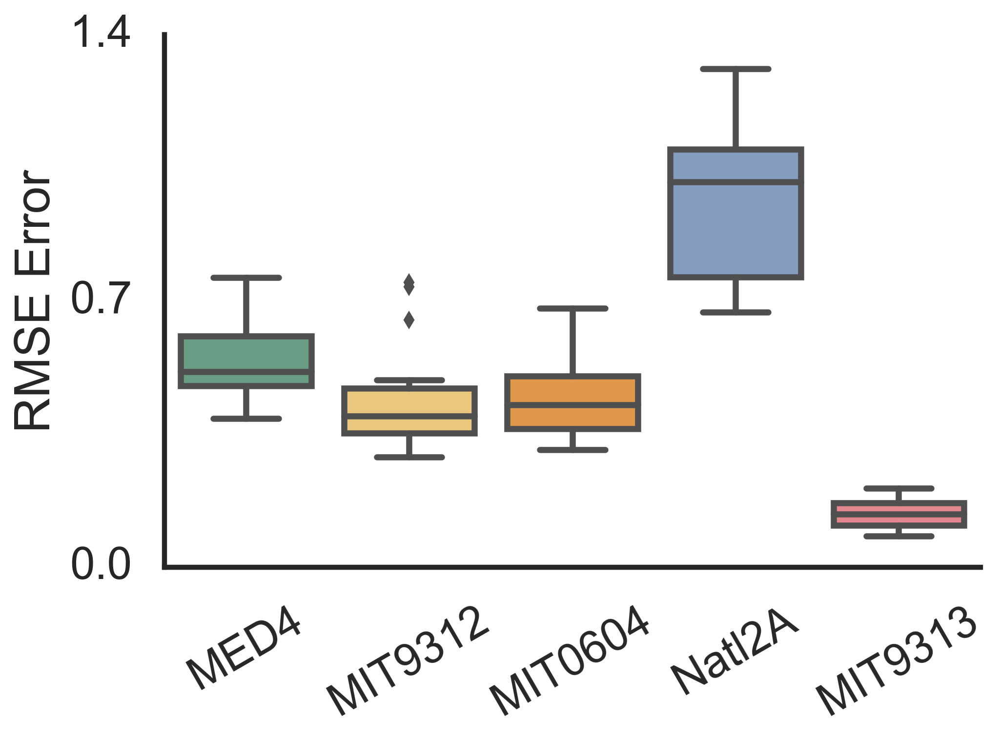

In [67]:
sns.set(context='poster', style='white', font_scale=1)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='PRO', 
            y='exponential_popt_0', kind='box',
            #col='culture',
       order=porder, palette=ppallete,
       aspect=2.2, height=4,
           ).set(yticks=[0,0.15,0.3]).set_axis_labels('','Decline Rate')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,0.35)
#plt.title(i)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='PRO', 
            y='rmse_exponential', kind='box',
            #col='culture',
       order=porder, palette=ppallete,
       aspect=1.4, height=5
           ).set(yticks=[0,0.7,1.4]).set_axis_labels('','RMSE Error')
#plt.yscale('log')
plt.xticks(rotation=30)
plt.ylim(0,1.4)


(0.0, 1.4)

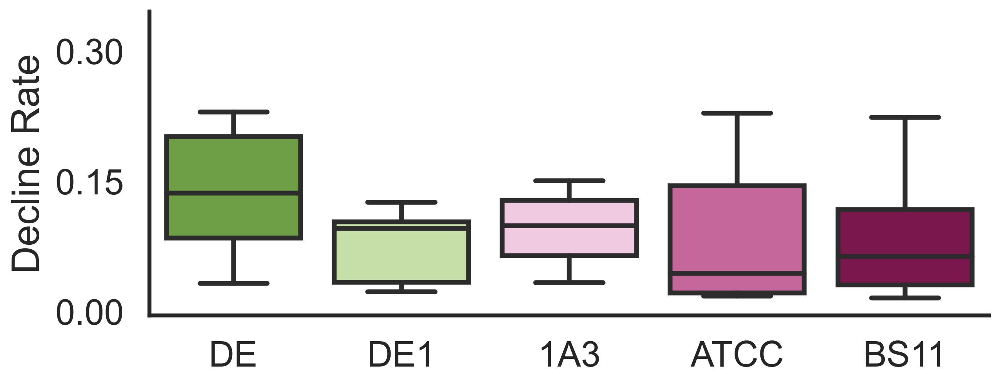

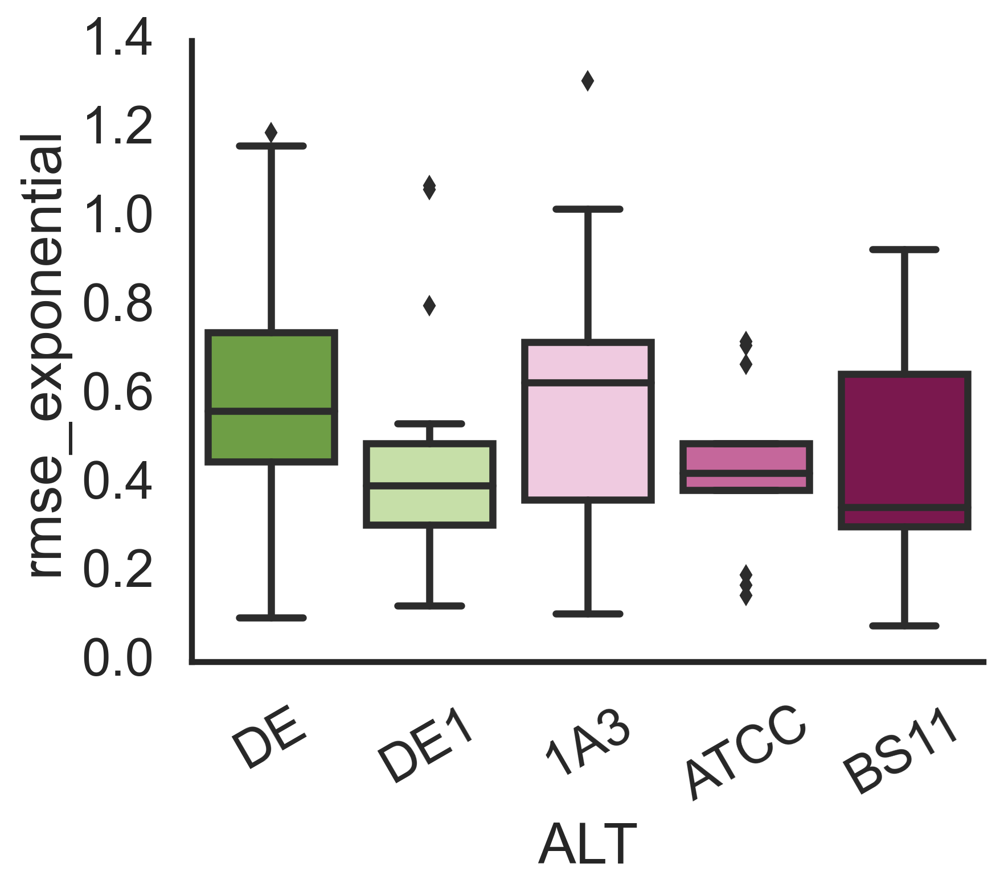

In [68]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='ALT', 
            y='exponential_popt_0', kind='box',
            #col='culture',
       order=aorder, palette=apallete,
       aspect=2.2, height=4,
           ).set(yticks=[0,0.15,0.3]).set_axis_labels('','Decline Rate')
#plt.yscale('log')
#plt.xticks(rotation=30)
plt.ylim(0,0.35)
#plt.title(i)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='ALT', 
            y='rmse_exponential', kind='box',
            #col='culture',
       order=aorder, palette=apallete,
       aspect=1.2
           )
#plt.yscale('log')
plt.xticks(rotation=30)
plt.ylim(0,1.4)


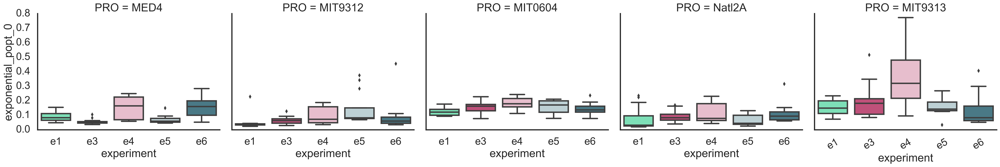

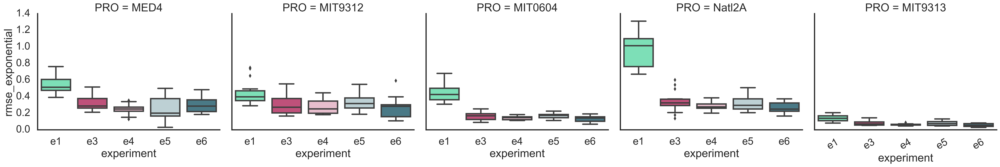

In [69]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                col='PRO', 
                x='experiment',
                y=i, kind='box',
                #col='culture',
           order=eorder, palette=epallete,
                col_order=porder,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


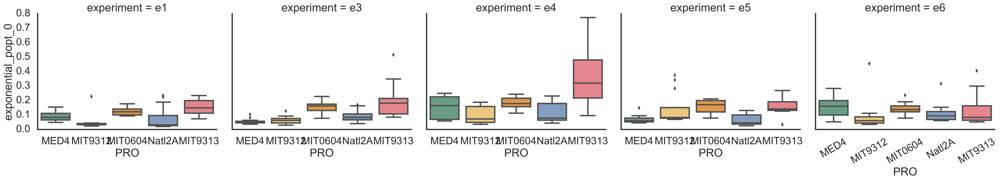

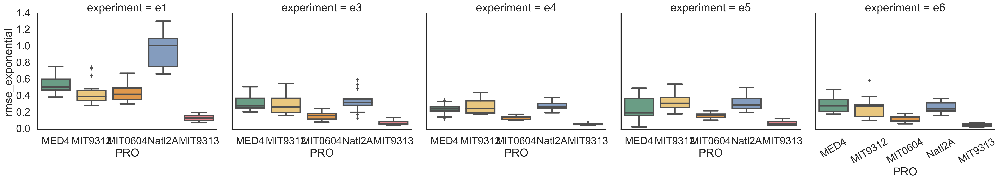

In [70]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                col='experiment', 
                x='PRO',
                y=i, kind='box',
                #col='culture',
           order=porder, palette=ppallete,
                col_order=eorder,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


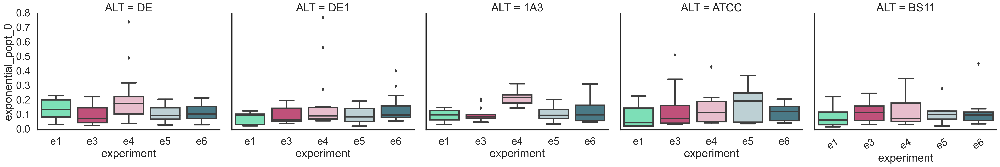

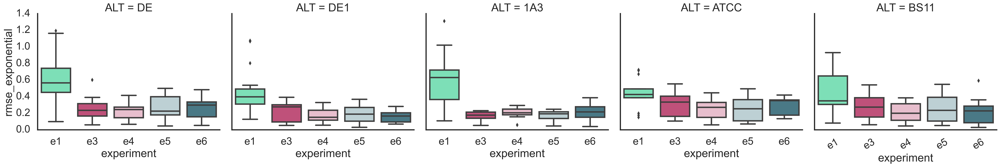

In [71]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                col='ALT', 
                x='experiment',
                y=i, kind='box',
                #col='culture',
           order=eorder, palette=epallete,
                col_order=aorder,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


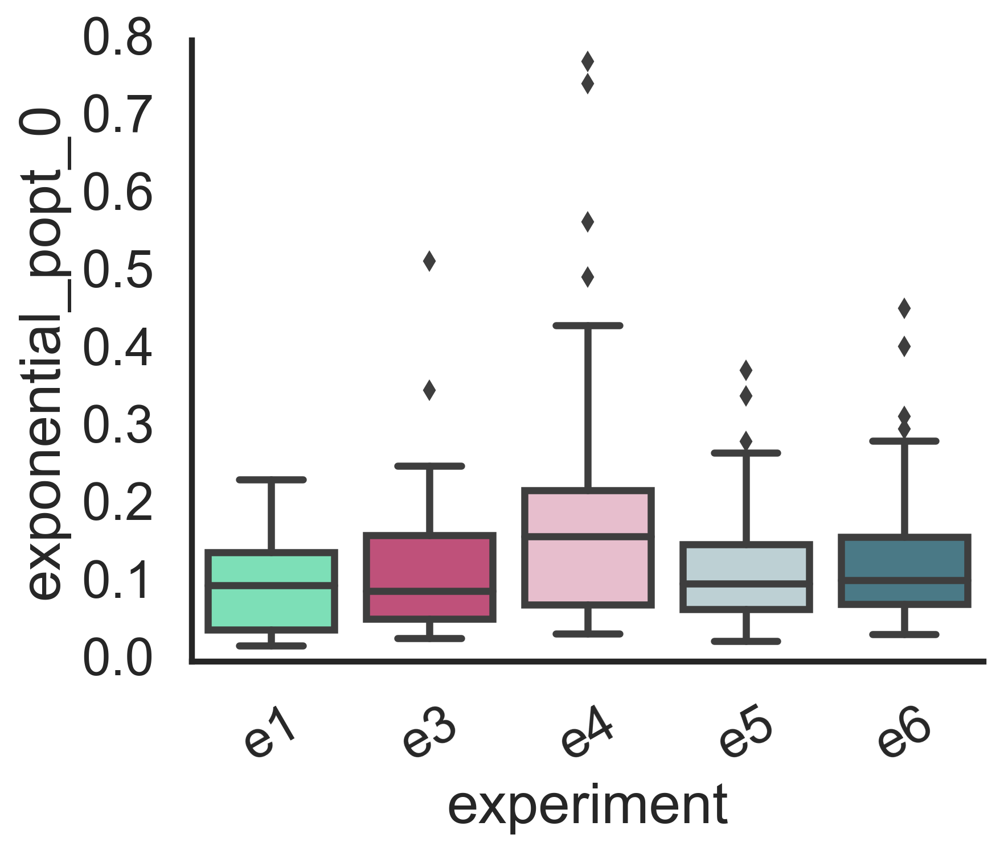

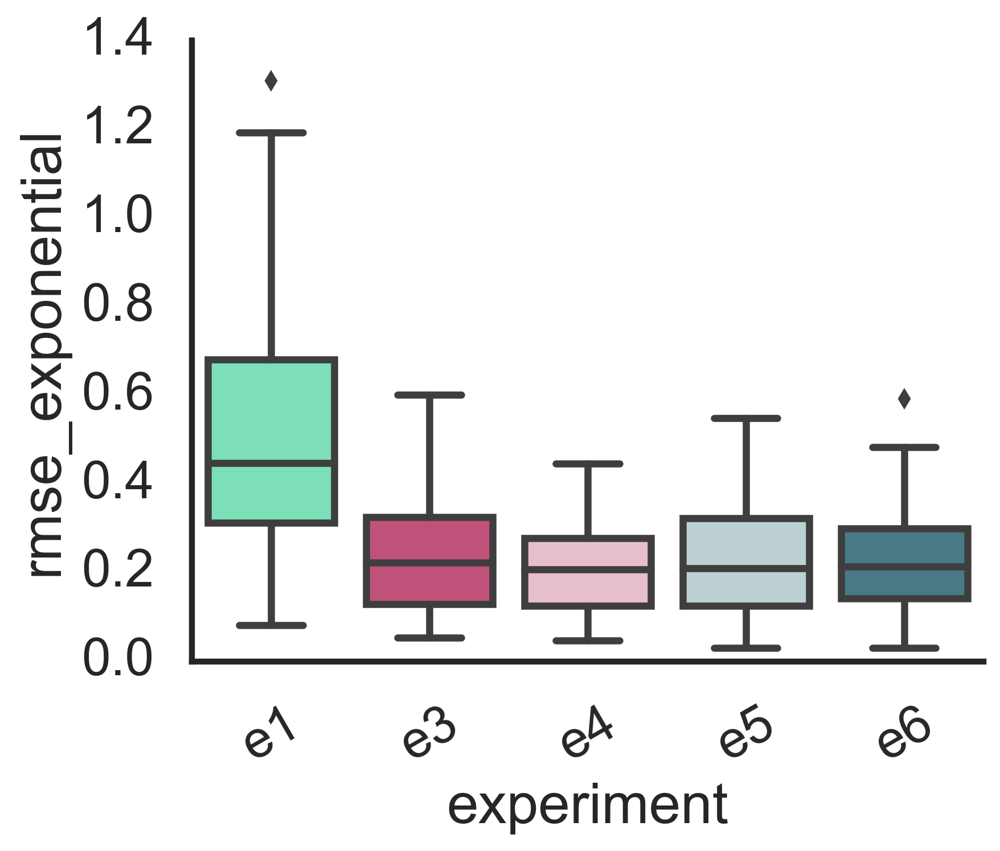

In [72]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                x='experiment', 
                y=i, kind='box',
                #col='culture',
           order=eorder, palette=epallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


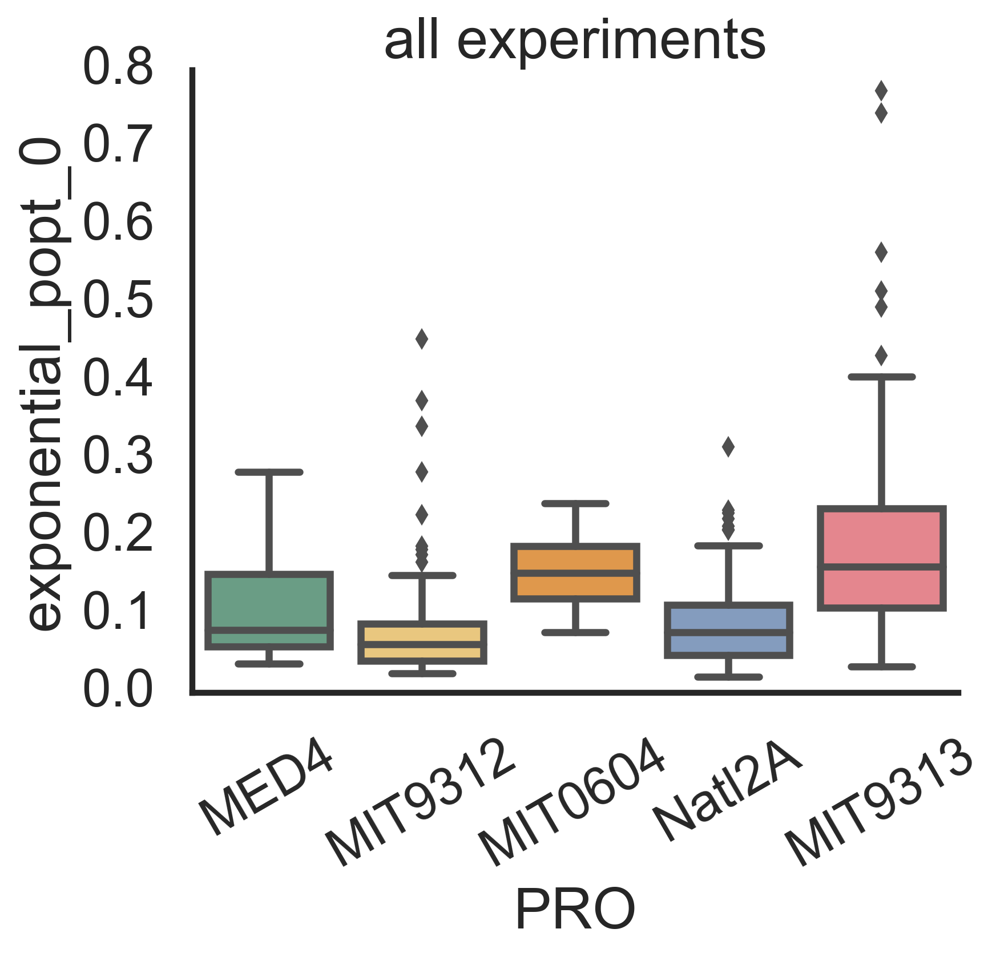

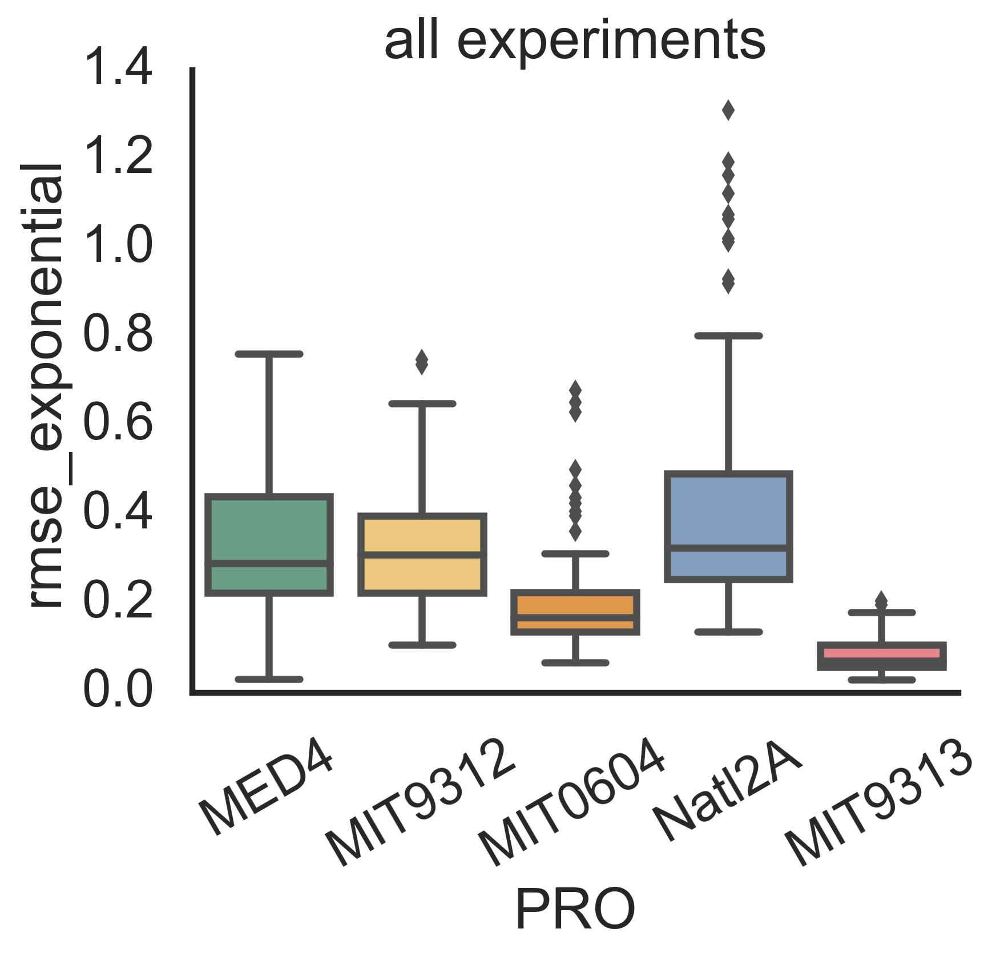

In [73]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                x='PRO', 
                y=i, kind='box',
                #col='culture',
           order=porder, palette=ppallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    plt.title('all experiments')


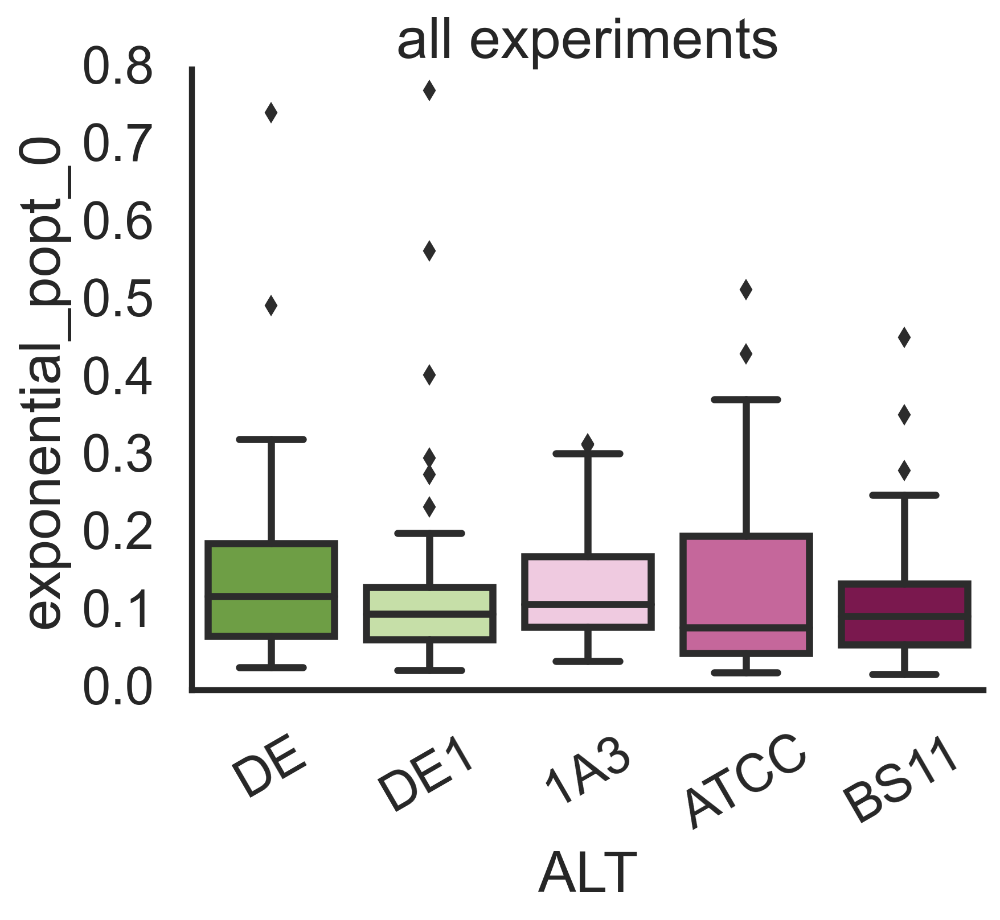

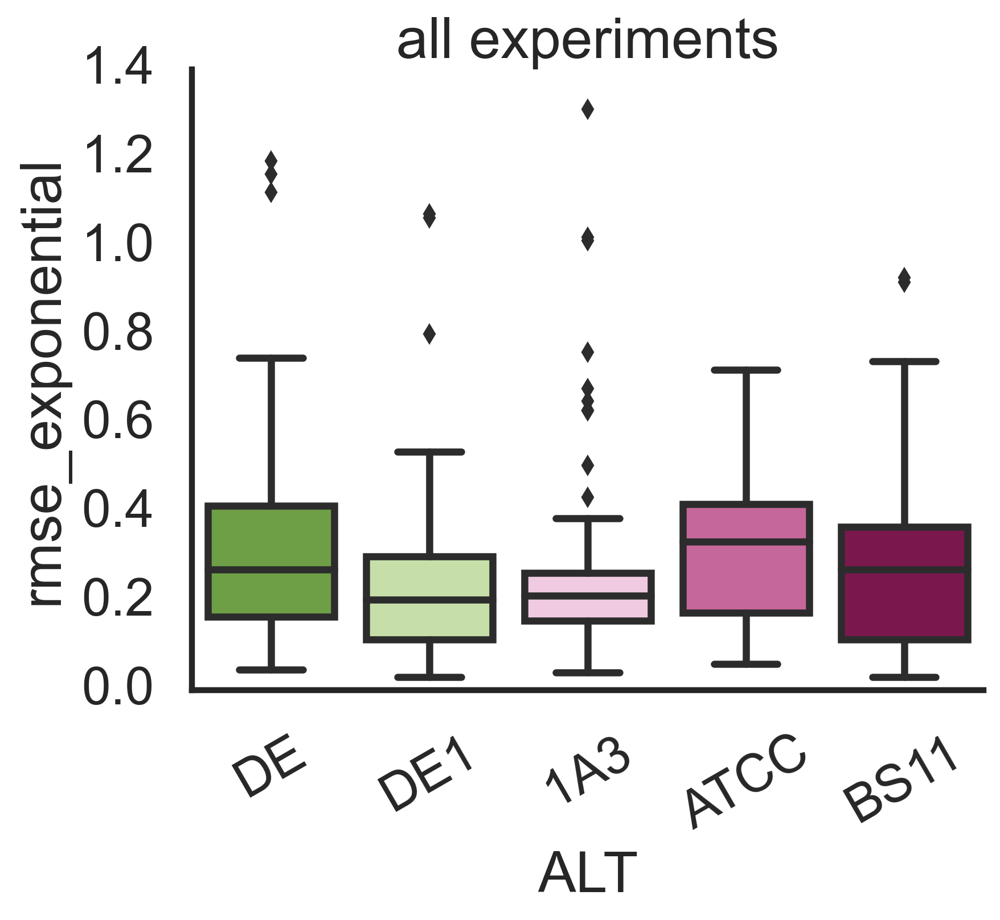

In [74]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                x='ALT', 
                y=i, kind='box',
                #col='culture',
           order=aorder, palette=apallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)
    plt.title('all experiments')


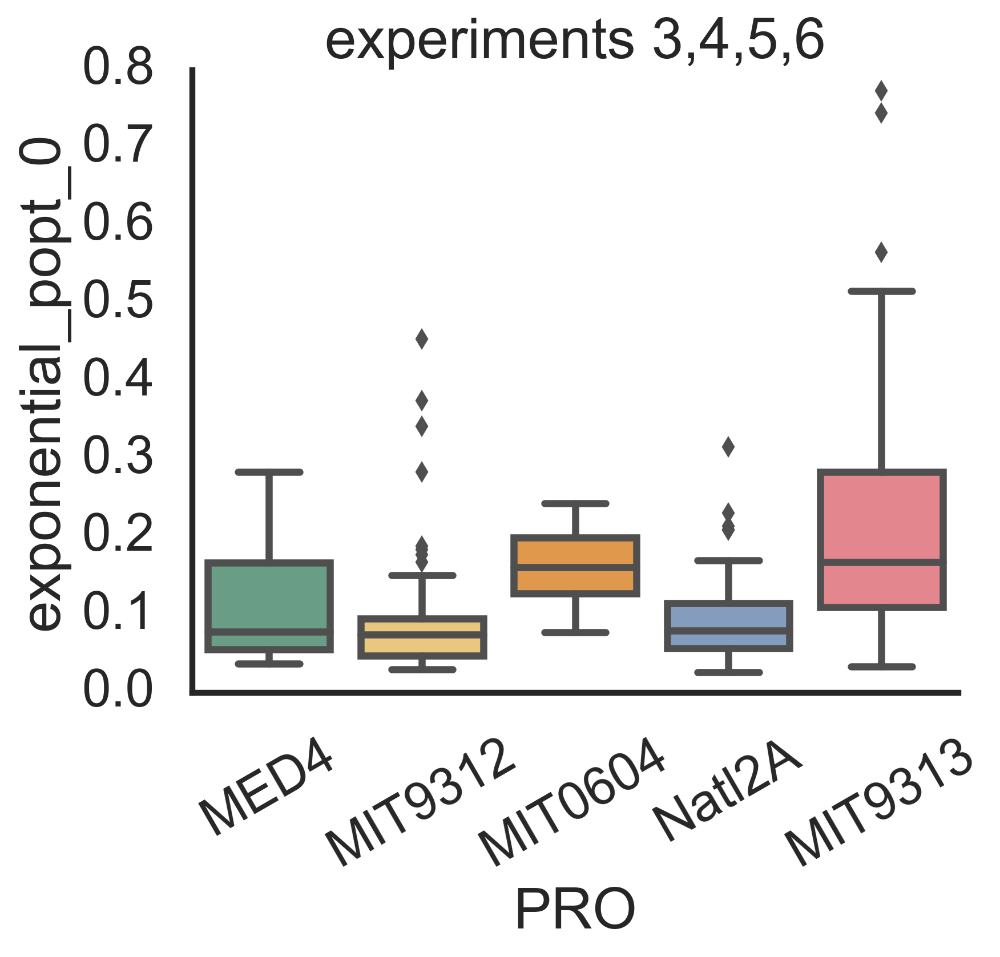

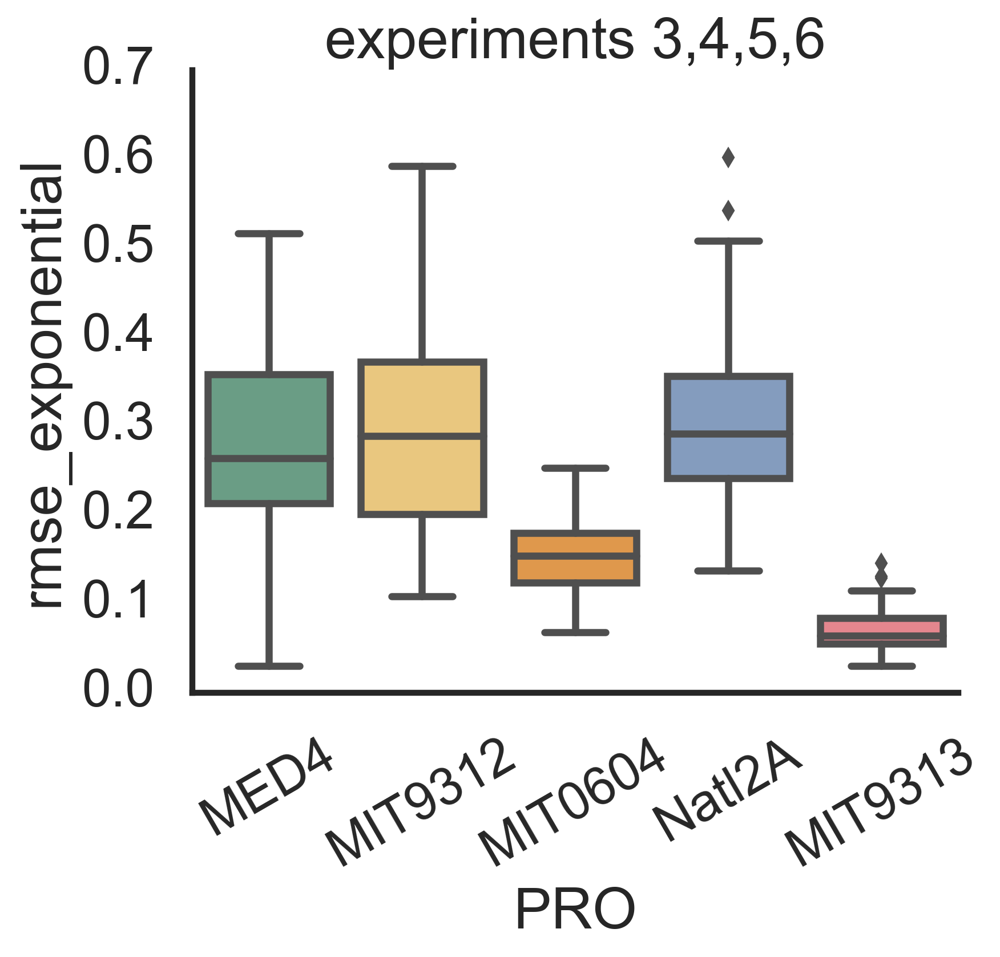

In [75]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & (~dfscore.experiment.isin(['e1'])) ], 
                x='PRO', 
                y=i, kind='box',
                #col='culture',
           order=porder, palette=ppallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    plt.title('experiments 3,4,5,6')


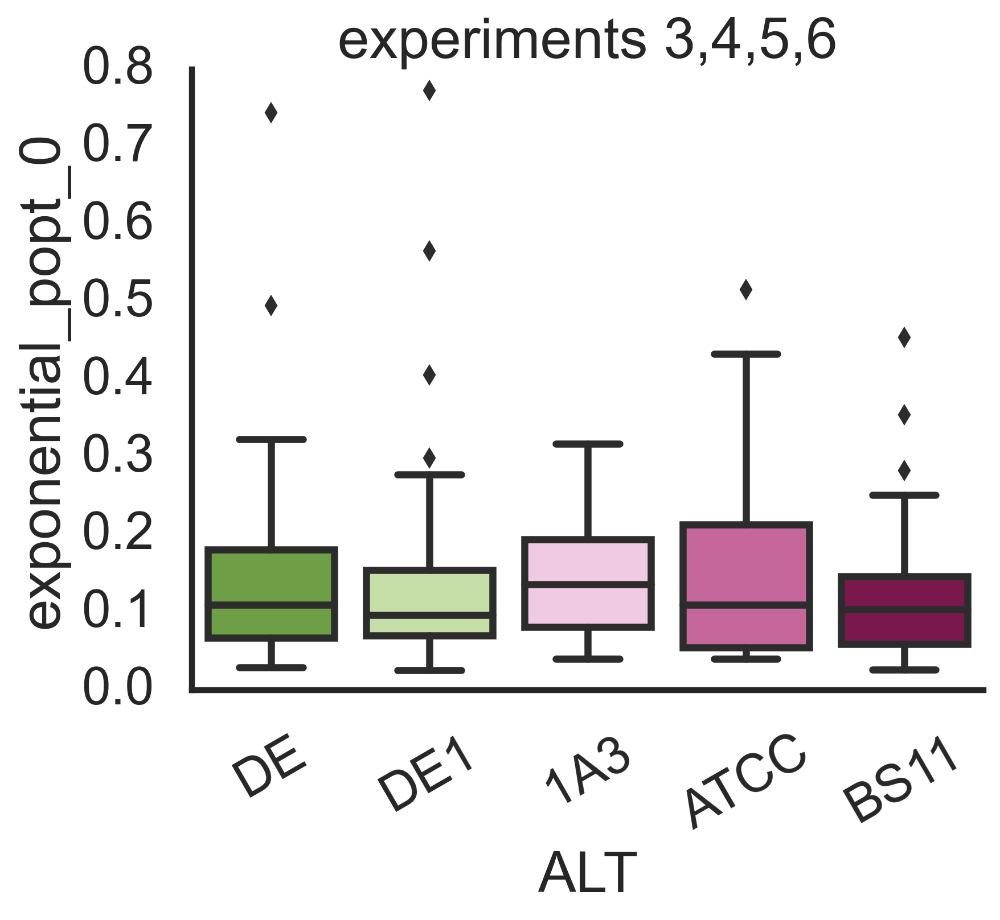

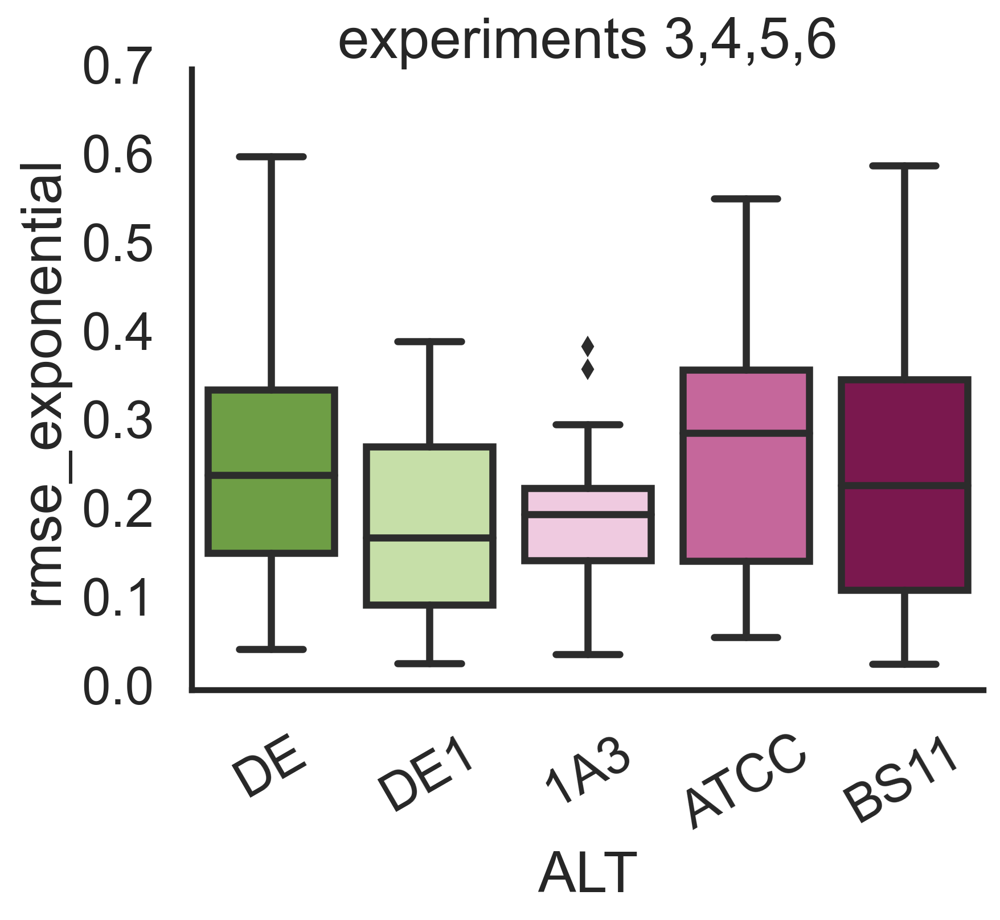

In [76]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & (~dfscore.experiment.isin(['e1'])) ], 
                x='ALT', 
                y=i, kind='box',
                #col='culture',
           order=aorder, palette=apallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)
    plt.title('experiments 3,4,5,6')


In [77]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('exponential_popt_0 ~ C(PRO)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of PRO strain')
pair_t = mod.t_test_pairwise("C(PRO)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of PRO strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:     exponential_popt_0   R-squared:                       0.358
Model:                            OLS   Adj. R-squared:                  0.321
Method:                 Least Squares   F-statistic:                     9.492
Date:                Wed, 25 Nov 2020   Prob (F-statistic):           3.71e-06
Time:                        21:23:36   Log-Likelihood:                 115.65
No. Observations:                  73   AIC:                            -221.3
Df Residuals:                      68   BIC:                            -209.8
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept             0.0920      0.01

In [78]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('exponential_popt_0 ~ C(ALT)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of ALT strain')
pair_t = mod.t_test_pairwise("C(ALT)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of ALT strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:     exponential_popt_0   R-squared:                       0.125
Model:                            OLS   Adj. R-squared:                  0.074
Method:                 Least Squares   F-statistic:                     2.431
Date:                Wed, 25 Nov 2020   Prob (F-statistic):             0.0558
Time:                        21:23:36   Log-Likelihood:                 104.33
No. Observations:                  73   AIC:                            -198.7
Df Residuals:                      68   BIC:                            -187.2
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          0.0998      0.016      6.

In [79]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('rmse_exponential ~ C(PRO)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of PRO strain')
pair_t = mod.t_test_pairwise("C(PRO)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of PRO strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:       rmse_exponential   R-squared:                       0.806
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     70.70
Date:                Wed, 25 Nov 2020   Prob (F-statistic):           1.69e-23
Time:                        21:23:36   Log-Likelihood:                 44.745
No. Observations:                  73   AIC:                            -79.49
Df Residuals:                      68   BIC:                            -68.04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept             0.5465      0.03

In [80]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('rmse_exponential ~ C(ALT)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of ALT strain')
pair_t = mod.t_test_pairwise("C(ALT)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of ALT strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:       rmse_exponential   R-squared:                       0.061
Model:                            OLS   Adj. R-squared:                  0.005
Method:                 Least Squares   F-statistic:                     1.096
Date:                Wed, 25 Nov 2020   Prob (F-statistic):              0.366
Time:                        21:23:36   Log-Likelihood:                -12.859
No. Observations:                  73   AIC:                             35.72
Df Residuals:                      68   BIC:                             47.17
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          0.5887      0.077      7.

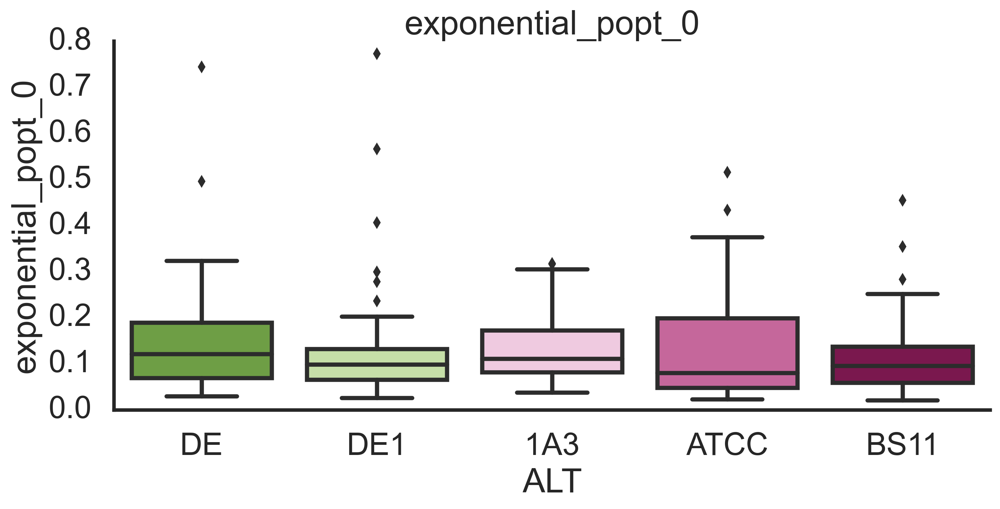

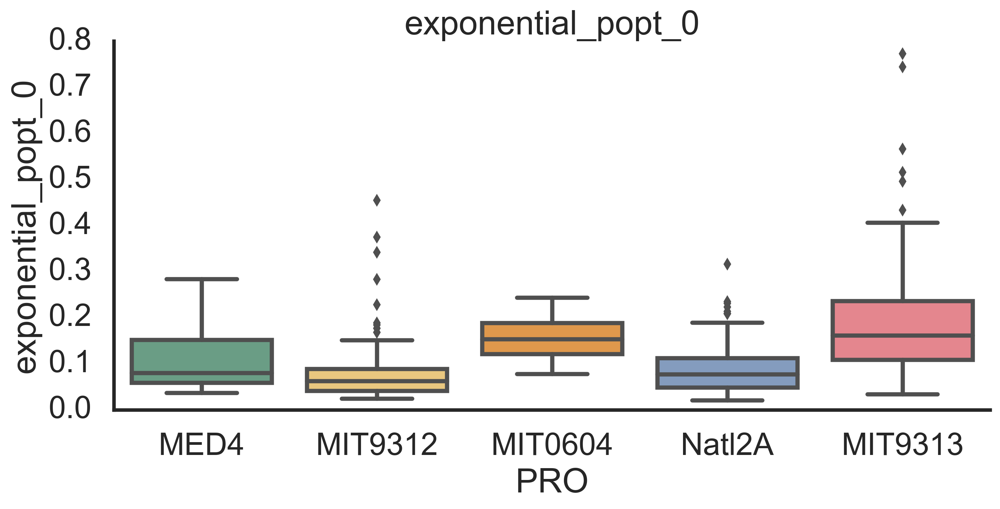

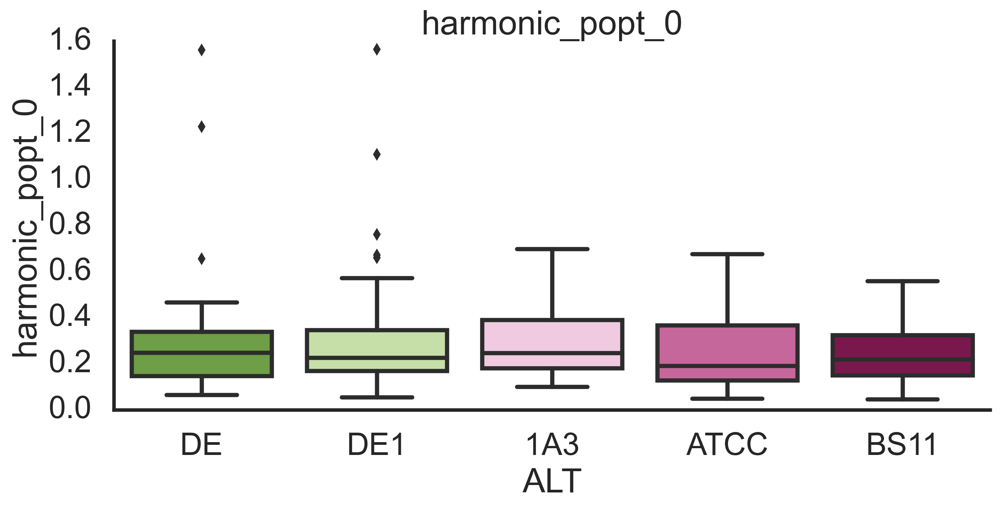

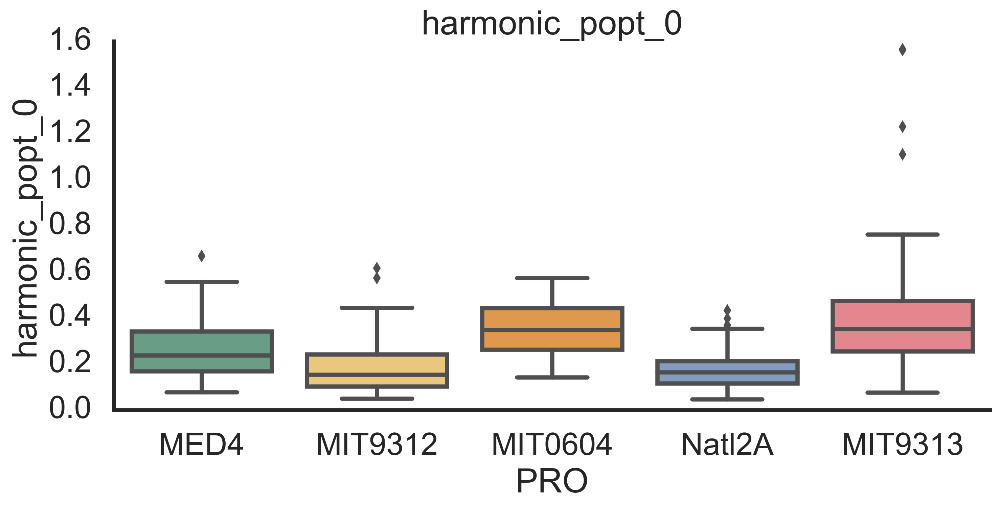

In [81]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0',  'harmonic_popt_0']:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])], 
                x='ALT', y=i, kind='box',
                #hue='culture',
           order=aorder, palette=apallete,
                aspect=2,
           )
    plt.title(i)

    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])], 
                x='PRO', y=i, kind='box',
                #hue='culture',
           order=porder, palette=ppallete,
                aspect=2,
           )
    plt.title(i)
    

(0.0, 0.6)

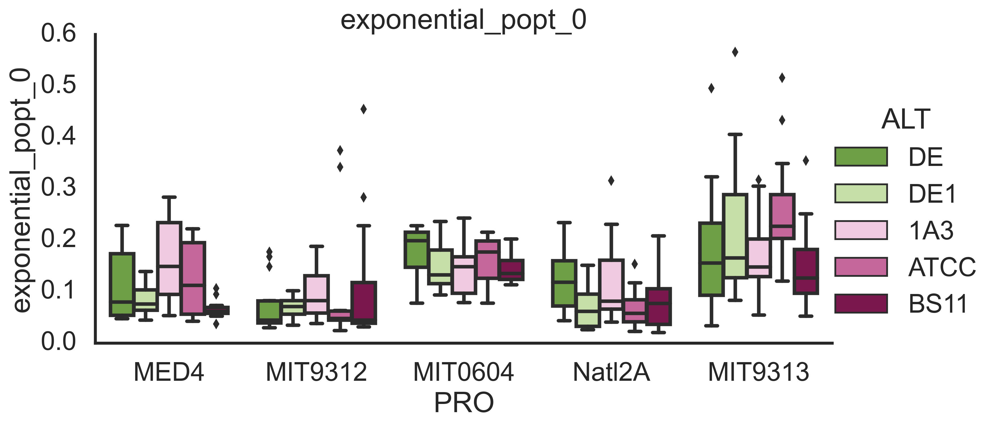

In [82]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0']:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])], 
                x='PRO', y=i, kind='box', hue='ALT',
                #hue='culture',
           hue_order=aorder, palette=apallete,
                order=porder,
                aspect=2,
           )
    plt.title(i)
plt.ylim(0,0.6)

In [83]:
best_model_df.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'model', 'RMSE', 's', 'e', 'p'],
      dtype='object')

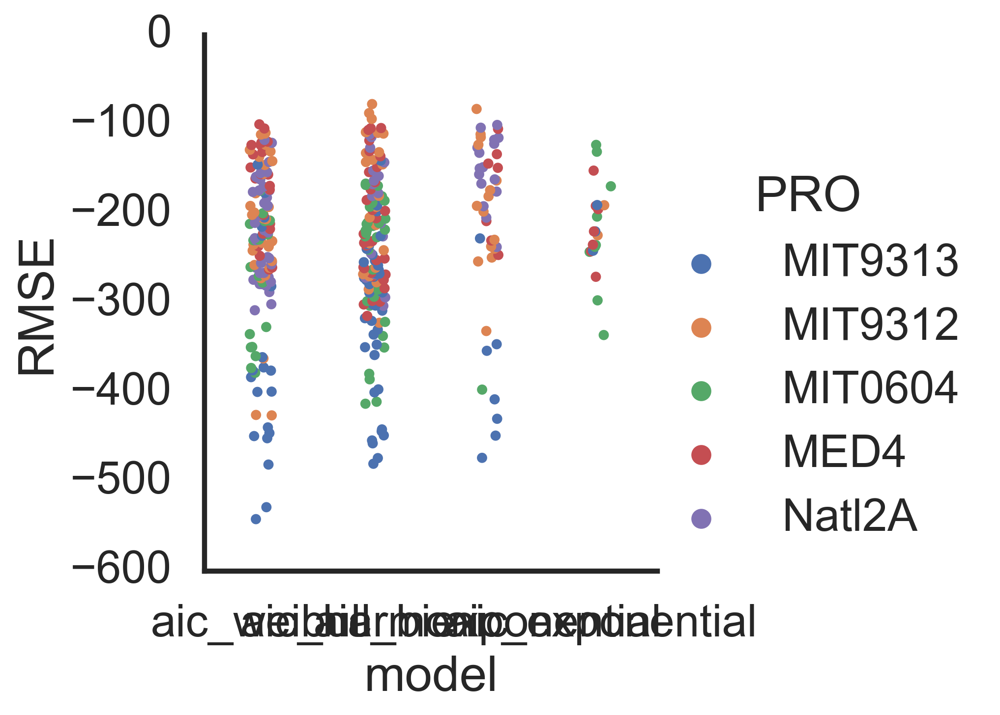

In [84]:
sns.catplot(data=best_model_df, x='model', y='RMSE', hue='PRO')

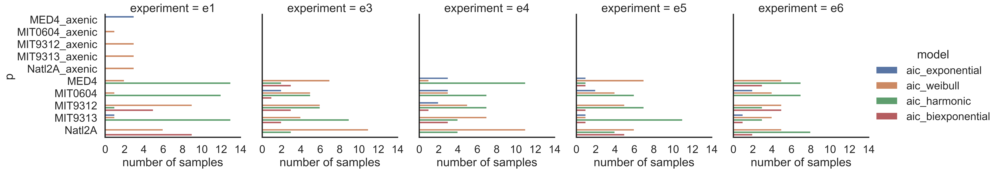

In [85]:
df_best_count = best_model_df.groupby(['culture','p', 'experiment',  'model'])['sample'].count().reset_index()
#df_best_count.model =df_best_count.model.map({'bic_exponential': 'exponential', 'bic_harmonic': 'harmonic'})
df_best_count.rename(columns={'sample': 'number of samples'}, inplace=True)

sns.catplot(data=df_best_count,y='p', hue='model', x='number of samples', #row='culture',
            col='experiment', kind='bar')

In [86]:
dfdecline.head()

,experiment_sample,day,FL,experiment,sample,PRO,ALT,culture,exponential,exponential_popt_0,...,harmonic,harmonic_popt_0,harmonic_popt_1,harmonic_popt_2,harmonic_popt_3,weibull,weibull_popt_0,weibull_popt_1,weibull_popt_2,weibull_popt_3
0,"e1, 10A",0.000000,5.621,e1,10A,MIT0604,DE,Co_Culture,5.621000,0.141021,...,5.621000,0.296513,0.5,0.5,0.5,5.621000,0.896868,0.5,0.259722,0.5
1,"e1, 10A",0.893056,4.045,e1,10A,MIT0604,DE,Co_Culture,4.955857,0.141021,...,4.444171,0.296513,0.5,0.5,0.5,2.352798,0.896868,0.5,0.259722,0.5
2,"e1, 10A",1.991667,2.749,e1,10A,MIT0604,DE,Co_Culture,4.244581,0.141021,...,3.533985,0.296513,0.5,0.5,0.5,1.923026,0.896868,0.5,0.259722,0.5
3,"e1, 10A",4.697222,2.924,e1,10A,MIT0604,DE,Co_Culture,2.898240,0.141021,...,2.349141,0.296513,0.5,0.5,0.5,1.471309,0.896868,0.5,0.259722,0.5
4,"e1, 10A",5.700000,2.519,e1,10A,MIT0604,DE,Co_Culture,2.516052,0.141021,...,2.089493,0.296513,0.5,0.5,0.5,1.373101,0.896868,0.5,0.259722,0.5


In [87]:
dfdecline['exponential_error'] = dfdecline['FL'] - dfdecline['exponential']
dfdecline['harmonic_error'] = dfdecline['FL'] - dfdecline['harmonic']
dfdecline['biexponential_error'] = dfdecline['FL'] - dfdecline['harmonic']


In [88]:
value_vars = [ 'FL'] + models
# 'exponential_error','biexponential_error','harmonic_error',
id_vars = ['experiment_sample', 'day',  'experiment', 'sample', 'PRO', 'ALT',
       'culture', ]      
dfresm = dfdecline.melt(value_vars=value_vars, id_vars=id_vars )

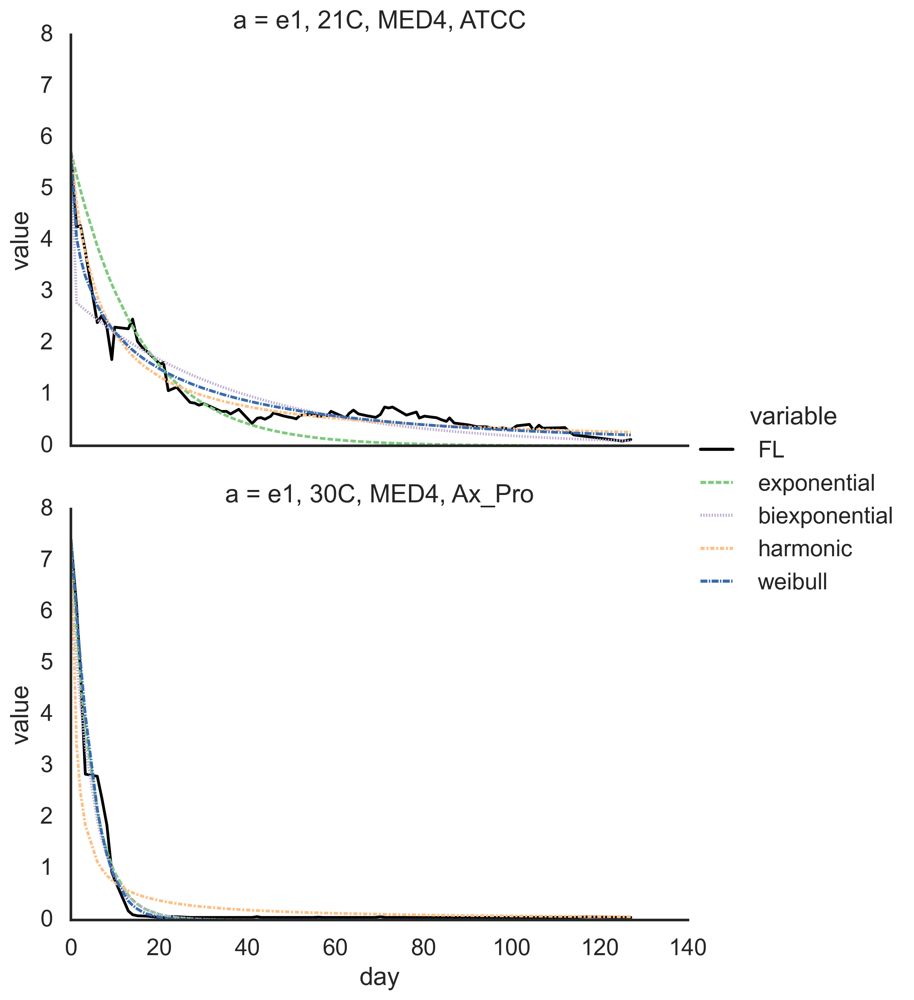

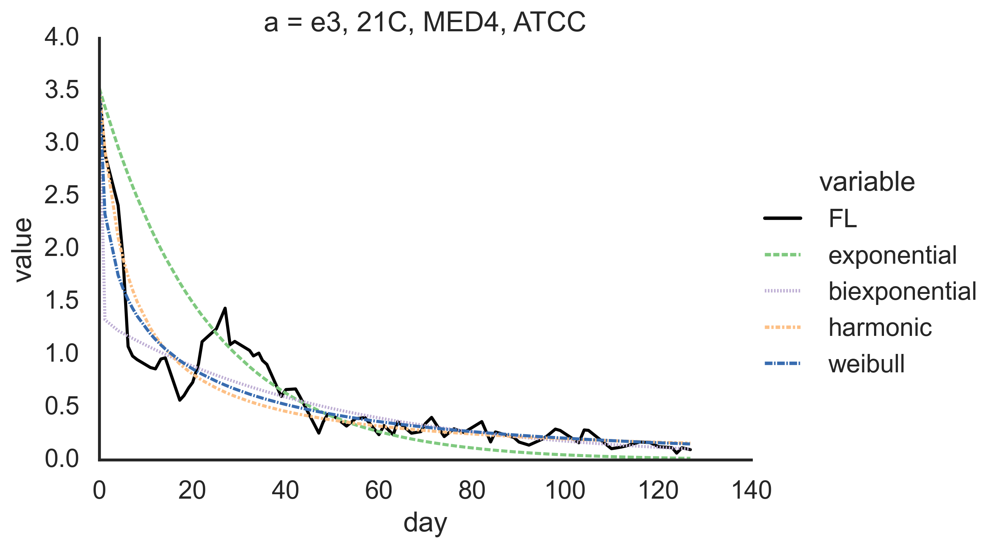

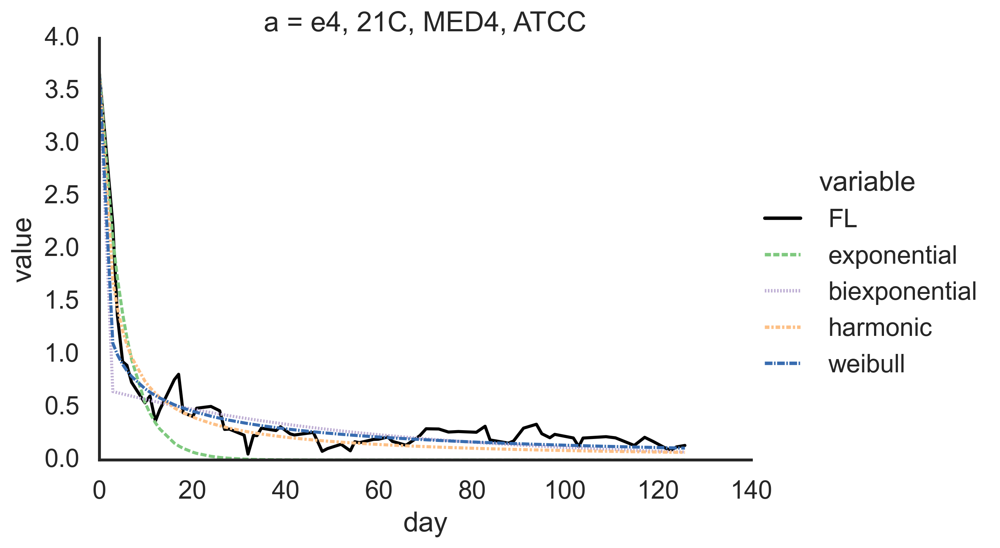

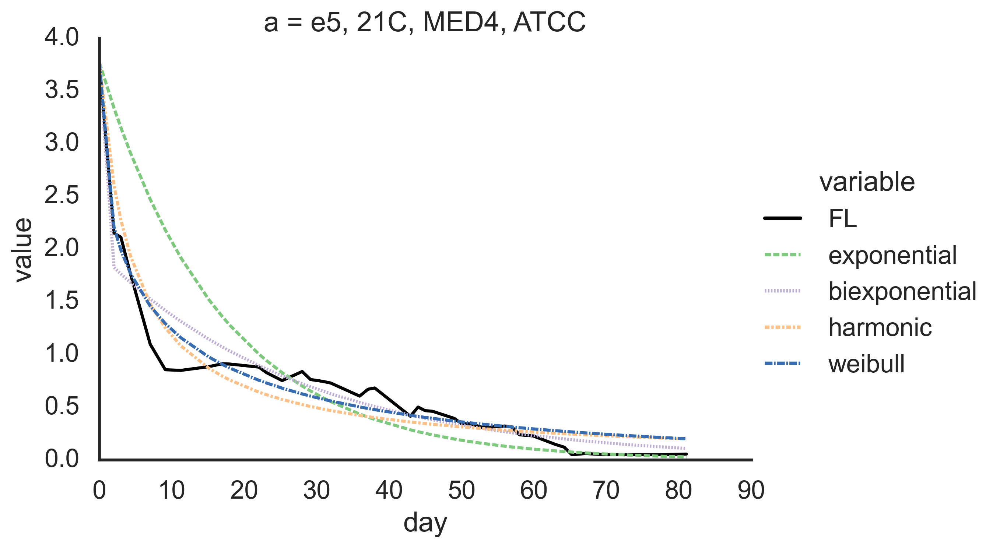

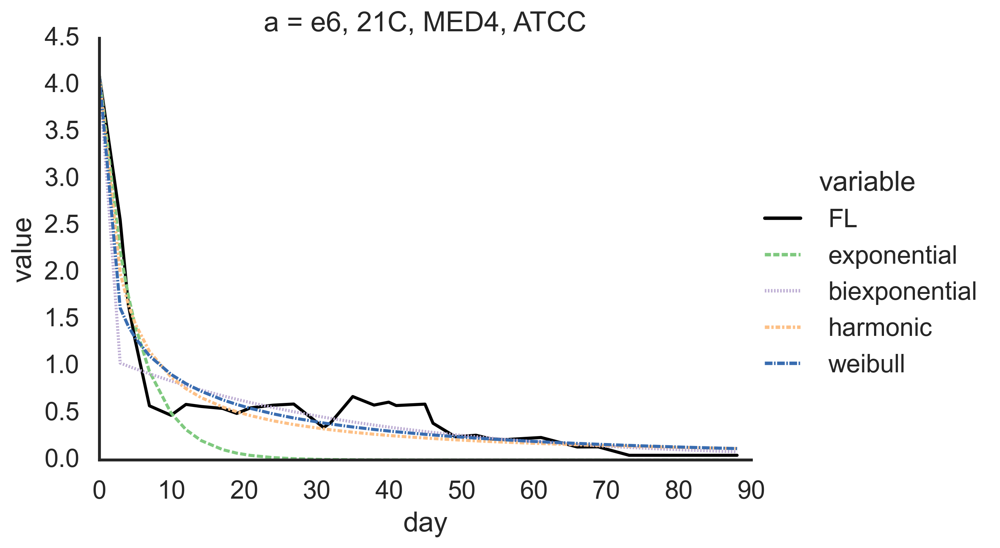

In [89]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

for p in ['Natl2A']:
    for e in eorder: #['e1']:
        sns.relplot(data=dfresm.loc[(dfresm.experiment == e) & #(dfresm.PRO == p) &
                                   (dfresm['sample'].isin(['21C', '30C']))], 
                x='day',
                y='value',
                hue='variable',
                style='variable',
                    
                row='a',
                #col_wrap=6,
                kind='line',
                    lw=2,
                    aspect=1.4,
                    palette=['black'] + mpalette,
               )
        #plt.suptitle(f'fitting, experiment MED4 - axenic vs coculture', y=1.05)
        plt.show()

In [90]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

for a in ['Ax_Pro']:
    for e in ['e1']:
        sns.relplot(data=dfresm.loc[(dfresm.experiment == e) & (dfresm.ALT.isin(aorder + ['Ax_Pro'])) &
                                    (dfresm['sample'].str.endswith('C'))
                                   #(dfresm['sample'].isin(['21C', '30C']))
                                   ], 
                x='day',
                y='value',
                hue='variable',
                col='PRO',
                    row='ALT',
                    row_order=aorder+ ['Ax_Pro'],
                    col_order=porder ,
                #col_wrap=5,
                kind='line',
                    aspect=1.4
               )
        plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
        plt.show()

In [91]:
best_model_df.loc[(best_model_df.experiment == 'e1') & (best_model_df.ALT.isin(['1A3'])) &
                            (best_model_df['sample'].str.endswith('B')) ]


,experiment_sample,experiment,sample,PRO,ALT,culture,model,RMSE,s,e,p
1484,"e1, 2B",e1,2B,MIT9313,1A3,Co_Culture,aic_exponential,-241.517903,"2B, 1A3","e1, Co_Culture",MIT9313
2558,"e1, 3B",e1,3B,MIT9312,1A3,Co_Culture,aic_weibull,-192.630996,"3B, 1A3","e1, Co_Culture",MIT9312
2208,"e1, 5B",e1,5B,MIT0604,1A3,Co_Culture,aic_harmonic,-180.630733,"5B, 1A3","e1, Co_Culture",MIT0604
2561,"e1, 4B",e1,4B,Natl2A,1A3,Co_Culture,aic_weibull,-120.776792,"4B, 1A3","e1, Co_Culture",Natl2A
2167,"e1, 1B",e1,1B,MED4,1A3,Co_Culture,aic_harmonic,-104.218271,"1B, 1A3","e1, Co_Culture",MED4


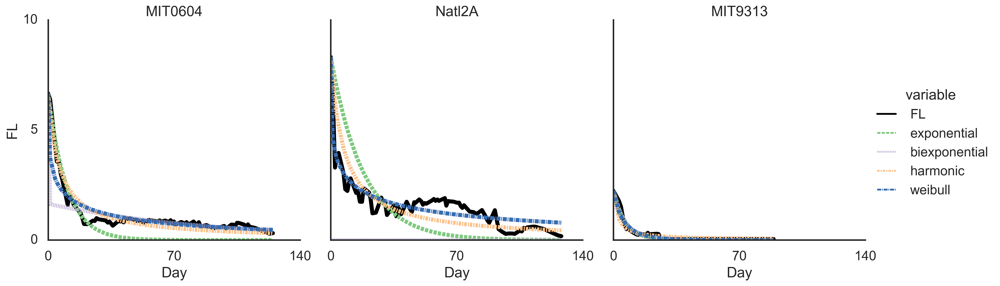

In [92]:
mpalette = sns.color_palette('Accent', n_colors=5).as_hex()
mpalette = mpalette[0:3] + [mpalette[4]]

sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) 
                            #(dfresm['variable'].isin(['FL', 'exponential', 'biexponential'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=['MIT0604', 'Natl2A', 'MIT9313'],
        col_wrap=3,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=5,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            palette=['black'] + mpalette,
            #col_wrap=3,
            #legend=False,
       ).set_axis_labels('Day','FL').set(yticks=[0,5,10], xticks=[0,70,140]).set_titles('{col_name}')# .set(font_scale=2)

#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()


# N0* exp(-at)
# N0*(f*exp(-a1*t) + (1-f)*exp(-a2*t))

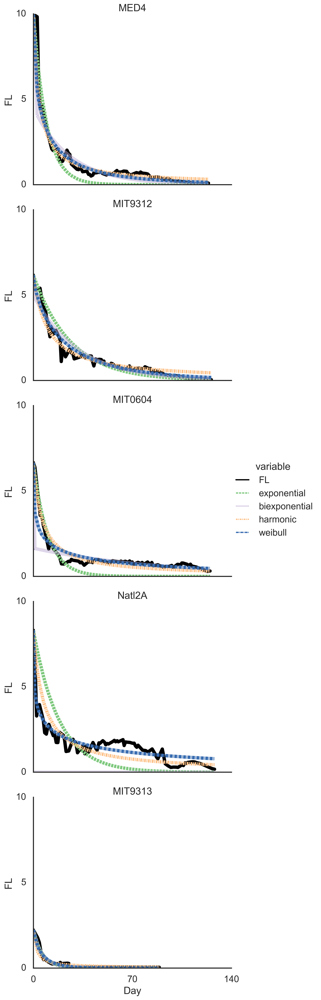

In [213]:
mpalette = sns.color_palette('Accent', n_colors=5).as_hex()
mpalette = mpalette[0:3] + [mpalette[4]]

sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) 
                            #(dfresm['variable'].isin(['FL', 'exponential', 'biexponential'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        row='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
           # col_order=['MIT0604', 'Natl2A', 'MIT9313'],
            row_order=porder,
        #col_wrap=3,
        kind='line',
            #facet_kws=dict(margin_titles=True),
            linewidth=6,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1.2,
            palette=['black'] + mpalette,
            #col_wrap=3,
            #legend=False,
       ).set_axis_labels('Day','FL').set(#yscale='log',ylim=(1e-2,10),
                                         yticks=[0,5,10],
                                         xticks=[0,70,140]).set_titles('{row_name}')# .set(font_scale=2)

#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
#plt.yscale('log')
plt.show()


# N0* exp(-at)
# N0*(f*exp(-a1*t) + (1-f)*exp(-a2*t))

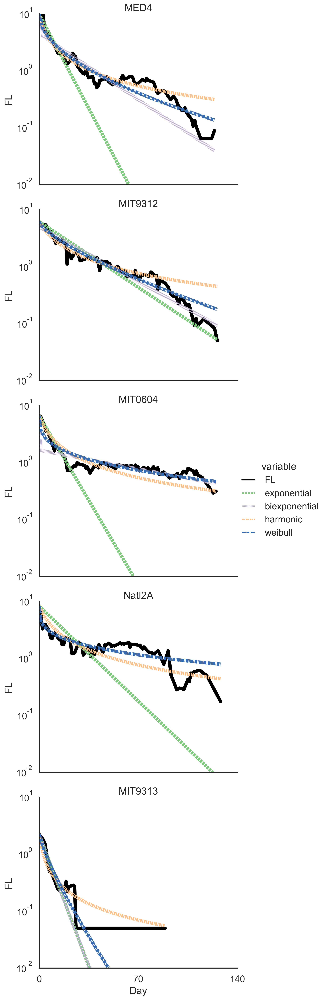

In [214]:
mpalette = sns.color_palette('Accent', n_colors=5).as_hex()
mpalette = mpalette[0:3] + [mpalette[4]]

sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) 
                            #(dfresm['variable'].isin(['FL', 'exponential', 'biexponential'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        row='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
           # col_order=['MIT0604', 'Natl2A', 'MIT9313'],
            row_order=porder,
        #col_wrap=3,
        kind='line',
            #facet_kws=dict(margin_titles=True),
            linewidth=6,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1.2,
            palette=['black'] + mpalette,
            #col_wrap=3,
            #legend=False,
       ).set_axis_labels('Day','FL').set(yscale='log',ylim=(1e-2,10),
                                         #yticks=[0,5,10],
                                         xticks=[0,70,140]).set_titles('{row_name}')# .set(font_scale=2)

#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
#plt.yscale('log')
plt.show()


# N0* exp(-at)
# N0*(f*exp(-a1*t) + (1-f)*exp(-a2*t))

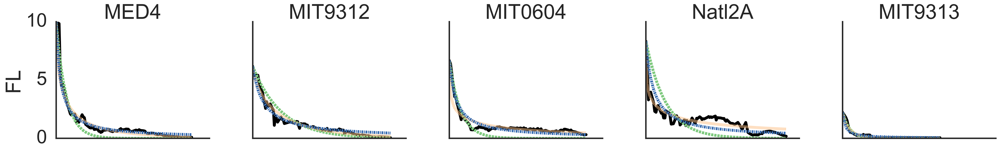

In [96]:
order_list = ['FL', 'exponential', 'weibull', 'harmonic']
sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            #facet_kws=dict(margin_titles=True),
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
            palette=['black', mpalette[0], mpalette[2], mpalette[3]] ,
            
            legend=False
       ).set_axis_labels('','FL').set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

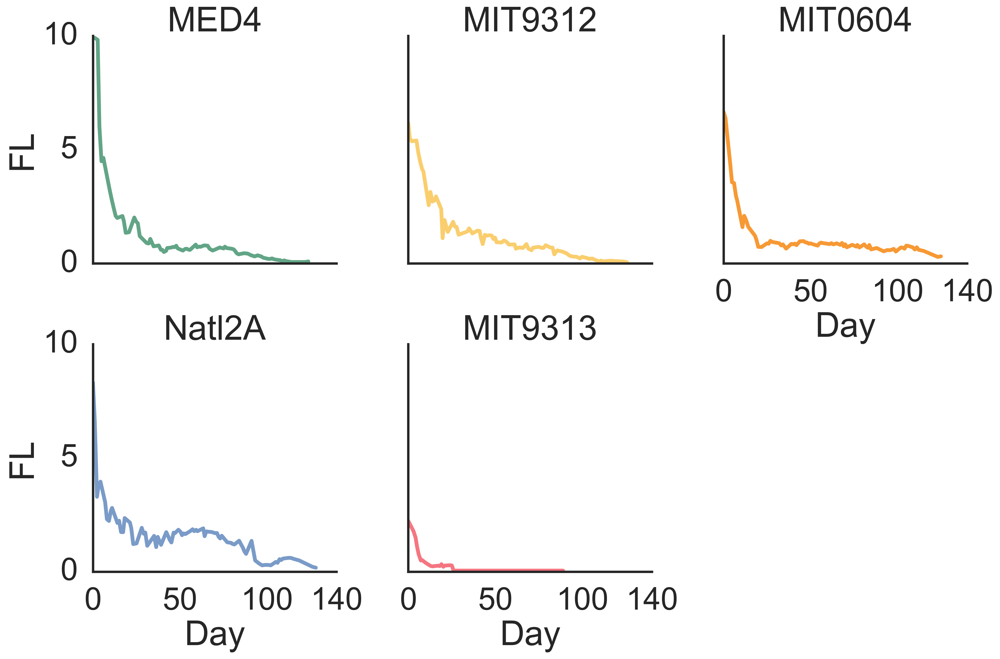

In [97]:
sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['FL'])) 
                           ], 
        x='day',
        y='value',
        #hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            col_wrap=3,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            #facet_kws=dict(margin_titles=True),
            linewidth=4,
            hue='PRO',
            hue_order=porder,
            #style_order=['FL','exponential'],
            aspect=1,
            palette=ppallete,
            #col_wrap=3,
            legend=False
       ).set_axis_labels('Day','FL').set(yticks=[0,5,10], xticks=[0,50,100,140]
                                     ).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [211]:
dfscore.nlargest(6
                 , 'weibull_td')[['experiment', 'sample', 'PRO', 'ALT', 
                                  'weibull_n', 'weibull_a',
        'weibull_td', 'weibull_td2','rmse_weibull',
        'aic_weibull',]]

,experiment,sample,PRO,ALT,weibull_n,weibull_a,weibull_td,weibull_td2,rmse_weibull,aic_weibull
85,e1,9C,Natl2A,DE,0.075386,1.073296,24964.529066,2.457603e+08,0.513756,-105.224985
84,e1,9B,Natl2A,DE,0.100899,1.001450,3834.077963,3.691072e+06,0.555443,-92.430177
14,e1,14C,Natl2A,DE1,0.150188,0.789420,1245.973194,1.258536e+05,0.409954,-142.240601
83,e1,9A,Natl2A,DE,0.177822,0.686907,899.866449,4.436616e+04,0.578551,-85.745474
45,e1,24A,Natl2A,ATCC,0.253673,0.428035,759.671511,1.167649e+04,0.406680,-145.354801
13,e1,14B,Natl2A,DE1,0.181048,0.707828,675.403076,3.106478e+04,0.368048,-159.924926


In [143]:
dfscore.nsmallest(10, 'weibull_td')

,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,exponential_popt_3,...,bic_weibull,aic_weibull,f,a1,a2,weibull_n,weibull_a,weibull_td6,p,weibull_td
161,"e4, 12A",e4,12A,MIT9313,DE1,Co_Culture,0.773035,1.0,1.0,1.0,...,-537.725790,-542.074565,0.052008,-0.000814,0.989148,0.006733,2.814410,4.268753e+102,MIT9313,1.128501e-13
124,"e3, 22C",e3,22C,MIT9313,ATCC,Co_Culture,0.515939,1.0,1.0,1.0,...,-285.483431,-289.980422,1.000000,0.524933,1.627847,1.939836,0.241334,8.056234e+00,MIT9313,3.198816e+00
220,"e4, 7C",e4,7C,MIT9313,DE,Co_Culture,0.744416,0.5,0.5,0.5,...,-339.942215,-344.321525,0.760759,0.588164,1.847351,0.868590,0.778912,2.740456e+01,MIT9313,3.482926e+00
218,"e4, 7A",e4,7A,MIT9313,DE,Co_Culture,0.495667,0.5,0.5,0.5,...,-367.849650,-372.228960,1.000000,0.494530,1.461600,1.763538,0.220034,1.045855e+01,MIT9313,3.786405e+00
205,"e4, 2C",e4,2C,MIT9313,1A3,Co_Culture,0.305405,0.5,0.5,0.5,...,-395.211614,-399.650630,1.000000,0.318557,1.052620,1.826402,0.121150,1.337465e+01,MIT9313,5.014476e+00
204,"e4, 2A",e4,2A,MIT9313,1A3,Co_Culture,0.317597,1.0,1.0,1.0,...,-394.886728,-399.296113,1.000000,0.298449,1.051371,1.825450,0.110131,1.411097e+01,MIT9313,5.287832e+00
219,"e4, 7B",e4,7B,MIT9313,DE,Co_Culture,0.323614,1.0,1.0,1.0,...,-371.384941,-375.794327,1.000000,0.335670,1.160413,1.787874,0.114509,1.459641e+01,MIT9313,5.358063e+00
162,"e4, 12B",e4,12B,MIT9313,DE1,Co_Culture,0.566138,1.0,1.0,1.0,...,-524.356051,-528.704825,0.079992,0.007737,1.152796,0.119108,1.883956,1.839826e+07,MIT9313,5.390676e+00
53,"e1, 28A",e1,28A,MIT9312,Ax_Pro,Axenic,0.310476,1.0,1.0,1.0,...,-421.163564,-425.927618,1.000000,0.410339,5.823296,3.348832,0.005822,1.018340e+01,MIT9312_Axenic,5.963866e+00
55,"e1, 28C",e1,28C,MIT9312,Ax_Pro,Axenic,0.311959,1.0,1.0,1.0,...,-357.352384,-362.116437,1.000000,0.310815,5.549816,1.858888,0.081955,1.577306e+01,MIT9312_Axenic,6.015959e+00


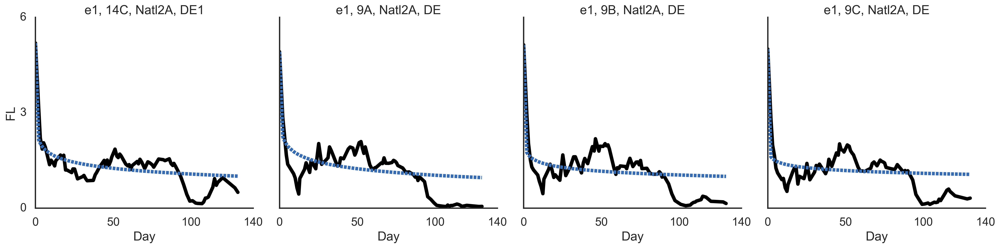

In [173]:
sample_list = ['e1, 9C', 'e1, 9B', 'e1, 14C', 'e1, 9A', 
               #'e4, 12A', 'e3, 22C'
              ]
order_list = ['FL', 'weibull',]
#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(sample_list) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='a',
            col_wrap=4,
            #col_order=porder,
        kind='line',
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            palette=['black', mpalette[3]] ,
            legend=False
       ).set_axis_labels('Day','FL').set(yticks=[0,3,6], xticks=[0,50, 100, 140]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

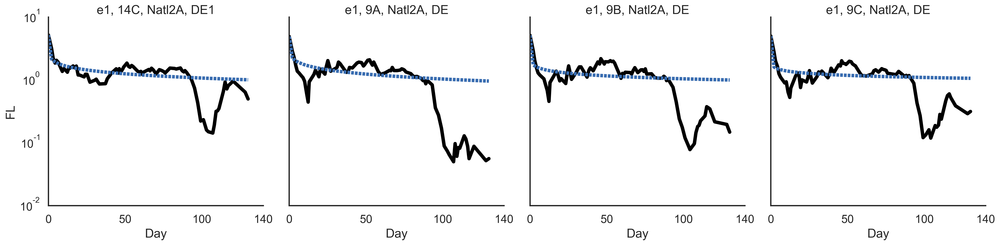

In [174]:
order_list = ['FL', 'weibull',]
#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(sample_list) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='a',
            col_wrap=4,
            #col_order=porder,
        kind='line',
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            palette=['black', mpalette[3]] ,
            legend=False
       ).set_axis_labels('Day','FL').set(#yticks=[0,3,6], 
    yscale='log',
    xticks=[0,50,100,140]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [99]:
models

['exponential', 'biexponential', 'harmonic', 'weibull']

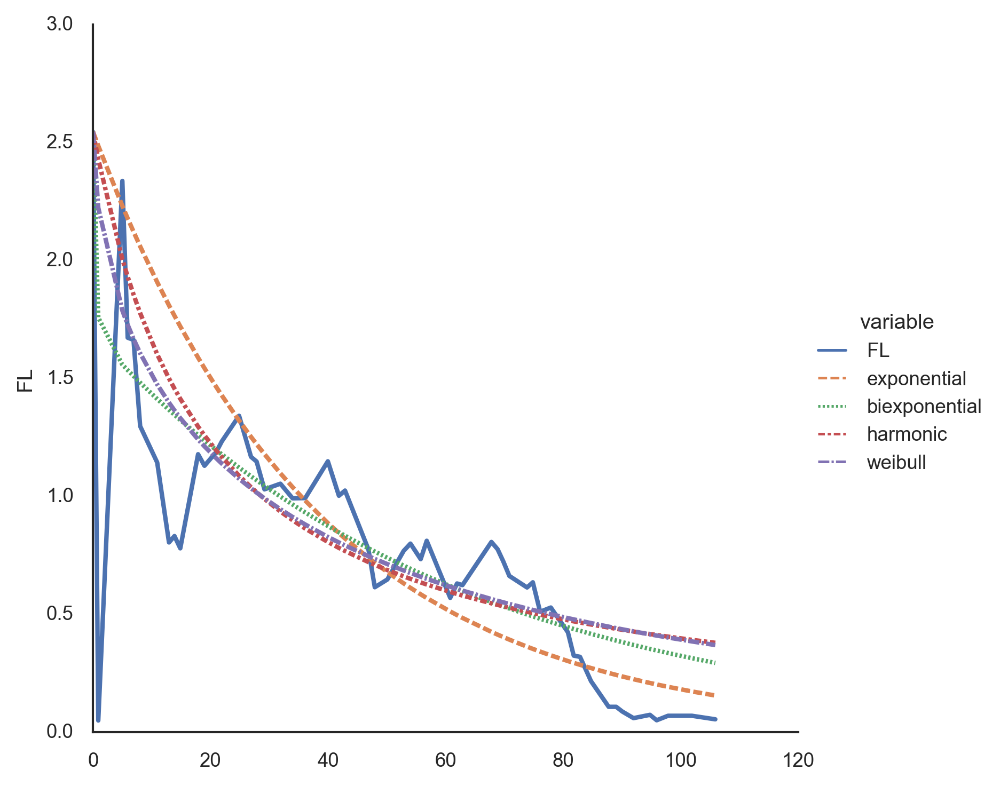

In [100]:
sns.set(style='white',context='paper')
sns.relplot(data=dfresm.loc[(dfresm.experiment_sample == 'e5, 19A')  #&
                            #(dfresm['variable'].isin(['FL', #'exponential', 'biexponential', 'harmonic',  
                            #                          'logistic', 'weibull'])) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        kind='line',
            linewidth=2,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            #aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
            #legend=False
       ).set_axis_labels('','FL') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [101]:
dfscore.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'exponential_popt_0', 'exponential_popt_1', 'exponential_popt_2',
       'exponential_popt_3', 'rmse_exponential', 'bic_exponential',
       'aic_exponential', 'biexponential_popt_0', 'biexponential_popt_1',
       'biexponential_popt_2', 'biexponential_popt_3', 'rmse_biexponential',
       'bic_biexponential', 'aic_biexponential', 'harmonic_popt_0',
       'harmonic_popt_1', 'harmonic_popt_2', 'harmonic_popt_3',
       'rmse_harmonic', 'bic_harmonic', 'aic_harmonic', 'weibull_popt_0',
       'weibull_popt_1', 'weibull_popt_2', 'weibull_popt_3', 'rmse_weibull',
       'bic_weibull', 'aic_weibull', 'f', 'a1', 'a2', 'weibull_n', 'weibull_a',
       'weibull_td6', 'p'],
      dtype='object')

Text(0.5, 1.0, 'Weibull n distribution (co-cultures)')

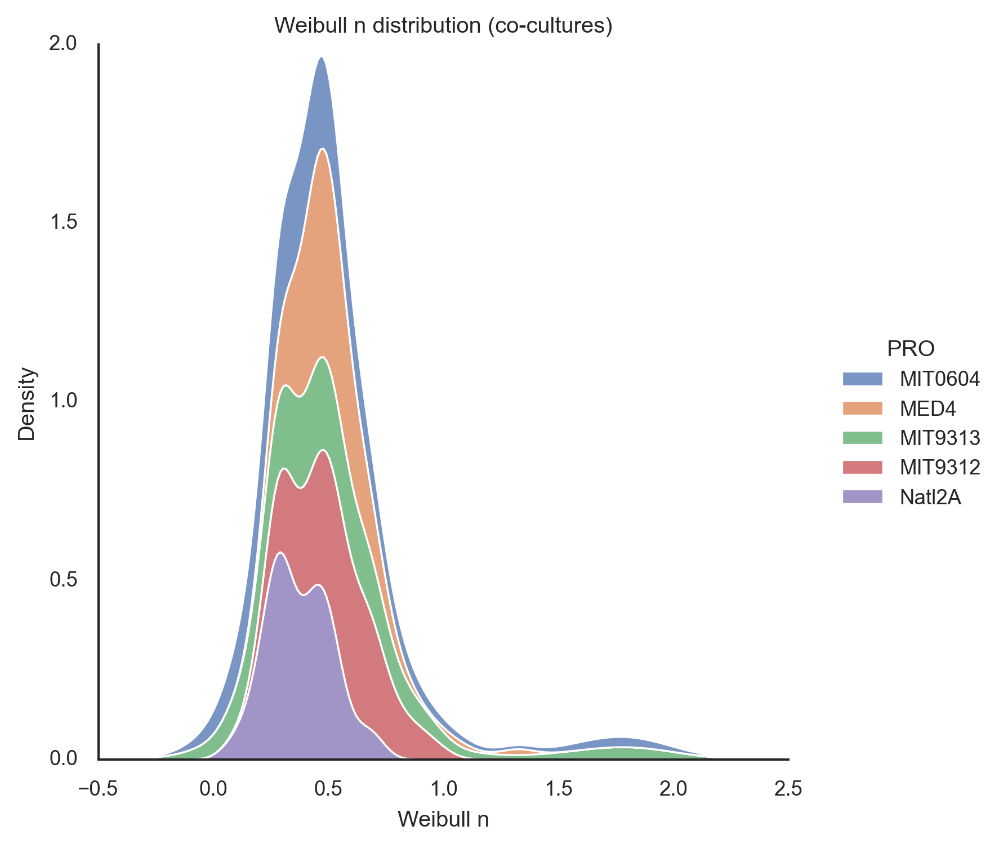

In [102]:
sns.displot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture'])]
            , x='weibull_popt_2', hue='PRO', #element="step",
             kind="kde", multiple='stack'
       ).set_axis_labels('Weibull n','Density') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.title('Weibull n distribution (co-cultures)')

C:\Users\wosnat\Anaconda3\lib\site-packages\seaborn\distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


Text(0.5, 1.0, 'Weibull n distribution (Axenic)')

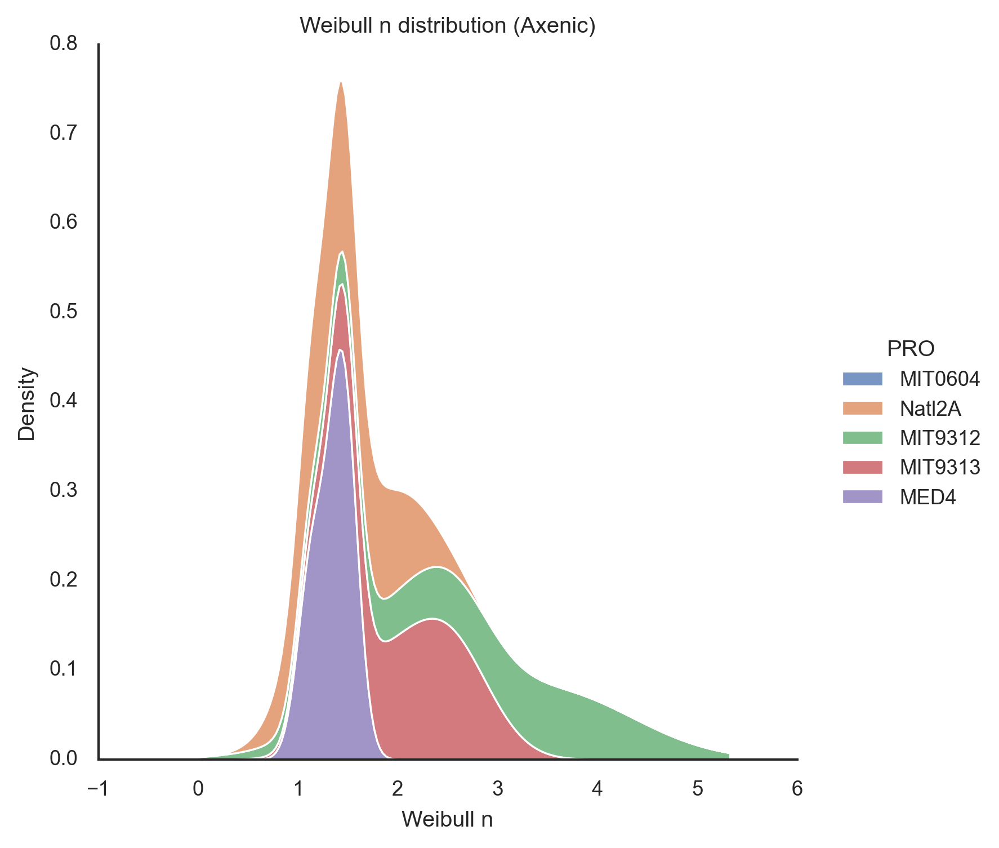

In [103]:
sns.displot(data = dfscore.loc[dfscore.culture.isin(['Axenic'])]
            , x='weibull_popt_2', hue='PRO', #element="step",
             kind="kde", multiple='stack'
       ).set_axis_labels('Weibull n','Density') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.title('Weibull n distribution (Axenic)')

Text(0.5, 1.0, 'Weibull n distribution (Axenic)')

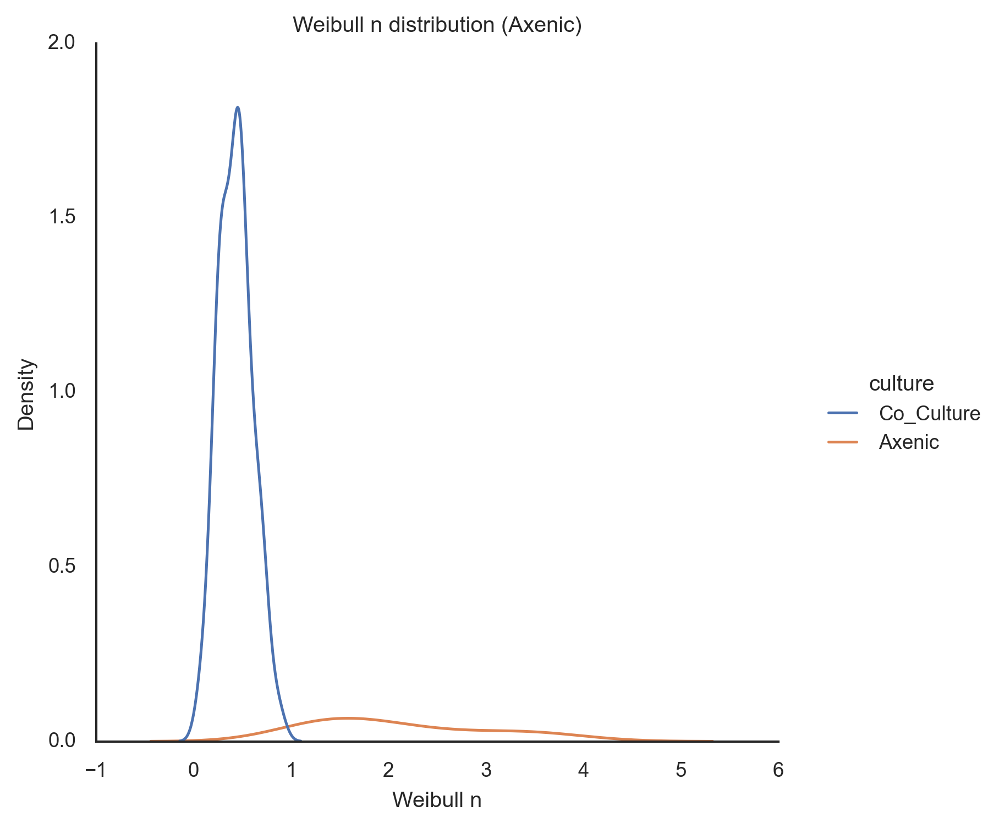

In [104]:
sns.displot(data = dfscore.loc[dfscore.experiment.isin(['e1'])]
            , x='weibull_popt_2', hue='culture', #element="step",
             kind="kde", #multiple='stack'
       ).set_axis_labels('Weibull n','Density') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.title('Weibull n distribution (Axenic)')

Text(0.5, 1.0, 'Weibull shape parameter n')

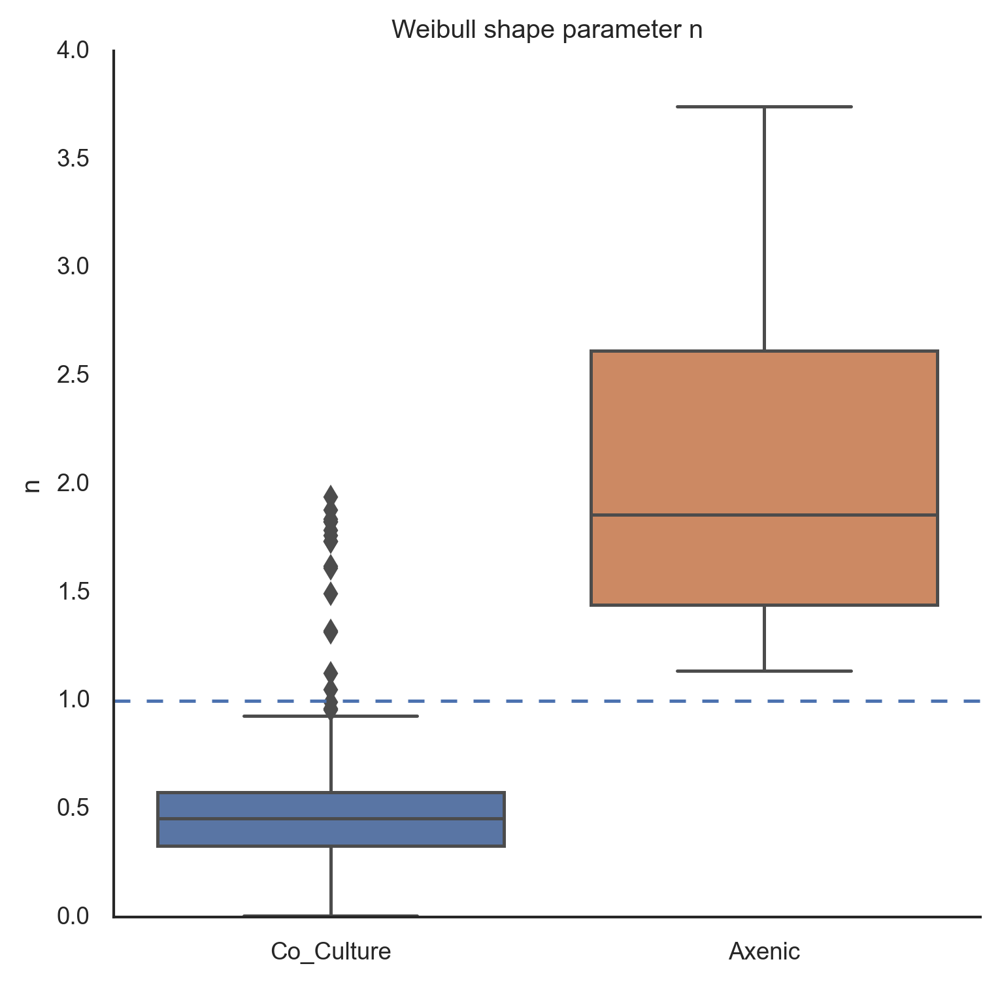

In [105]:
sns.catplot(data = dfscore
            , y='weibull_popt_2', x='culture', #element="step",
             kind="box", #multiple='stack'
       ).set_axis_labels('','n') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.axhline(1, ls='--')
plt.title('Weibull shape parameter n')

Text(0.5, 0.98, 'Weibull n')

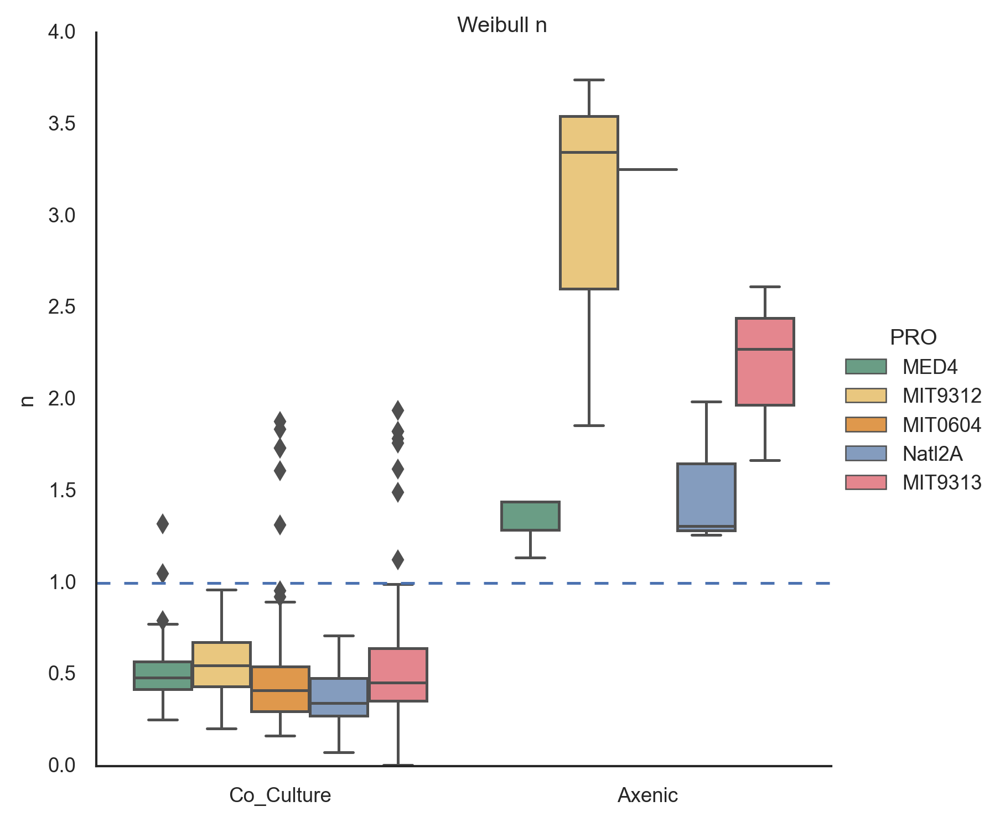

In [106]:
sns.catplot(data = dfscore
            , y='weibull_popt_2', x='culture', #element="step",
             kind="box", 
            hue='PRO', hue_order=porder, palette=ppallete,
            #col='experiment'

       ).set_axis_labels('','n') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.axhline(1, ls='--')
plt.suptitle('Weibull n')

Text(0.5, 0.98, 'Weibull n')

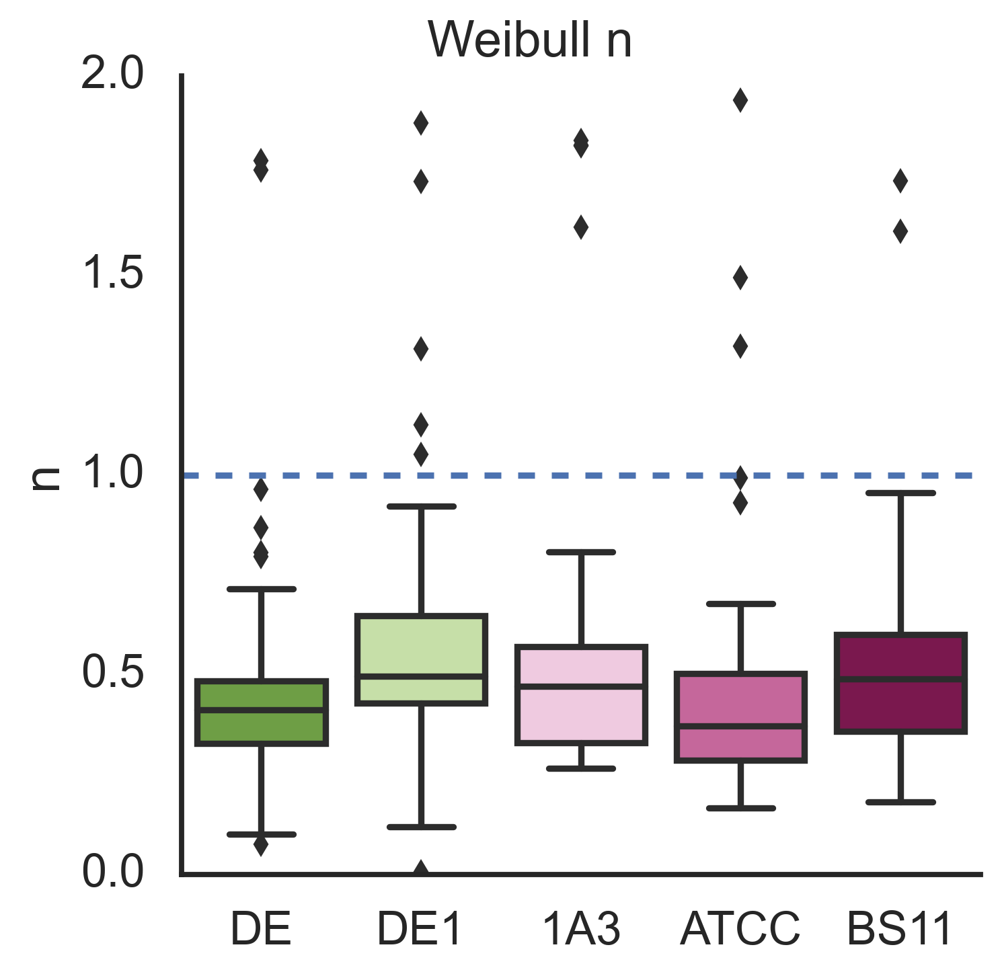

In [107]:
sns.set_context('talk')
sns.catplot(data = dfscore
            , y='weibull_popt_2', 
             kind="box", 
            x='ALT', order=aorder, palette=apallete,
            #col='experiment'

       ).set_axis_labels('','n') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.axhline(1, ls='--')
plt.suptitle('Weibull n')

Text(0.5, 0.98, 'Weibull n')

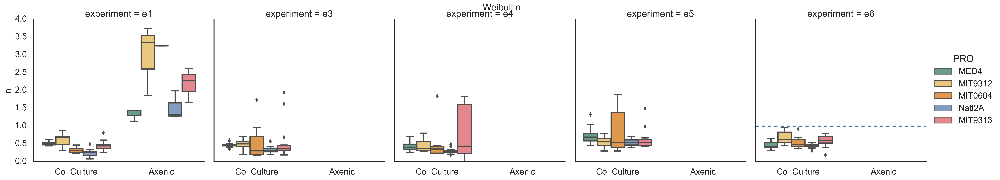

In [108]:
g=sns.catplot(data = dfscore
            , y='weibull_popt_2', x='culture', #element="step",
             kind="box", 
            hue='PRO', hue_order=porder, palette=ppallete,
            col='experiment'

       ).set_axis_labels('','n') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.axhline(1, ls='--')
plt.suptitle('Weibull n')

Text(0.5, 1.0, 'Weibull a')

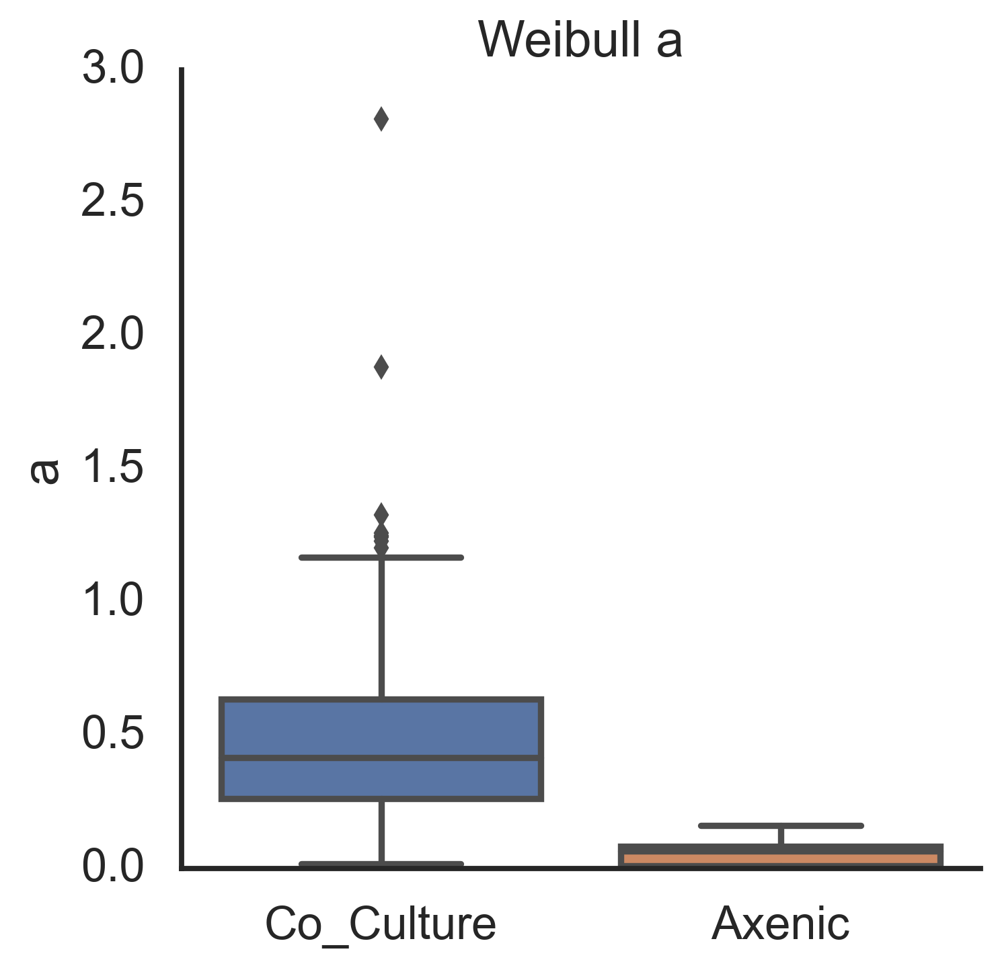

In [109]:
sns.catplot(data = dfscore
            , y='weibull_popt_0', x='culture', #element="step",
             kind="box", #multiple='stack'
       ).set_axis_labels('','a') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.axhline(1)
plt.title('Weibull a')

Text(0.5, 1.0, 'Weibull td')

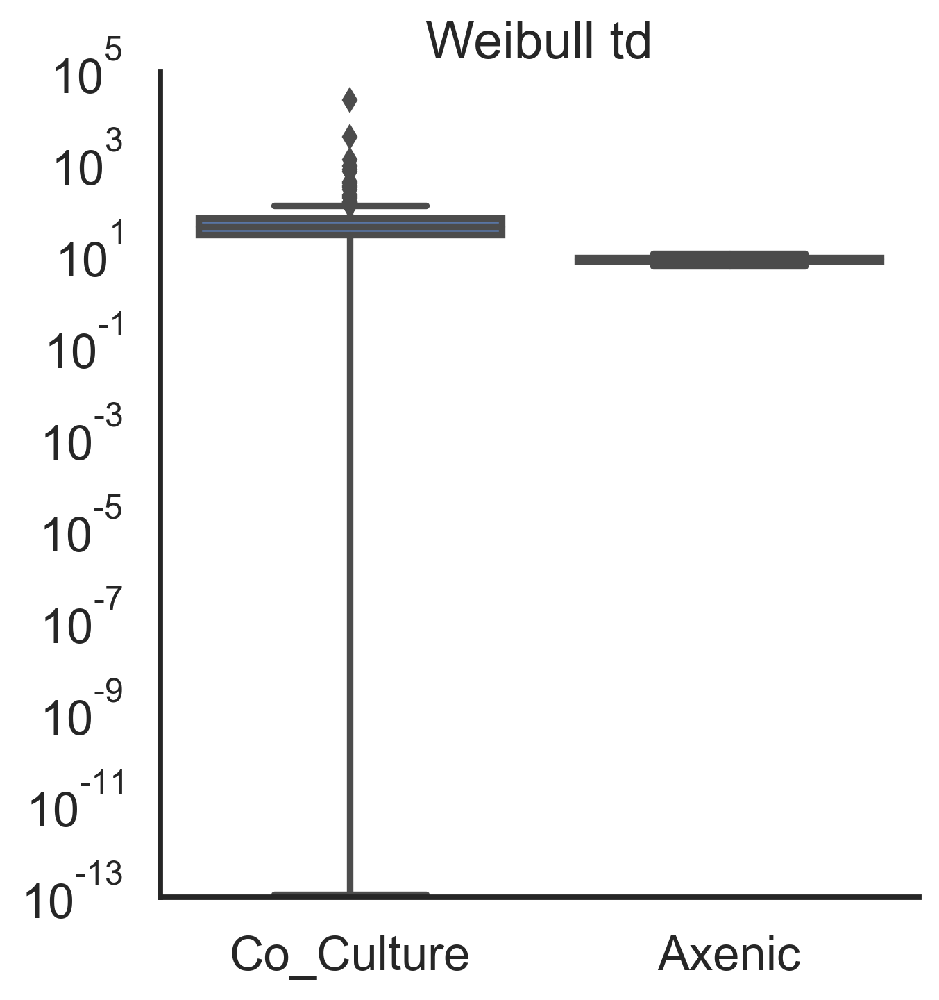

In [162]:
sns.catplot(data = dfscore
            , y='weibull_td', x='culture', #element="step",
             kind="box", #multiple='stack'
       ).set_axis_labels('','') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.axhline(1)
plt.yscale('log')
plt.title('Weibull td')

Text(0.5, 1.1, 'Weibull td (co-cultures)')

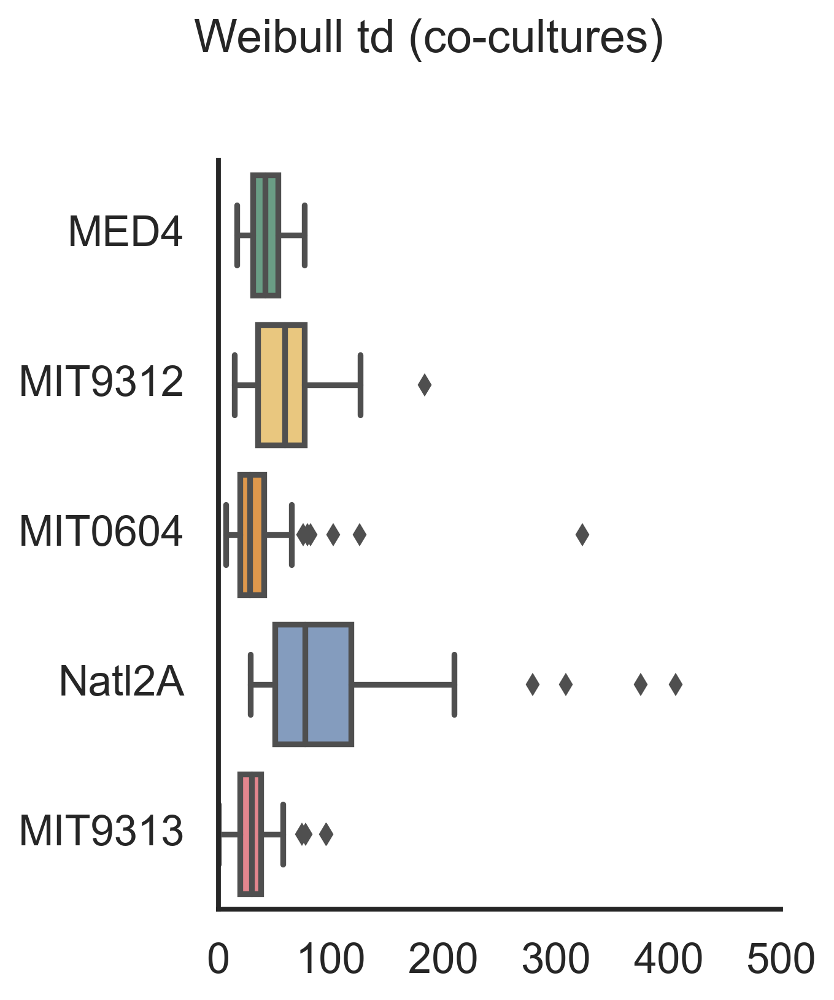

In [165]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture'])  
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td', #col='culture', #element="step",
            y='PRO', order=porder, palette=ppallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xlim=(0,500))# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td (co-cultures)', y=1.1)

Text(0.5, 1.1, 'Weibull td2 (co-cultures)')

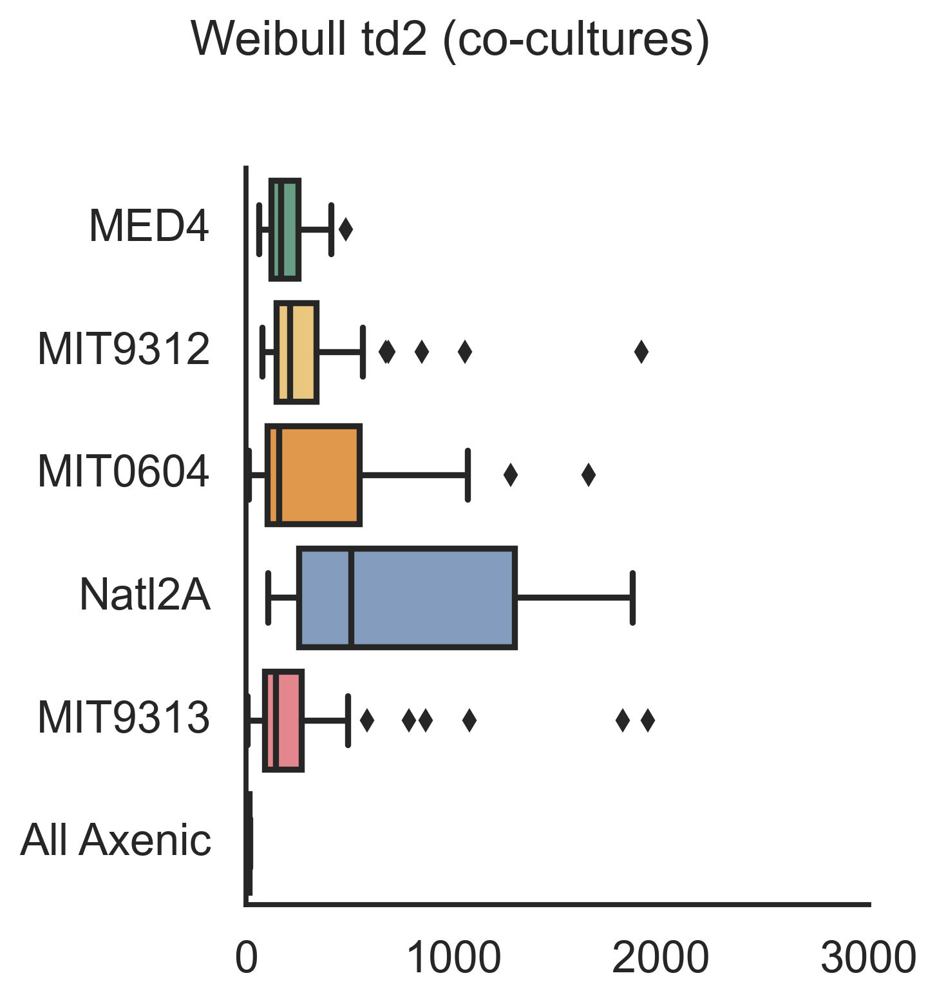

In [198]:
sns.set_context('talk')
dfscore['PRO2'] =dfscore['PRO']
dfscore.loc[dfscore.culture.isin(['Axenic']), 'PRO2'] = 'All Axenic'
sns.catplot(data = dfscore#.loc[dfscore.culture.isin(['Co_Culture'])  
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                           #   ]
            , x='weibull_td2', #col='culture', #element="step",
            y='PRO2', order=porder + ['All Axenic'], palette=ppallete + ['purple'],
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xticks=[0,1000,2000,3000])
#.set(xscale='log',xlim=(0,1e5))# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
plt.xlim((0,3e3))
#plt.xscale('log')
plt.suptitle('Weibull td2 (co-cultures)', y=1.1)

Text(0.5, 1.1, 'Weibull td (co-cultures)')

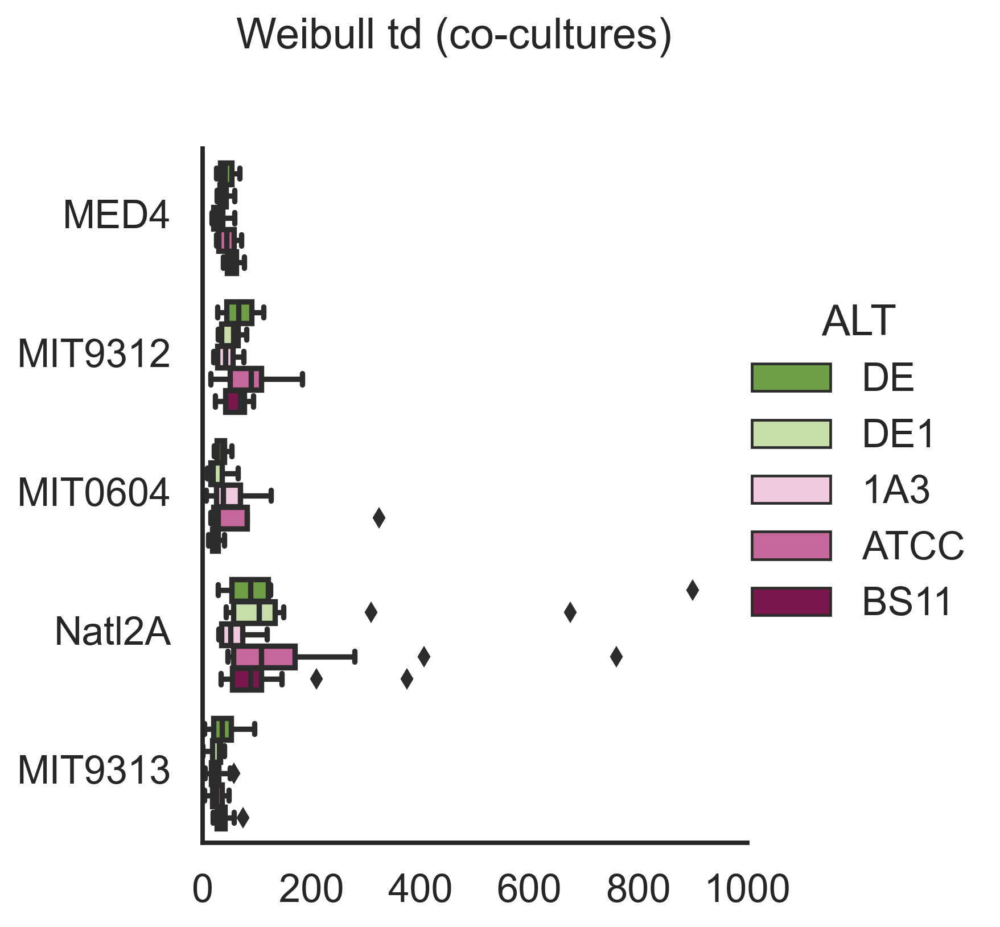

In [180]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture'])  
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td', #col='culture', #element="step",
            y='PRO', order=porder,
            hue='ALT', hue_order=aorder, palette=apallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xlim=(0,1000))# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td (co-cultures)', y=1.1)

Text(0.5, 1.1, 'Weibull td2 (co-cultures)')

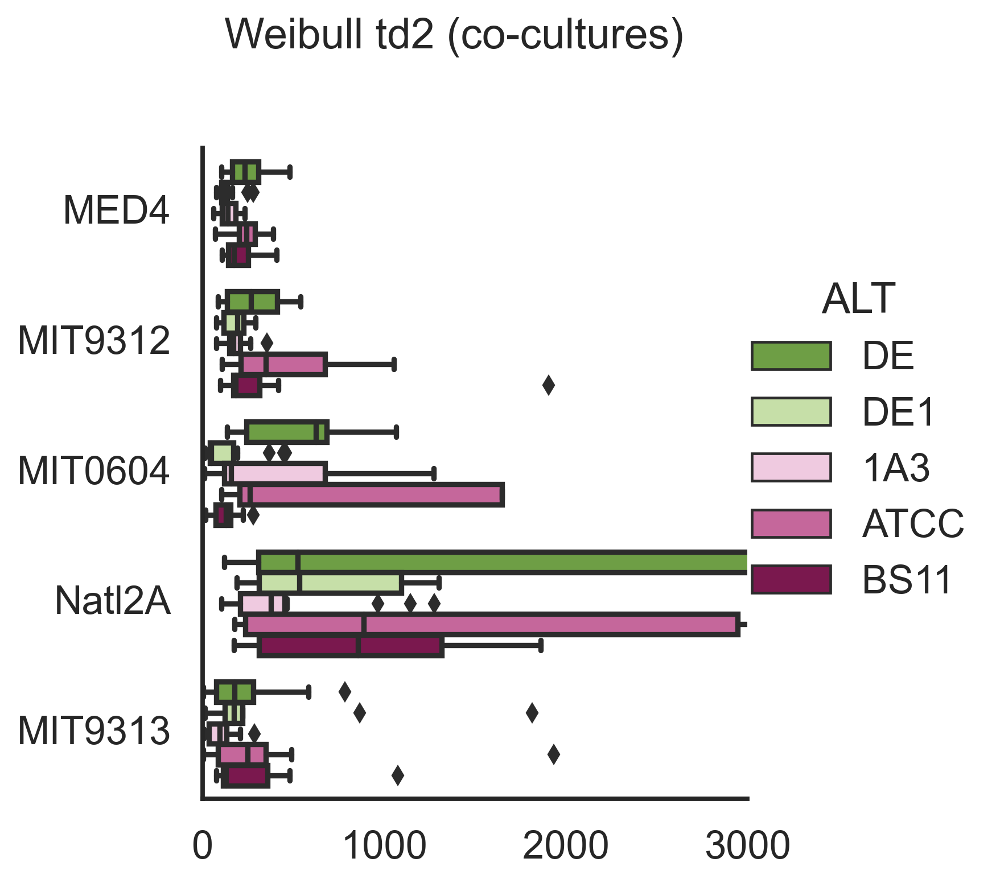

In [210]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture'])  
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td2', #col='culture', #element="step",
            y='PRO', order=porder,
            hue='ALT', hue_order=aorder, palette=apallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xlim=(0,3000), xticks=[0,1000,2000,3000])# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td2 (co-cultures)', y=1.1)

Text(0.5, 1.1, 'Weibull td (Natl2A co-cultures)')

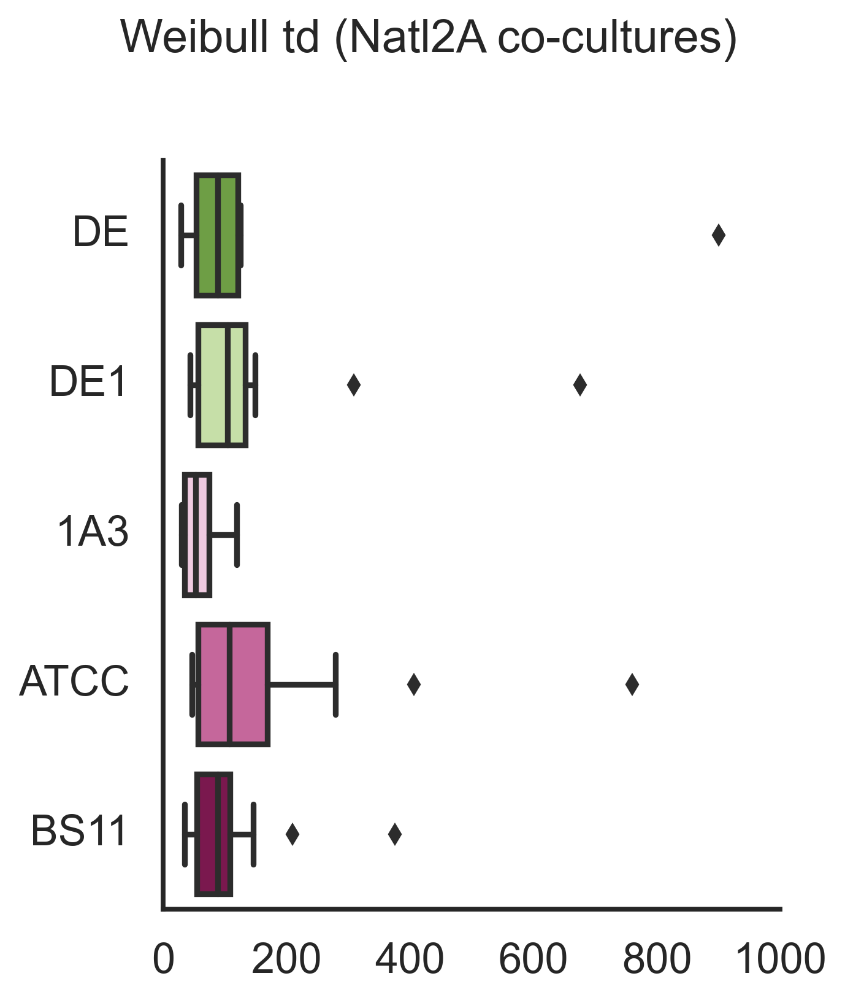

In [181]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture']) & 
                               dfscore.PRO.isin(['Natl2A']) 
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td', #col='culture', #element="step",
            #y='PRO', order=porder,
            y='ALT', order=aorder, palette=apallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xlim=(0,1000))# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td (Natl2A co-cultures)', y=1.1)

Text(0.5, 1.1, 'Weibull td2 (Natl2A co-cultures)')

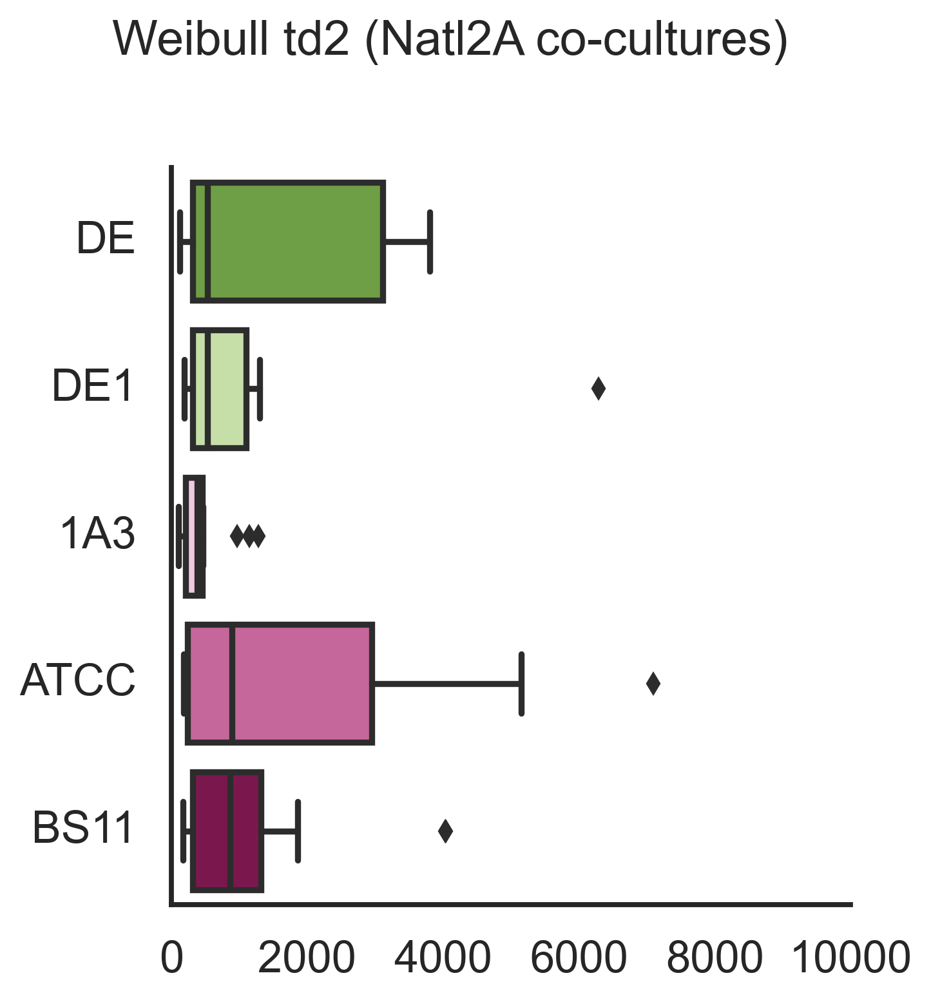

In [209]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture']) & 
                               dfscore.PRO.isin(['Natl2A']) 
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td2', #col='culture', #element="step",
            #y='PRO', order=porder,
            y='ALT', order=aorder, palette=apallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xlim=(0,10000))# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td2 (Natl2A co-cultures)', y=1.1)

,exponential_popt_0,exponential_popt_1,exponential_popt_2,exponential_popt_3,rmse_exponential,bic_exponential,aic_exponential,biexponential_popt_0,biexponential_popt_1,biexponential_popt_2,...,rmse_weibull,bic_weibull,aic_weibull,f,a1,a2,weibull_n,weibull_a,weibull_td6,weibull_td
count,356.000000,356.000000,356.000000,356.000000,356.000000,356.000000,356.000000,353.000000,3.530000e+02,353.000000,...,356.000000,356.000000,356.000000,353.000000,353.000000,353.000000,356.000000,356.000000,3.560000e+02,3.560000e+02
mean,0.132459,0.740169,0.740169,0.740169,0.285225,-168.718303,-170.772603,0.053791,5.000000e-01,3.007715,...,0.178521,-216.433439,-220.542040,0.493396,0.052579,3.008927,0.568416,0.459267,1.199088e+100,1.420989e+02
std,0.098983,0.250158,0.250158,0.250158,0.209286,89.433347,89.513203,0.082460,8.711431e-15,1.738319,...,0.108365,89.070615,89.354863,0.267013,0.076564,1.736522,0.451399,0.315538,2.262435e+101,1.338346e+03
min,0.020703,0.500000,0.500000,0.500000,0.029888,-394.882608,-397.131103,-0.000814,5.000000e-01,0.225162,...,0.014987,-537.725790,-542.074565,0.052008,-0.000814,0.375209,0.006733,0.002474,8.056234e+00,1.128501e-13
25%,0.063553,0.500000,0.500000,0.500000,0.145926,-218.668637,-220.619286,0.016605,5.000000e-01,1.847351,...,0.097794,-260.497918,-264.518098,0.284883,0.016605,1.847351,0.339969,0.249164,8.425963e+02,2.734536e+01
50%,0.104735,0.500000,0.500000,0.500000,0.241412,-160.906561,-162.911260,0.028450,5.000000e-01,2.732173,...,0.156450,-204.351369,-208.361341,0.450550,0.028450,2.732173,0.462176,0.406009,2.068029e+03,4.139831e+01
75%,0.177287,1.000000,1.000000,1.000000,0.365301,-104.224975,-106.104674,0.045164,5.000000e-01,3.729806,...,0.233010,-148.975435,-153.118809,0.691184,0.045164,3.729806,0.601750,0.618155,9.408491e+03,6.474344e+01
max,0.773035,1.000000,1.000000,1.000000,1.310051,48.145187,45.750738,0.652878,5.000000e-01,10.540984,...,0.582104,-66.560456,-69.727494,1.000000,0.588164,10.540984,3.745487,2.814410,4.268753e+102,2.496453e+04


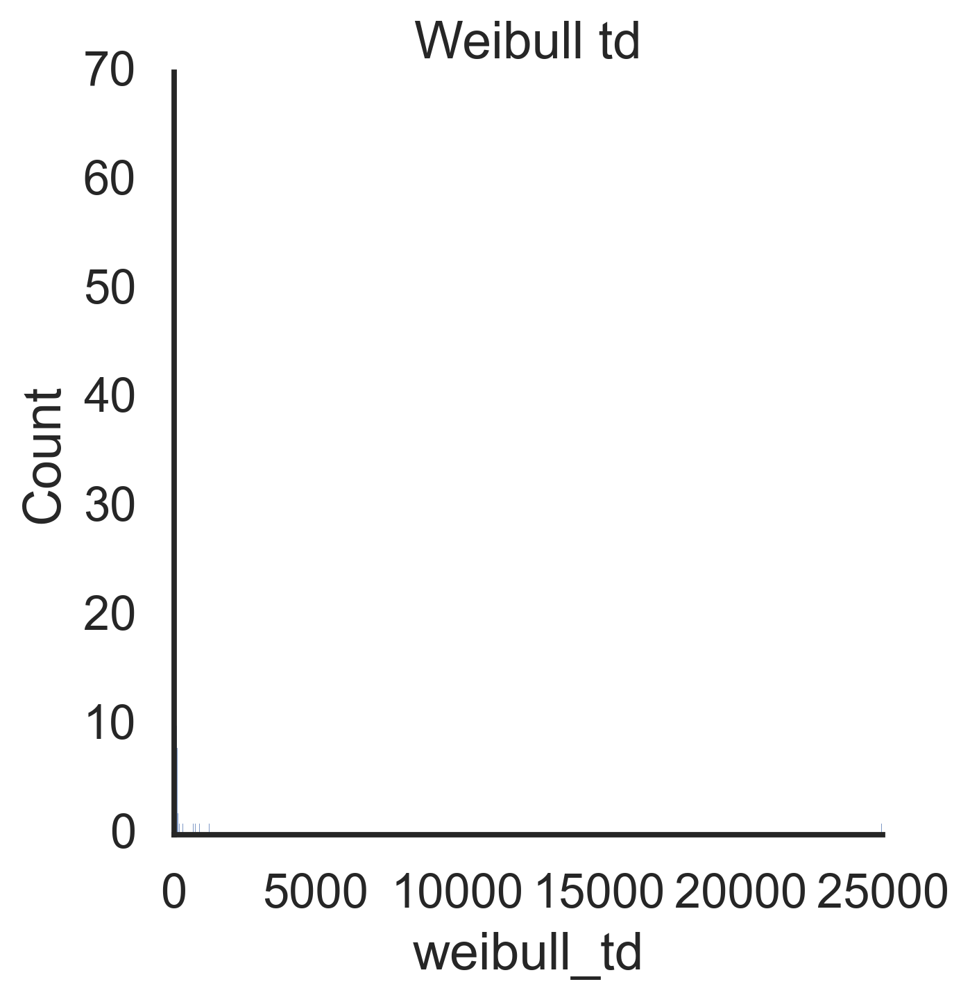

In [136]:
sns.displot(x=dfscore['weibull_td'],# x='culture', #element="step",
             #kind="box", #multiple='stack'
       )
#.set_axis_labels('','td') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.axhline(1)
plt.title('Weibull td')
dfscore.describe()

Text(0.5, 1.0, 'harmonic a')

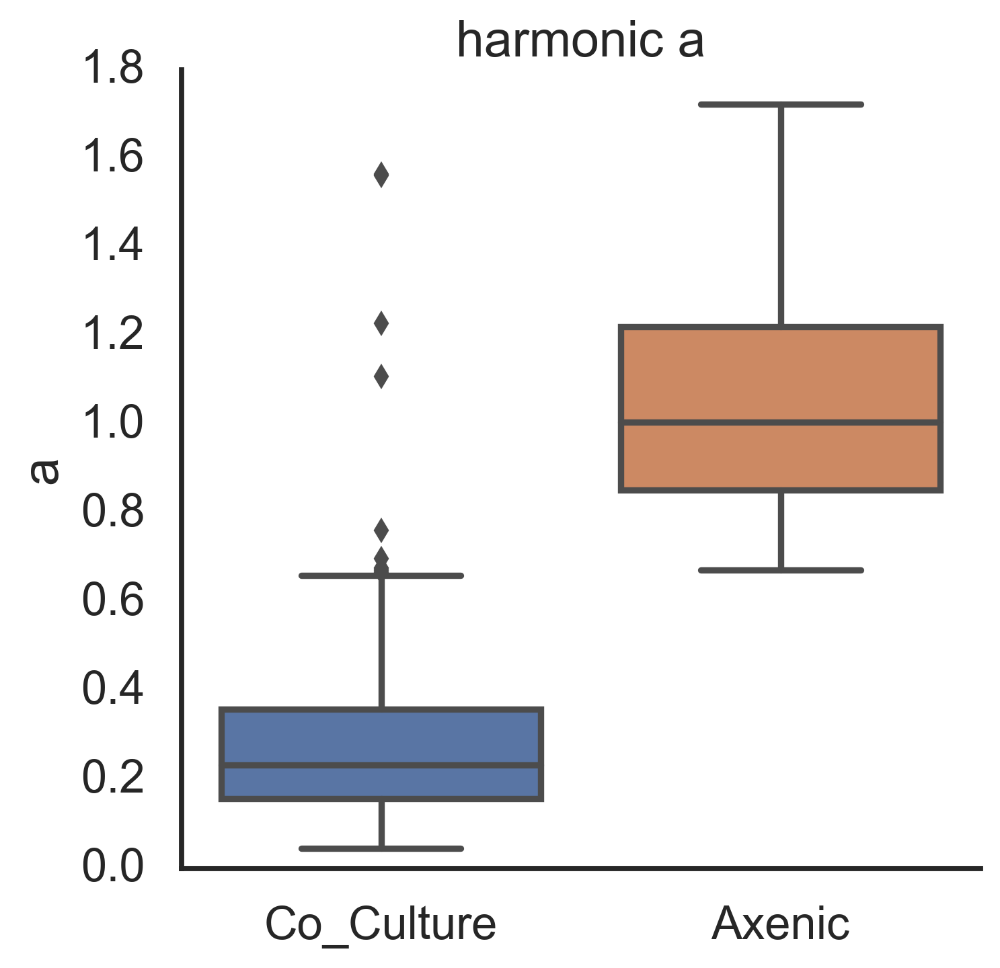

In [110]:
sns.catplot(data = dfscore
            , y='harmonic_popt_0', x='culture', #element="step",
             kind="box", #multiple='stack'
       ).set_axis_labels('','a') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.axhline(1)
plt.title('harmonic a')

Text(0.5, 1.0, 'harmonic a')

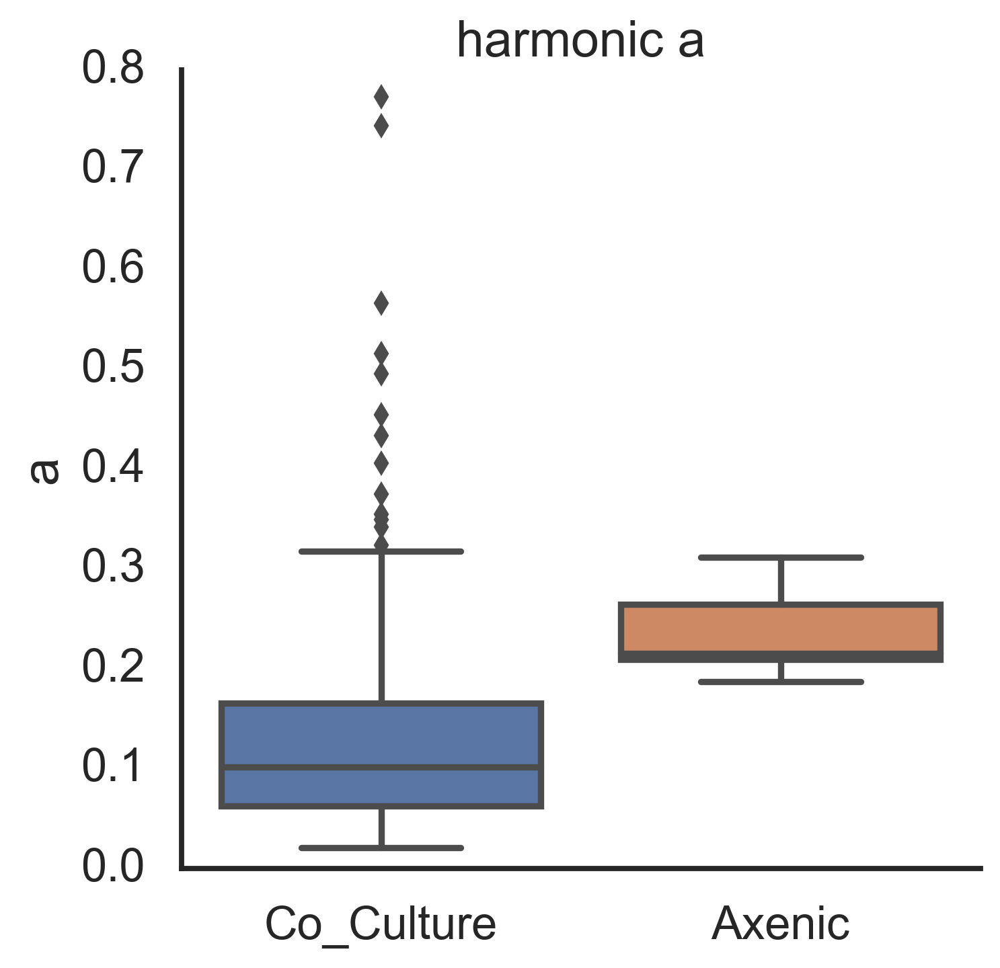

In [111]:
sns.catplot(data = dfscore
            , y='exponential_popt_0', x='culture', #element="step",
             kind="box", #multiple='stack'
       ).set_axis_labels('','a') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.axhline(1)
plt.title('harmonic a')

Text(0.5, 1.0, 'Weibull n distribution (Axenic)')

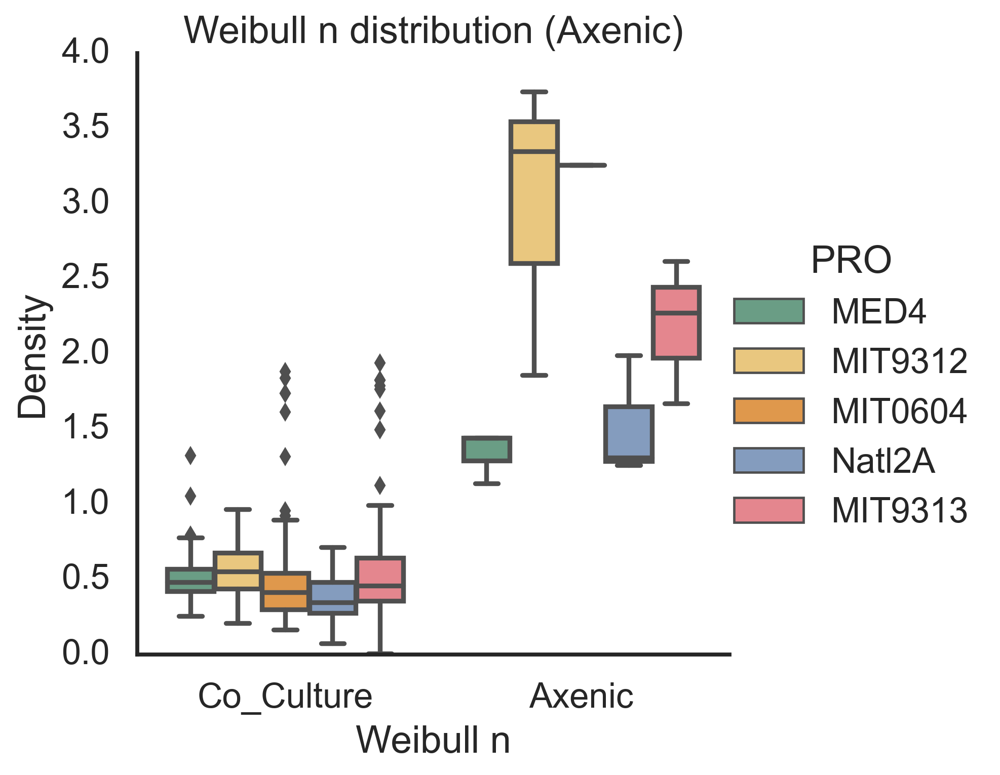

In [112]:
sns.catplot(data = dfscore
            , y='weibull_popt_2', x='culture', #element="step",
             kind="box", #multiple='stack'
            hue='PRO', hue_order=porder, palette=ppallete,
       ).set_axis_labels('Weibull n','Density') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.title('Weibull n distribution (Axenic)')

In [113]:
best_model_df.loc[best_model_df.model.isin(['aic_weibull']) & best_model_df.PRO.isin(['Natl2A']) & 
                   best_model_df.experiment.isin(['e1']) 
                 ].nsmallest(30,'RMSE')

,experiment_sample,experiment,sample,PRO,ALT,culture,model,RMSE,s,e,p
2544,"e1, 27C",e1,27C,Natl2A,Ax_Pro,Axenic,aic_weibull,-301.453894,"27C, Ax_Pro","e1, Axenic",Natl2A_axenic
2542,"e1, 27A",e1,27A,Natl2A,Ax_Pro,Axenic,aic_weibull,-229.781226,"27A, Ax_Pro","e1, Axenic",Natl2A_axenic
2543,"e1, 27B",e1,27B,Natl2A,Ax_Pro,Axenic,aic_weibull,-221.040134,"27B, Ax_Pro","e1, Axenic",Natl2A_axenic
2504,"e1, 14A",e1,14A,Natl2A,DE1,Co_Culture,aic_weibull,-191.296723,"14A, DE1","e1, Co_Culture",Natl2A
2560,"e1, 4A",e1,4A,Natl2A,1A3,Co_Culture,aic_weibull,-174.201750,"4A, 1A3","e1, Co_Culture",Natl2A
2562,"e1, 4C",e1,4C,Natl2A,1A3,Co_Culture,aic_weibull,-158.857557,"4C, 1A3","e1, Co_Culture",Natl2A
2521,"e1, 19C",e1,19C,Natl2A,BS11,Co_Culture,aic_weibull,-153.541693,"19C, BS11","e1, Co_Culture",Natl2A
2506,"e1, 14C",e1,14C,Natl2A,DE1,Co_Culture,aic_weibull,-142.240601,"14C, DE1","e1, Co_Culture",Natl2A
2561,"e1, 4B",e1,4B,Natl2A,1A3,Co_Culture,aic_weibull,-120.776792,"4B, 1A3","e1, Co_Culture",Natl2A


In [114]:
# natl2a
sample_list = ['e1, 14A', 'e1, 27A', #'e1, 4A', 'e1, 4C','e3, 4A', 'e1, 27A','e4, 24B', 'e3, 24B', 'e3, 14B'
              ]
# mit9312
#sample_list = ['e1, 13C', 'e1, 28A', 'e1, 13A', 'e1, 3A']

dfscore.loc[dfscore.experiment_sample.isin(sample_list)]
            #, x='weibull_popt_2', hue='PRO', #element="step",


,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,exponential_popt_3,...,rmse_weibull,bic_weibull,aic_weibull,f,a1,a2,weibull_n,weibull_a,weibull_td6,p
12,"e1, 14A",e1,14A,Natl2A,DE1,Co_Culture,0.030155,0.5,0.5,0.5,...,0.308360,-186.459042,-191.296723,0.369351,0.009089,4.276387,0.230076,0.615633,745004.882216,Natl2A
50,"e1, 27A",e1,27A,Natl2A,Ax_Pro,Axenic,0.250002,0.5,0.5,0.5,...,0.236196,-224.992328,-229.781226,1.000000,0.250272,5.468244,1.311162,0.135190,34.083992,Natl2A_Axenic


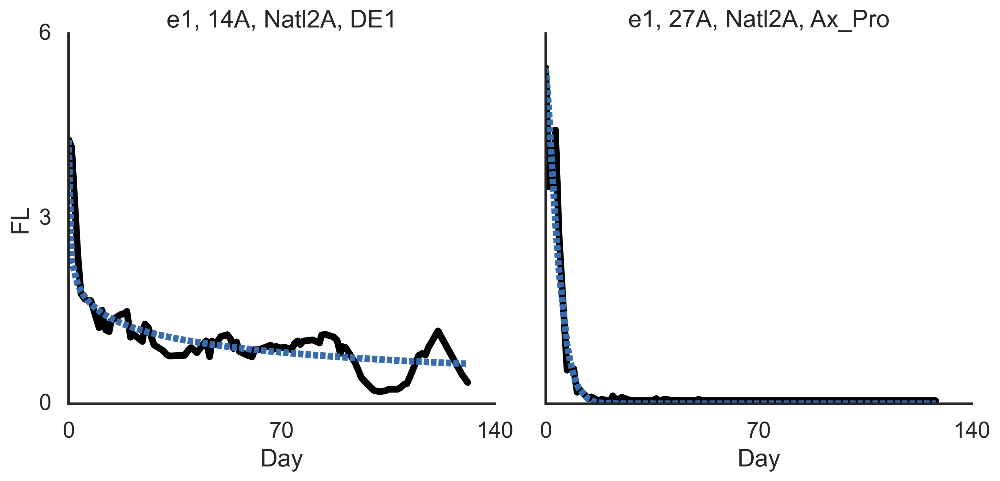

In [115]:
order_list = ['FL', 'weibull',]
#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(sample_list) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='a',
            col_wrap=4,
            #col_order=porder,
        kind='line',
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            palette=['black', mpalette[3]] ,
            legend=False
       ).set_axis_labels('Day','FL').set(yticks=[0,3,6], xticks=[0,70,140]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

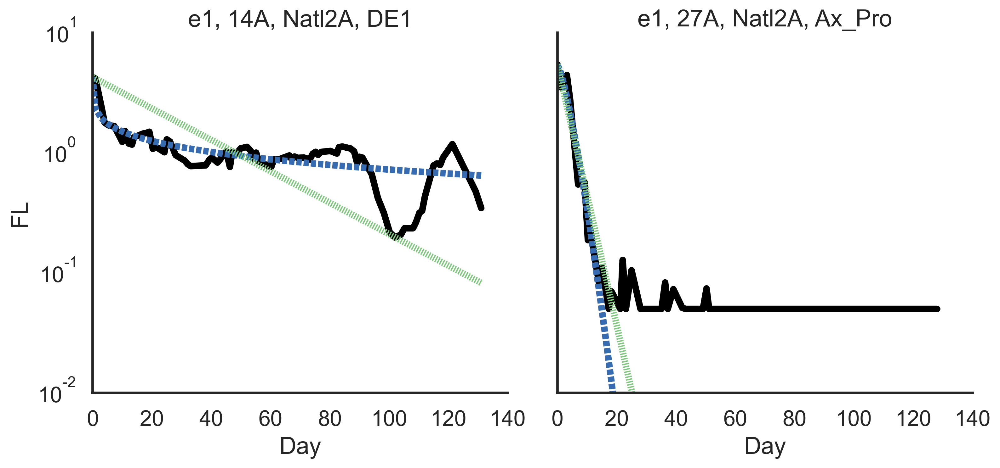

In [116]:
order_list = ['FL', 'weibull', 'exponential', ]

#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(sample_list) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='a',
            col_wrap=4,
            #col_order=porder,
        kind='line',
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            palette=['black', mpalette[3], mpalette[0]] ,
            legend=False
       ).set_axis_labels('Day','FL').set(#yticks=[0,3,6], 
                                        #xticks=[0,70,140], 
    ylim=(1e-2,10),
                                         yscale='log',
                                        ).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [117]:
# weibull derivative:
# an t^(n−1) e^(−at^n)
def compute_weibull_derivative(es, t):
    #print(es)
    a = dfscore.loc[dfscore.experiment_sample.isin([es]), 'weibull_popt_0'].values[0]
    n = dfscore.loc[dfscore.experiment_sample.isin([es]), 'weibull_popt_2'].values[0]
    res = a * n * np.power(t, n-1)* np.exp(-a* np.power(t,n))
    #print(es, a, n, t, res)
    
    return res

In [118]:
dfresm['weibull_distribution'] = dfresm.apply(
    lambda x: compute_weibull_derivative(x['experiment_sample'], x['day']), axis=1)

C:\Users\wosnat\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in power
  import sys


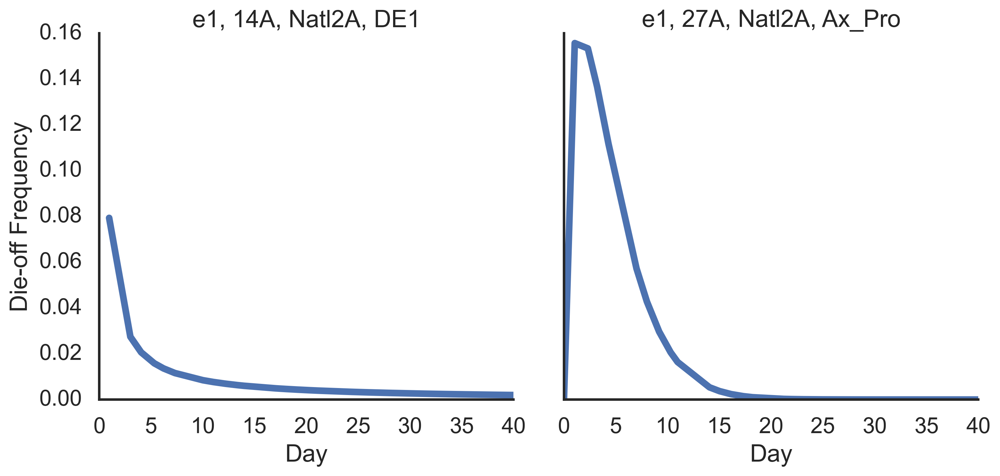

In [119]:
order_list = ['FL', 'exponential', 'weibull',]
#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(sample_list) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='weibull_distribution',
        #hue='weibull_distribution',
        #    style='weibull_distribution',
        col='a',
            col_wrap=4,
            #col_order=porder,
        kind='line',
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            #palette=['black', mpalette[0], mpalette[3]] ,
            legend=False
       ).set_axis_labels('Day','Die-off Frequency').set(xlim=(0,40),#yticks=[0,3,6], 
                                        #xticks=[0,70,140], 
    #ylim=(1e-2,10),
     #                                    yscale='log'
                                        ).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

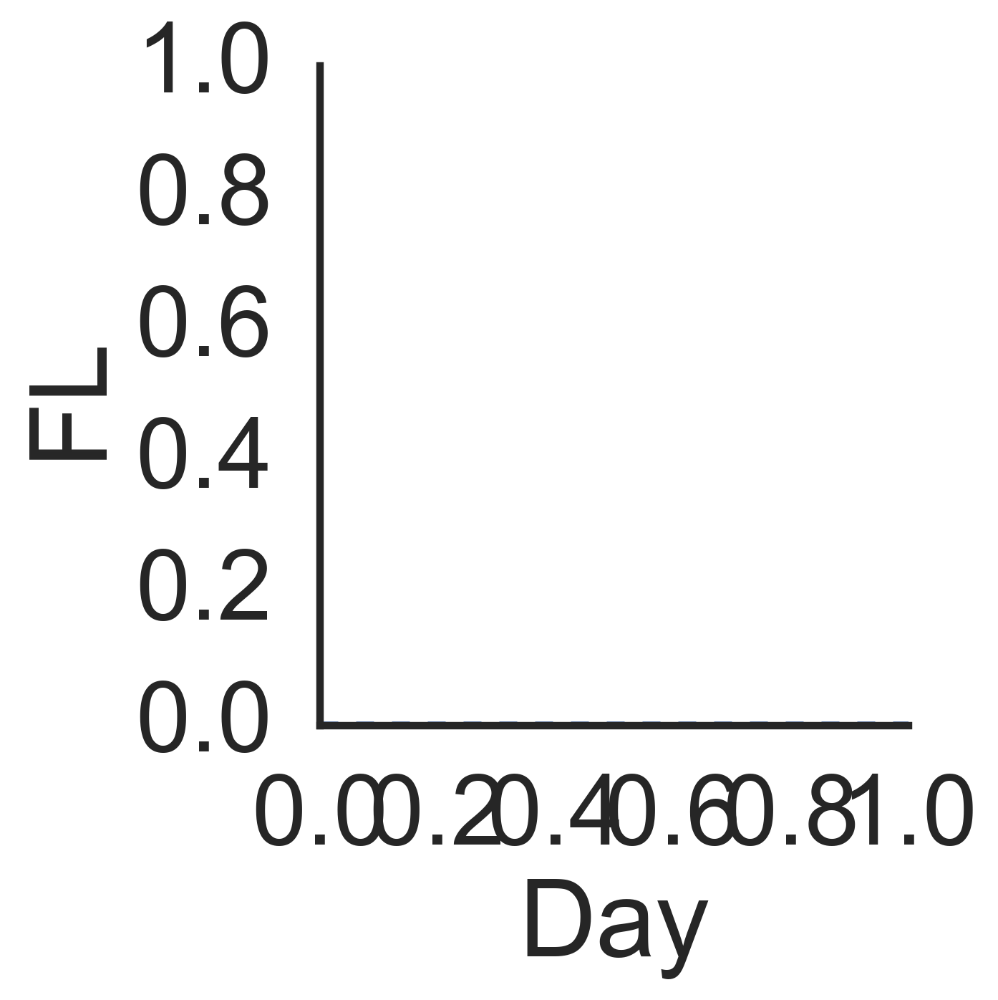

In [120]:
sns.set_context('poster')
sns.set(font_scale=1.5, style='white', context='poster')

g = sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

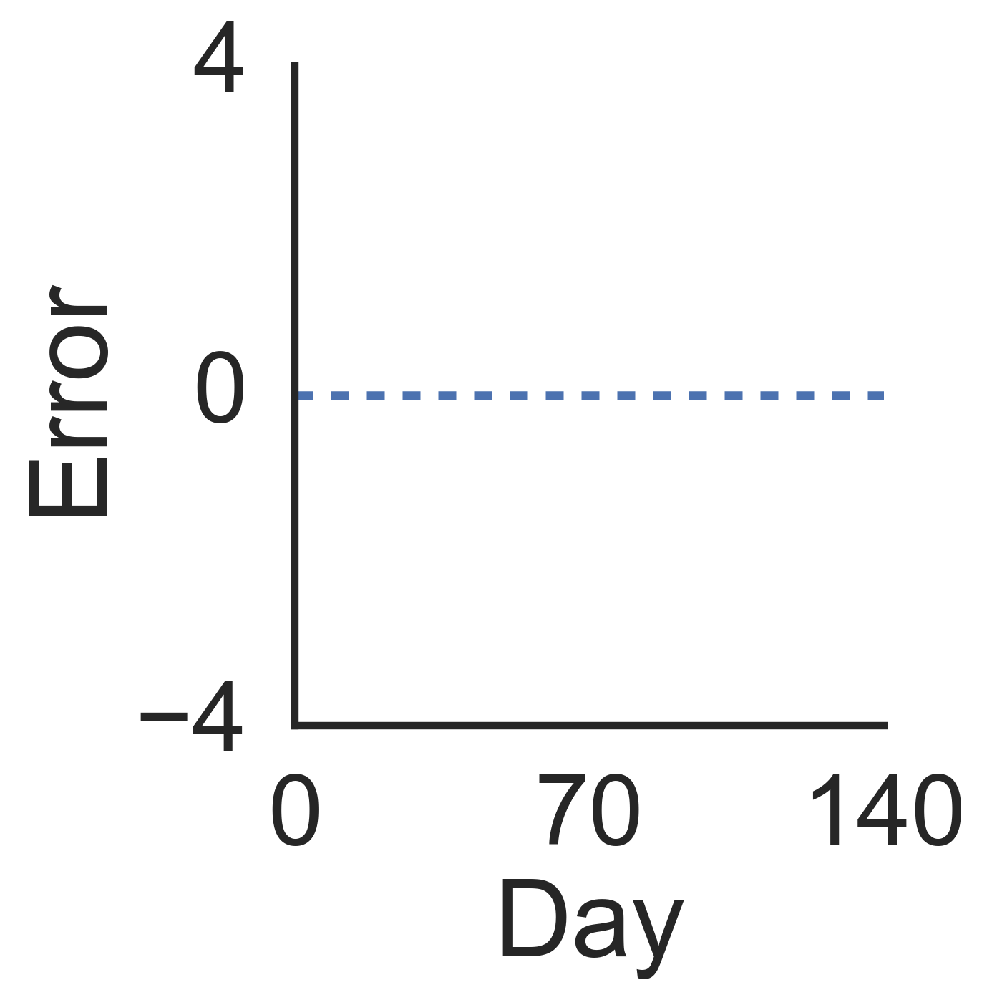

In [121]:
sns.set(font_scale=1.5, style='white', context='poster')

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
g = sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['harmonic_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
        #col_wrap=5,
        kind='line',
                estimator=None, units='experiment_sample',
            #aspect=1.4
            #facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
                legend=False
       ).set_axis_labels('Day','Error').set(xticks=[0,70,140], yticks=[-4,0, 4]).set_titles('')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
#plt.title('harmonic error - e1')
plt.show()

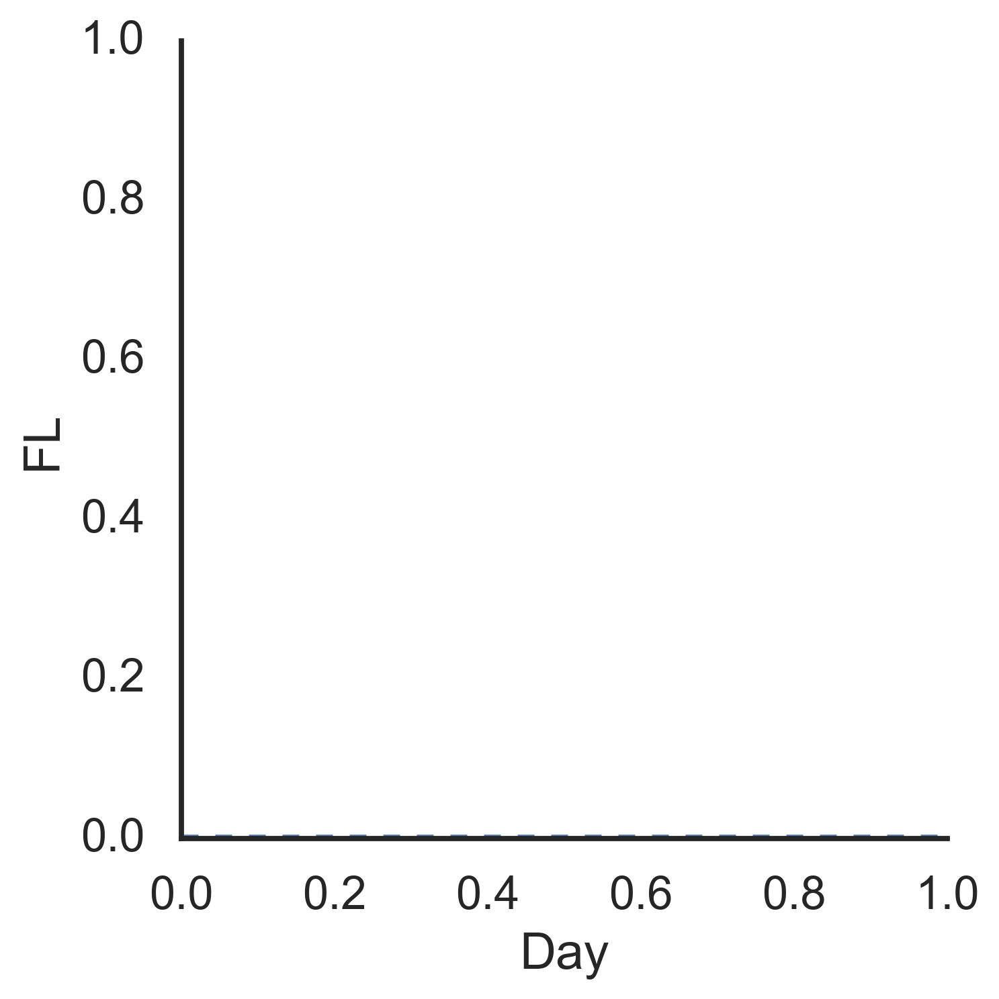

In [122]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
g = sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='ALT',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=aorder,
            #col_wrap=2,
            hue='ALT', hue_order=aorder, palette=apallete,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

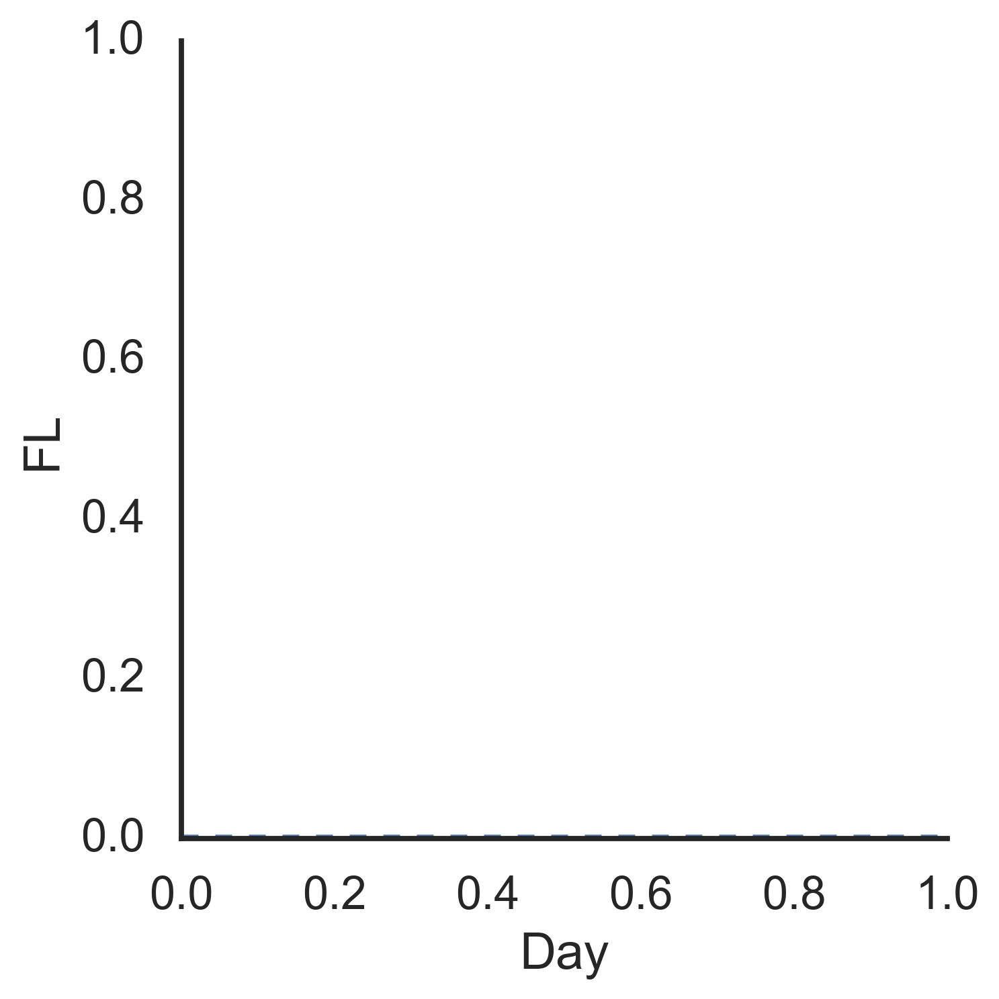

In [123]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
g = sns.relplot(data=dfresm.loc[#(dfresm.experiment == 'e1') & 
                                (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
                row='experiment',
                units='sample', estimator=None,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

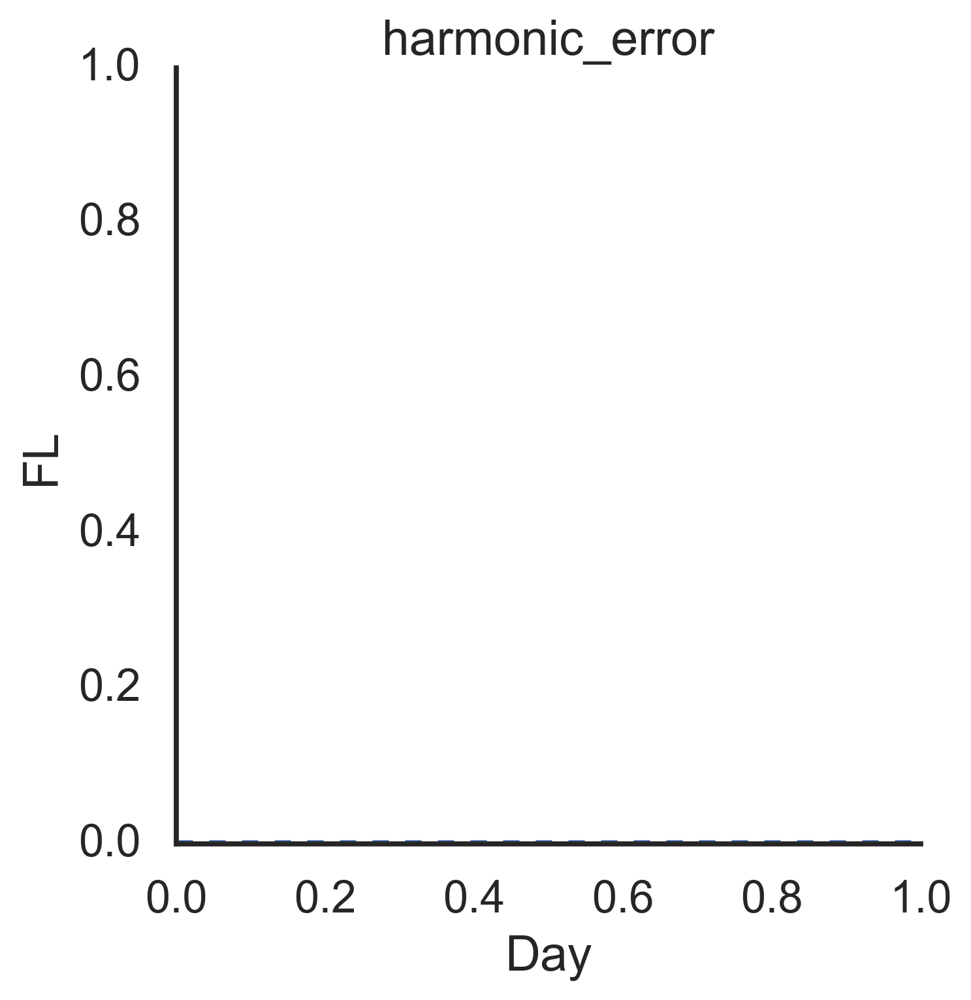

In [124]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
g = sns.relplot(data=dfresm.loc[#(dfresm.experiment == 'e1') & 
                                (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['harmonic_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
                row='experiment',
                units='sample', estimator=None,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
plt.title('harmonic_error')
plt.show()

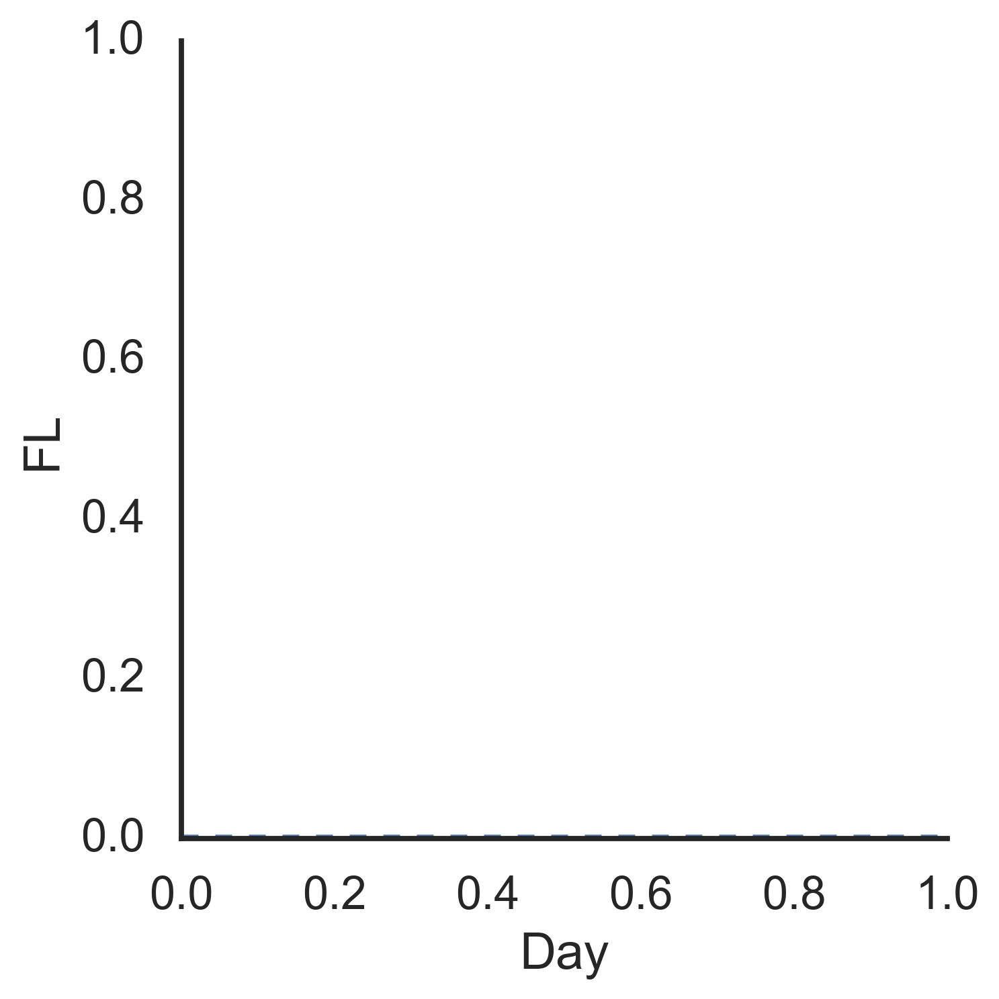

In [125]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
g = sns.relplot(data=dfresm.loc[#(dfresm.experiment == 'e1') & 
                                (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='ALT',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=aorder,
            #col_wrap=2,
            hue='ALT', hue_order=aorder, palette=apallete,
                row='experiment',
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
                units='sample', estimator=None,
                
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

In [126]:
df1 = dfresm.loc[(dfresm.experiment == 'e1') & 
                                #(~dfresm.ALT.isin(['Ax_Pro'])) &
                 (dfresm.culture.isin(['Co_Culture', 'Axenic'])) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                           ]
sample_col = 'experiment_sample'
#dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
X = cp.experiments2X(df1, value_col='value', cumsummode=True)
metadf = cp.get_meta(df1, value_col='value')
#metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)

ValueError: Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required by StandardScaler.

In [ ]:
sns.set_context('talk')
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', #hue='PRO', 
        hue='culture', 
            style='PRO',
            style_order=porder, markers=pmarkers,
            size='PRO', size_order=porder,
                 sizes=psizes, 
            #     s=150,
                 alpha=0.9, height=7, aspect=1.2,
            #palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (17%)')
plt.title('PCA: Experiment 1 co-cultures vs axenic - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])

In [ ]:
df1 = dfresm.loc[#(dfresm.experiment == 'e1') & 
                                #(~dfresm.ALT.isin(['Ax_Pro'])) &
                 (dfresm.culture.isin(['Co_Culture',])) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                           ]
sample_col = 'experiment_sample'
#dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
X = cp.experiments2X(df1, value_col='value', cumsummode=True)
metadf = cp.get_meta(df1, value_col='value')
#metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
sns.set_context('talk')
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='experiment', 
            style='PRO',
            style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=70,
                 alpha=0.9, height=7, aspect=1.2,
            palette=epallete, hue_order=eorder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (16%)')
plt.title('PCA: all experiments co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])

In [ ]:
df1 = dfresm.loc[(~dfresm.experiment.isin(['e1'])) & 
                                #(~dfresm.ALT.isin(['Ax_Pro'])) &
                 (dfresm.culture.isin(['Co_Culture',])) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                           ]
sample_col = 'experiment_sample'
#dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
X = cp.experiments2X(df1, value_col='value', cumsummode=True)
metadf = cp.get_meta(df1, value_col='value')
#metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
sns.set_context('talk')
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='experiment', 
            style='PRO',
            style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=70,
                 alpha=0.9, height=7, aspect=1.2,
            palette=epallete, hue_order=eorder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (14%)')
plt.title('PCA: experiments e3, e4, e5, e6 - co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])
plt.show()
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='PRO', 
            style='experiment',
            #style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=100,
                 alpha=0.9, height=7, aspect=1.2,
            palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (14%)')
plt.title('PCA: experiments e3, e4, e5, e6 - co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])
plt.show()
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='ALT', 
            style='experiment',
            #style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=100,
                 alpha=0.9, height=7, aspect=1.2,
            palette=apallete, hue_order=aorder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (14%)')
plt.title('PCA: experiments e3, e4, e5, e6 - co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])

In [ ]:
for e in eorder:
    df1 = dfresm.loc[(dfresm.experiment == e) & 
                                    #(~dfresm.ALT.isin(['Ax_Pro'])) &
                     (dfresm.culture.isin(['Co_Culture'])) &
                                (dfresm['variable'].isin(['exponential_error'])) 
                               ]
    sample_col = 'experiment_sample'
    #dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
    X = cp.experiments2X(df1, value_col='value', cumsummode=True)
    metadf = cp.get_meta(df1, value_col='value')
    #metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
    dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
    sns.set_context('talk')
    ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='PRO', 
            #style='culture', 
                style='PRO',
                style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder,
                     sizes=psizes, 
                     alpha=0.9, height=7, aspect=1.2,
                palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
                     col='culture',
               )
    plt.xlabel('PCA1')
    plt.ylabel('PCA2')
    plt.title(f'PCA: Experiment {e} co-cultures - decline model error')
    for lh in ax._legend.legendHandles: 
        lh.set_sizes([70])
        plt.show()
    
    ax = sns.relplot(data=dfpca.loc[dfpca.culture.isin(['Co_Culture'])], x='PCA1', y='PCA2', hue='ALT', 
                #style='culture', 
                style='ALT',
                style_order=aorder, #markers=['p','h','<','v','>'],
                     markers=amarkers,
                s=200, #alpha=0.9, 
                     height=7, aspect=1.2,
                palette=apallete, 
                     hue_order=aorder ,edgecolor='lightgrey', 

                     #facet_kws=dict(subplot_kws=dict(fillstyle='none')) #fillstyle='none',
                     #facecolors= 'none'
               )
    plt.xlabel('PCA1')
    plt.ylabel('PCA2')
    plt.title(f'PCA: Experiment {e} co-cultures - decline model error')
    for lh in ax._legend.legendHandles: 
        lh.set_sizes([70])
    plt.show()
    

In [ ]:
for e in eorder:
    df1 = dfresm.loc[(dfresm.experiment == e) & 
                                    #(~dfresm.ALT.isin(['Ax_Pro'])) &
                     (dfresm.culture.isin(['Co_Culture'])) &
                                (dfresm['variable'].isin(['harmonic_error'])) 
                               ]
    sample_col = 'experiment_sample'
    #dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
    X = cp.experiments2X(df1, value_col='value', cumsummode=True)
    metadf = cp.get_meta(df1, value_col='value')
    #metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
    dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
    sns.set_context('talk')
    ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='PRO', 
            #style='culture', 
                style='PRO',
                style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder,
                     sizes=psizes, 
                     alpha=0.9, height=7, aspect=1.2,
                palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
                     col='culture',
               )
    plt.xlabel('PCA1')
    plt.ylabel('PCA2')
    plt.title(f'PCA: Experiment {e} co-cultures - harmonic decline model error')
    for lh in ax._legend.legendHandles: 
        lh.set_sizes([70])
        plt.show()
    
    ax = sns.relplot(data=dfpca.loc[dfpca.culture.isin(['Co_Culture'])], x='PCA1', y='PCA2', hue='ALT', 
                #style='culture', 
                style='ALT',
                style_order=aorder, #markers=['p','h','<','v','>'],
                     markers=amarkers,
                s=200, #alpha=0.9, 
                     height=7, aspect=1.2,
                palette=apallete, 
                     hue_order=aorder ,edgecolor='lightgrey', 

                     #facet_kws=dict(subplot_kws=dict(fillstyle='none')) #fillstyle='none',
                     #facecolors= 'none'
               )
    plt.xlabel('PCA1')
    plt.ylabel('PCA2')
    plt.title(f'PCA: Experiment {e} co-cultures - harmonic decline model error')
    for lh in ax._legend.legendHandles: 
        lh.set_sizes([70])
    plt.show()
    

In [ ]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3', 'Ax_Pro'])) &
                            (dfresm['sample'].str.endswith('C')) &
                            (dfresm['variable'].isin(['FL', 'exponential'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
        row='PRO',
            col='ALT',
            col_order=['1A3','Ax_Pro'],
            row_order=porder ,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=5,
       )
plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [ ]:
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
for p in dfresm.PRO.unique():
    for e in dfresm.experiment.unique():
        sns.relplot(data=dfresm.loc[(dfresm.experiment == e) & (dfresm.PRO == p)], 
                x='day',
                y='value',
                hue='variable',
                col='alt',
                col_wrap=6,
                kind='line',
               )
        plt.suptitle(f'fitting, experiment {e}, {p}', y=1)
        plt.show()

In [ ]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
#    for e in dfresm.experiment.unique():
exponential_samples = best_model_df.loc[best_model_df.model == 'exponential', 'experiment_sample']
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples) & 
                           (dfresm.experiment == 'e1')
                           ], 
                x='day',
                y='value',
                hue='variable',
                col='a',
                col_wrap=4,
                kind='line',
               )
plt.suptitle(f'exponential fit', y=1)
plt.show()

In [ ]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
exponential_samples = best_model_df.loc[(best_model_df.model == 'harmonic') & (best_model_df.experiment == 'e1'),
                                        'experiment_sample']
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples[:16]) & 
                           (dfresm.experiment == 'e1')
                           ], 
                x='day',
                y='value',
                hue='variable',
                col='a',
                col_wrap=4,
                kind='line',
               )
plt.suptitle(f'harmonic fit e1', y=1)
plt.show()

In [ ]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
exponential_samples = best_model_df.loc[(best_model_df.model == 'harmonic') & (best_model_df.experiment == 'e1'),
                                        'experiment_sample']
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples[-16:]) & 
                           (dfresm.experiment == 'e1')
                           ], 
                x='day',
                y='value',
                hue='variable',
                col='a',
                col_wrap=4,
                kind='line',
               )
plt.suptitle(f'harmonic fit e1', y=1)
plt.show()

In [ ]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
exponential_samples = best_model_df.loc[best_model_df.model == 'harmonic', 'experiment_sample']
for e in dfresm.experiment.unique():
    sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples) & 
                               (dfresm.experiment == e)
                               ], 
                    x='day',
                    y='value',
                    hue='variable',
                    col='a',
                    col_wrap=8,
                    kind='line',
                   )
    plt.suptitle(f'harmonic fit {e}', y=1)
    plt.show()

In [ ]:
exponential_samples

In [ ]:
dfresm.columns